In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import pandas as pd
import random
import json
from typing import List, Tuple, Set, Generator, Any, Iterable, Dict, Union, Optional
import re
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import math
from collections import Counter, defaultdict

from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, f1_score, mean_squared_error, r2_score, silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsRegressor
from sklearn.decomposition import PCA, IncrementalPCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.cluster import KMeans
from sklearn.utils.class_weight import compute_class_weight, compute_sample_weight

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
from transformers import AutoModel, AutoTokenizer

import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

# Constants

In [ ]:
TRAIN_DATASET = "/content/drive/MyDrive/ML_prj/dataset/vi_train.txt"
TEST_DATASET = "/content/drive/MyDrive/ML_prj/dataset/vi_test.txt"

PREPROC_TRAIN_DATASET = "/content/drive/MyDrive/ML_prj/preprocessing/vi_train_preproc.jsonl"
PREPROC_TEST_DATASET = "/content/drive/MyDrive/ML_prj/preprocessing/vi_test_preproc.jsonl"

VALID_TAGS = [
    'A', 'B', 'C', 'E', 'I', 'L', 'M', 'N', 'Nb', 'Nc', 'Np', 'Nu',
    'P', 'PUNCT', 'R', 'S', 'T', 'V', 'X', 'Y'
]

PUNCT = {
    "``", "''", '""', ".", "...", "…", "“", "”", "!", '"', "#", "$", "%", "&",
    "'", "(", ")", "*", "+", ",", "-", "/", ":", ";", "<", "=", ">", "?",
    "@", "[", "\\", "]", "_", "`", "{", "|", "}", "~", "’", ".)"
}

UNKNOWN_WORDS = {
    'p', 'v', 'm', 'a', 'Ny', 'Ap', 'Vy', 'Vb', 'Ab', 'NC', 'Eb', 'H'
}

PHOBERT_MODEL_NAME = "vinai/phobert-base"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

TEST_RATIO = 0.2
TRAIN_RATIO = 1.0 - TEST_RATIO

PYTORCH_BATCH_SIZE = 32
LEARNING_RATE = 1e-5
EPOCHS = 30
SKLEARN_BATCH_SIZE = 10000

N_SAMPLES_CLUSTER_VIZ = 217503
N_COMPONENTS_PCA_ANALYSIS = 6
N_COMPONENTS_PCA_MODEL = 256

print(f"🟢 Using device: {DEVICE}")

🟢 Using device: cuda


# Preprocess

In [ ]:
def fix_sentence(
    sentence: str
) -> List[str]:
    """
    Processes a raw sentence string to fix token bugs and split complex tokens.

    Args:
        sentence (str): The input sentence as a single string.

    Return:
        List[str]: A list of cleaned tokens (e.g., "word/tag").
    """
    sentence = re.sub(r'/+', '/', sentence)
    sentence = re.sub(r'(-/-)(\d+/\w+)', r'\1 \2', sentence)
    sentence = re.sub(r'(\d+/\w+)(-/-)', r'\1 \2', sentence)
    sentence = re.sub(r'\s+', ' ', sentence).strip()

    tokens = sentence.split()
    clean_tokens = []

    for tok in tokens:
        matches = re.findall(r'([^\s/]+)/([^\s/]+)', tok)
        if matches:
            for w, t in matches:
                clean_tokens.append(f"{w}/{t}")
        # else:
        #     print(f"[WARNING] Token too complex, removed: {tok}")

    return clean_tokens

def split_slash(
    tok: str
) -> Tuple[str, str]:
    """
    Splits a "word/tag" token into a (word, tag) tuple and normalizes the tag.

    Args:
        tok (str): A single token (e.g., "học_sinh/N").

    Return:
        Tuple[str, str]: A (word, tag) tuple, e.g., ("học sinh", "N").
                         Invalid tags are converted to "X".
    """
    if '/' in tok:
        word, tag = tok.rsplit('/', 1)
    else:
        word, tag = tok, "X"  # Unknown tag

    word = word.lower().replace("_", " ")
    if word in PUNCT or tag in PUNCT:
        tag = "PUNCT"
    elif tag not in VALID_TAGS or tag in UNKNOWN_WORDS:
        tag = "X"

    return word, tag

def split_string(
    tokens: List[str]
) -> Tuple[List[str], List[str]]:
    """
    Converts a list of "word/tag" tokens into two separate lists
    for words and tags.

    Args:
        tokens (List[str]): A list of processed "word/tag" strings.

    Return:
        Tuple[List[str], List[str]]: A tuple containing (list_of_words, list_of_tags).
    """
    words = []
    tags = []
    for tok in tokens:
        word, tag = split_slash(tok)
        words.append(word)
        tags.append(tag)
    return words, tags

def preprocess_data(
    filename: str
) -> Tuple[List[Tuple[List[str], List[str]]], Dict[str, int]]:
    """
    Reads a raw text file, preprocesses each line, and returns a list
    of (words, tags) tuples.

    Args:
        filename (str): Path to the raw text file (e.g., vi_train.txt).

    Return:
        Tuple[List[Tuple[List[str], List[str]]], Dict[str, int]]:
            1. (List): A list where each item is (words_list, tags_list)
                       for a sentence.
            2. (Dict): A dictionary containing preprocessing statistics.
    """
    words_tags_list = []
    stats = {
        'lines_total': 0,
        'lines_remaining': 0,
        'tokens_total': 0,
        'tokens_remaining': 0
    }

    with open(filename, 'r', encoding="utf-8") as f:
        for lineno, line in enumerate(f, start=1):
            line = line.strip()
            if not line:
                continue

            stats['lines_total'] += 1
            tokens = line.split()
            stats['tokens_total'] += len(tokens)

            clean_tokens = fix_sentence(line)
            if not clean_tokens:
                # print(f"[INFO] Line {lineno} skipped: no valid tokens remain.")
                continue

            stats['lines_remaining'] += 1
            stats['tokens_remaining'] += len(clean_tokens)

            words_tags = split_string(clean_tokens)
            words_tags_list.append(words_tags)

    return words_tags_list, stats

def save_preprocessed_dataset(
    output_filename: str,
    words_tags: List[Tuple[List[str], List[str]]]
) -> None:
    """
    Saves the preprocessed data (list of words/tags) to a JSONL file.

    Args:
        output_filename (str): Path to the output JSONL file.
        words_tags (List[Tuple[List[str], List[str]]]): The preprocessed data
                                                     from `preprocess_data`.

    Return:
        None: This function writes to a file and returns nothing.
    """
    with open(output_filename, "w", encoding="utf-8") as f:
        for words, tags in words_tags:
            json_line = json.dumps({"tokens": words, "tags": tags}, ensure_ascii=False)
            f.write(json_line + "\n")

def run_preprocessing() -> None:
    """
    Main orchestrator function to run the entire preprocessing pipeline
    (read, process, save).

    Args:
        None

    Return:
        None: This function prints logs and saves files.
    """
    print("Preprocessing")
    # Preprocess train dataset
    train_wt_list, train_stats = preprocess_data(TRAIN_DATASET)
    save_preprocessed_dataset(PREPROC_TRAIN_DATASET, train_wt_list)
    print("[PREPROCESS TRAIN]")
    print(f"  Total lines: {train_stats['lines_total']} -> Remaining: {train_stats['lines_remaining']}")
    print(f"  Total tokens: {train_stats['tokens_total']} -> Remaining: {train_stats['tokens_remaining']}")

    # Preprocess test dataset
    test_wt_list, test_stats = preprocess_data(TEST_DATASET)
    save_preprocessed_dataset(PREPROC_TEST_DATASET, test_wt_list)
    print("[PREPROCESS TEST]")
    print(f"  Total lines: {test_stats['lines_total']} -> Remaining: {test_stats['lines_remaining']}")
    print(f"  Total tokens: {test_stats['tokens_total']} -> Remaining: {test_stats['tokens_remaining']}")

# Run the preprocessing step
run_preprocessing()

Preprocessing
[PREPROCESS TRAIN]
  Total lines: 8460 -> Remaining: 8460
  Total tokens: 194526 -> Remaining: 194283
[PREPROCESS TEST]
  Total lines: 1051 -> Remaining: 1051
  Total tokens: 23307 -> Remaining: 23274


# Raw Data Analysis

Data Analysis

POS Tag Counts
N: 51557 - 23.70%
V: 42597 - 19.58%
PUNCT: 32115 - 14.76%
R: 15822 - 7.27%
E: 13541 - 6.22%
A: 13427 - 6.17%
P: 9265 - 4.26%
Np: 8518 - 3.92%
M: 8085 - 3.72%
C: 7892 - 3.63%
Nc: 5448 - 2.50%
L: 3934 - 1.81%
X: 2187 - 1.01%
T: 1407 - 0.65%
Nu: 1032 - 0.47%
Nb: 402 - 0.18%
S: 161 - 0.07%
I: 91 - 0.04%
Y: 53 - 0.02%
B: 23 - 0.01%

Sentence Length Stats
mean: 22.874250867416677
min: 6.0
max: 129.0


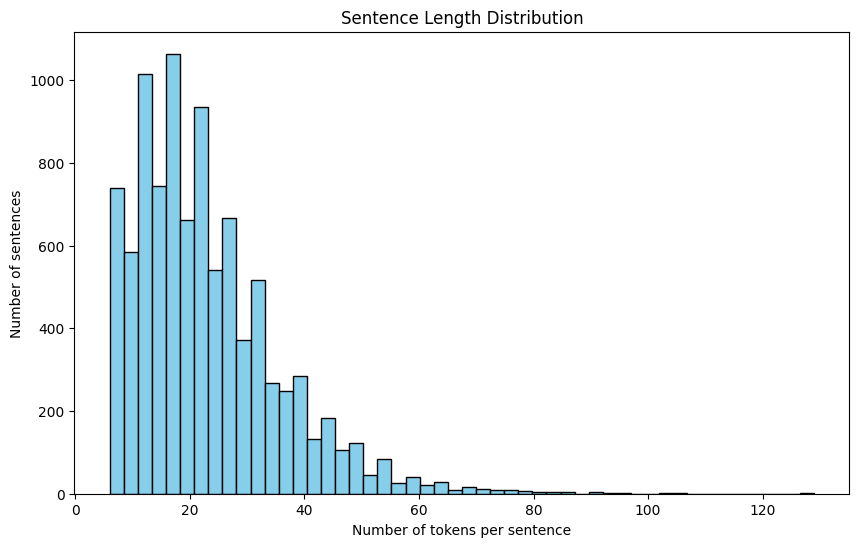

In [ ]:
def read_dataset(
    filepaths: List[str]
) -> Tuple[List[str], List[str], List[int]]:
    """
    Reads one or more preprocessed JSONL files and aggregates all tokens,
    tags, and sentence lengths.

    Args:
        filepaths (List[str]): A list of paths to JSONL files.

    Return:
        Tuple[List[str], List[str], List[int]]:
            1. all_tokens (List[str]): A flat list of all tokens.
            2. all_tags (List[str]): A flat list of all corresponding tags.
            3. sentence_lengths (List[int]): A list of lengths for each sentence.
    """
    all_tokens, all_tags, sentence_lengths = [], [], []

    for filepath in filepaths:
        with open(filepath, 'r', encoding='utf-8') as f:
            for line in f:
                line = line.strip()
                if not line:
                    continue
                data = json.loads(line)
                tokens = data.get("tokens", [])
                tags = data.get("tags", [])

                all_tokens.extend(tokens)
                all_tags.extend(tags)
                sentence_lengths.append(len(tokens))

    return all_tokens, all_tags, sentence_lengths

def analyze_pos_tags(
    tags: List[str]
) -> Tuple[Dict[str, int], Dict[str, float]]:
    """
    Calculates the frequency and percentage of each unique POS tag.

    Args:
        tags (List[str]): A flat list of all tags.

    Return:
        Tuple[Dict[str, int], Dict[str, float]]:
            1. tag_counts (Dict[str, int]): A dictionary mapping {tag -> count}.
            2. tag_ratios (Dict[str, float]): A dictionary mapping {tag -> ratio}.
    """
    total_tags = len(tags)
    tag_counts = Counter(tags)
    tag_ratios = {tag: count / total_tags for tag, count in tag_counts.items()}
    return tag_counts, tag_ratios

def analyze_sentence_lengths(
    lengths: List[int]
) -> Dict[str, float]:
    """
    Calculates basic statistics (mean, min, max) for sentence lengths.

    Args:
        lengths (List[int]): A list of sentence lengths.

    Return:
        Dict[str, float]: A dictionary with keys "mean", "min", "max".
    """
    lengths_array = np.array(lengths)
    return {
        "mean": float(np.mean(lengths_array)),
        "min": float(np.min(lengths_array)),
        "max": float(np.max(lengths_array))
    }

def plot_sentence_length_distribution(
    lengths: List[int],
    bins: int = 50
) -> None:
    """
    Plots a histogram of the sentence length distribution using matplotlib.

    Args:
        lengths (List[int]): A list of sentence lengths.
        bins (int): The number of bins to use in the histogram.

    Return:
        None: This function displays a plot.
    """
    plt.figure(figsize=(10, 6))
    plt.hist(lengths, bins=bins, color='skyblue', edgecolor='black')
    plt.xlabel("Number of tokens per sentence")
    plt.ylabel("Number of sentences")
    plt.title("Sentence Length Distribution")
    plt.show()

def summarize_dataset(
    filepaths: List[str]
) -> None:
    """
    Orchestrator function to run all analysis steps and print a summary.

    Args:
        filepaths (List[str]): A list of JSONL files to analyze.

    Return:
        None: This function prints to the console and shows a plot.
    """
    print("Data Analysis")
    tokens, tags, lengths = read_dataset(filepaths)

    tag_counts, tag_ratios = analyze_pos_tags(tags)
    print("\nPOS Tag Counts")
    for tag, count in tag_counts.most_common():
        print(f"{tag}: {count} - {tag_ratios[tag]*100:.2f}%")

    length_stats = analyze_sentence_lengths(lengths)
    print("\nSentence Length Stats")
    for k, v in length_stats.items():
        print(f"{k}: {v}")

    plot_sentence_length_distribution(lengths)

# Run the analysis step
analysis_files = [PREPROC_TRAIN_DATASET, PREPROC_TEST_DATASET]
summarize_dataset(analysis_files)

# Prepare training data

In [ ]:
def load_bert_model(
    model_name: str = PHOBERT_MODEL_NAME
) -> Tuple[AutoModel, AutoTokenizer]:
    """
    Loads a Transformer model and its corresponding tokenizer from HuggingFace.

    Args:
        model_name (str): The name of the model on the HuggingFace Hub
                          (e.g., "vinai/phobert-base").

    Return:
        Tuple[AutoModel, AutoTokenizer]: A (model, tokenizer) tuple.
    """
    print(f"Loading PhoBERT model: {model_name}...")
    model = AutoModel.from_pretrained(model_name)
    tokenizer = AutoTokenizer.from_pretrained(model_name)
    model.to(DEVICE)
    model.eval()
    print(f"Model loaded and moved to {DEVICE}.")
    return model, tokenizer

def read_sentences_from_jsonl(
    filepaths: List[str]
) -> Generator[Tuple[List[str], List[str]], None, None]:
    """
    Streams sentences (tokens and tags) from JSONL files one by one
    using a generator.

    Args:
        filepaths (List[str]): A list of JSONL files to read.

    Return:
        Generator[Tuple[List[str], List[str]], None, None]: A generator
            that yields (tokens, tags) tuples.
    """
    for filepath in filepaths:
        with open(filepath, 'r', encoding='utf-8') as f:
            for line in f:
                line = line.strip()
                if not line:
                    continue
                data = json.loads(line)
                if data.get("tokens") and data.get("tags"):
                    yield data["tokens"], data["tags"]

def extract_bert_features(
    filepaths: List[str],
    model: AutoModel,
    tokenizer: AutoTokenizer,
    batch_size: int = PYTORCH_BATCH_SIZE
) -> Tuple[np.ndarray, List[str]]:
    """
    Extracts token-level features from PhoBERT for a dataset.
    Handles batching, model inference, and subword-to-word alignment.

    Args:
        filepaths (List[str]): List of JSONL files to process.
        model (AutoModel): The loaded PhoBERT model.
        tokenizer (AutoTokenizer): The loaded PhoBERT tokenizer.
        batch_size (int): The batch size for model inference.

    Return:
        Tuple[np.ndarray, List[str]]:
            1. X_features (np.ndarray): A (N_tokens, 768) NumPy array
                                        of features.
            2. all_token_tags (List[str]): A flat list (N_tokens)
                                            of corresponding tags.
    """
    all_token_embeddings = []
    all_token_tags = []
    truncated_tokens = 0

    sentence_generator = read_sentences_from_jsonl(filepaths)
    pbar = tqdm(desc="Extracting PhoBERT features", unit=" sentences")

    while True:
        batch_tokens_original = []
        batch_tags_original = []
        try:
            for _ in range(batch_size):
                tokens, tags = next(sentence_generator)
                batch_tokens_original.append(tokens)
                batch_tags_original.append(tags)
                pbar.update(1)
        except StopIteration:
            pass

        if not batch_tokens_original:
            pbar.close()
            break

        batch_strings = [" ".join(tokens) for tokens in batch_tokens_original]

        inputs = tokenizer(
            batch_strings,
            return_tensors="pt",
            padding=True,
            truncation=True,
            max_length=128
        )

        inputs_on_device = {k: v.to(DEVICE) for k, v in inputs.items()}

        with torch.no_grad():
            outputs = model(**inputs_on_device)

        last_hidden_state = outputs.last_hidden_state.cpu()

        for i in range(len(batch_strings)):
            original_tokens = batch_tokens_original[i]
            original_tags = batch_tags_original[i]

            # Get embeddings of non-padding subwords
            actual_embeddings = last_hidden_state[i][inputs["attention_mask"][i] == 1]

            # Skip [CLS] at the beginning (index 0) and [SEP] at the end (index -1)
            embeddings_no_cls_sep = actual_embeddings[1:-1]

            # Initialize subword_idx = 0 (to index into the new `embeddings_no_cls_sep`)
            subword_idx = 0

            for token_idx, token_str in enumerate(original_tokens):
                token_subwords = tokenizer.tokenize(token_str)
                num_subwords_for_this_token = len(token_subwords)

                # Check if this token was truncated
                if subword_idx + num_subwords_for_this_token <= len(embeddings_no_cls_sep):
                    embeddings_slice = embeddings_no_cls_sep[subword_idx : subword_idx + num_subwords_for_this_token]

                    # Ensure slice is not empty
                    if embeddings_slice.shape[0] > 0:
                        avg_embedding = torch.mean(embeddings_slice, dim=0)
                        all_token_embeddings.append(avg_embedding.numpy())
                        all_token_tags.append(original_tags[token_idx])
                else:
                    # This token was truncated
                    truncated_tokens += 1

                subword_idx += num_subwords_for_this_token

    print(f"Extracted {len(all_token_embeddings)} token embeddings.")
    if truncated_tokens > 0:
        print(f"{truncated_tokens} tokens were truncated and skipped.")
    X_features = np.asarray(all_token_embeddings)
    return X_features, all_token_tags

# Utils

In [ ]:
def plot_confusion_matrix(
    y_true: List[Any],
    y_pred: List[Any],
    labels: List[str],
    title: str = "Confusion Matrix - POS Tagging",
    normalize: bool = True,
    figsize: Tuple[int, int] = (12, 10)
) -> None:
    """
    Plots a confusion matrix using seaborn heatmap.

    Args:
        y_true (List[Any]): List of true labels.
        y_pred (List[Any]): List of predicted labels.
        labels (List[str]): List of all unique class labels for sorting.
        title (str): The title of the chart.
        normalize (bool): True to normalize, False to show counts.
        figsize (Tuple[int, int]): The (width, height) of the plot.

    Return:
        None: This function displays a plot.
    """
    cm = confusion_matrix(y_true, y_pred, labels=labels)
    if normalize:
        cm_sum = cm.sum(axis=1, keepdims=True)
        cm = np.divide(cm.astype('float'), cm_sum, where=cm_sum!=0, out=np.zeros_like(cm, dtype=float))
        fmt = ".2f"
    else:
        fmt = "d"

    plt.figure(figsize=figsize)
    sns.heatmap(
        cm,
        annot=True,
        fmt=fmt,
        cmap="Blues",
        xticklabels=labels,
        yticklabels=labels,
        linewidths=0.5,
        square=True
    )

    plt.title(title, fontsize=16, pad=12)
    plt.xlabel("Predicted Labels", fontsize=12)
    plt.ylabel("True Labels", fontsize=12)
    plt.tight_layout()
    plt.show()

def plot_loss(
    train_losses: List[float],
    test_losses: List[float]
) -> None:
    """
    Plots the training and test/validation loss over epochs.

    Args:
        train_losses (List[float]): List of train losses, one value per epoch.
        test_losses (List[float]): List of test/validation losses,
                                   one value per epoch.

    Return:
        None: This function displays a plot.
    """
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, len(train_losses)+1), train_losses, label='Train Loss', marker='o')
    plt.plot(range(1, len(test_losses)+1), test_losses, label='Test (Validation) Loss', marker='s')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training vs Test Loss')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Embedding

In [ ]:
phobert_model, phobert_tokenizer = load_bert_model(PHOBERT_MODEL_NAME)

Loading PhoBERT model: vinai/phobert-base...


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/557 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/543M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/543M [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

bpe.codes: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

Model loaded and moved to cuda.


In [ ]:
print("PhoBERT feature extraction")
data_files = [PREPROC_TRAIN_DATASET, PREPROC_TEST_DATASET]
X, y = extract_bert_features(data_files, phobert_model, phobert_tokenizer)
print(f"Feature extraction complete. X shape: {X.shape}, y count: {len(y)}")

del phobert_model
del phobert_tokenizer
torch.cuda.empty_cache()
print("PhoBERT memory released.")

PhoBERT feature extraction


Extracting PhoBERT features: 0 sentences [00:00, ? sentences/s]

Extracted 217503 token embeddings.
54 tokens were truncated and skipped.
Feature extraction complete. X shape: (217503, 768), y count: 217503
PhoBERT memory released.


# Train/Test Split

In [ ]:
def train_test_split_by_ratio(
) -> Tuple[np.ndarray, np.ndarray, List[str], List[str]]:
    """
    Splits the dataset into training and testing sets.

    Args:
        None

    Return:
        Tuple[np.ndarray, np.ndarray, List[str], List[str]]: X_train, X_test, y_train, y_test
    """
    ALL_LABELS = sorted(list(set(y)))
    print(f"Total unique labels: {len(ALL_LABELS)}")

    print("Splitting Train/Test")
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=TEST_RATIO,
        random_state=42,
        stratify=y
    )
    print(f"Train samples: {len(y_train)}, Test samples: {len(y_test)}")
    return X_train, X_test, y_train, y_test

def decomposition_pca(
    X_train: np.ndarray,
    X_test: np.ndarray
) -> Tuple[np.ndarray, np.ndarray]:
    """
    Applies PCA to reduce the dimensionality of the data.

    Args:
        X_train (np.ndarray): The training data.
        X_test (np.ndarray): The testing data.

    Return:
        Tuple[np.ndarray, np.ndarray]: X_train_pca, X_test
    """
    ipca = IncrementalPCA(n_components=N_COMPONENTS_PCA_MODEL, batch_size=SKLEARN_BATCH_SIZE)
    for i in range(0, X_train.shape[0], 10000):
        ipca.partial_fit(X_train[i:i+10000])
    X_train_pca = np.vstack([
        ipca.transform(X_train[i:i+10000])
        for i in range(0, X_train.shape[0], 10000)
    ])

    X_test_pca = np.vstack([
        ipca.transform(X_test[i:i+10000])
        for i in range(0, X_test.shape[0], 10000)
    ])
    print("Decomposed data (By PCA)")
    print(f"Train shape: {X_train_pca.shape}, Test shape: {X_test_pca.shape}")
    return X_train_pca, X_test_pca

# Vector Data Analysis

In [ ]:
def get_data_subsample(
    X: np.ndarray,
    y: List[str],
    n_samples: int
) -> Tuple[np.ndarray, List[str]]:
    """
    Takes a random subsample from the full feature and label sets.

    Args:
        X (np.ndarray): The full feature matrix (N_tokens, 768).
        y (List[str]): The full list of corresponding true labels (N_tokens).
        n_samples (int): Number of points to subsample.

    Return:
        Tuple[np.ndarray, List[str]]: X_sample, y_sample
    """
    print(f"Taking a random subsample of {n_samples} first points.")
    X_sample, y_sample = X[:n_samples], y[:n_samples]
    return X_sample, y_sample

def _reduce_dimensions_pca(
    X_data: np.ndarray,
    n_components: int
) -> Tuple[np.ndarray, PCA]:
    """
    Private helper: Applies PCA to reduce the dimensionality.

    Args:
        X_data (np.ndarray): The input data to reduce.
        n_components (int): The target number of dimensions.

    Return:
        Tuple[np.ndarray, PCA]:
            1. np.ndarray: The dimensionality-reduced data.
            2. PCA: The trained PCA model.
    """
    print(f"Reducing dimensions using PCA (n_components={n_components})")
    reducer = PCA(n_components=n_components, random_state=42)
    X_reduced = reducer.fit_transform(X_data)
    print(f"Reduction complete. New shape: {X_reduced.shape}")
    return X_reduced, reducer

def _reduce_dimensions_lda(
    X_data: np.ndarray,
    y_data: List[str],
    n_components: int
) -> Tuple[np.ndarray, LinearDiscriminantAnalysis]:
    """
    Private helper: Applies LDA to reduce the dimensionality.
    Requires labels (y_data) because it is a supervised method.

    Args:
        X_data (np.ndarray): The input data to reduce.
        y_data (List[str]): The corresponding labels.
        n_components (int): The target number of dimensions.

    Return:
        Tuple[np.ndarray, LinearDiscriminantAnalysis]:
            1. np.ndarray: The dimensionality-reduced data.
            2. LinearDiscriminantAnalysis: The trained LDA model.
    """
    print(f"Reducing dimensions using LDA (n_components={n_components})...")

    # LDA requires numeric labels
    le = LabelEncoder()
    y_encoded = le.fit_transform(y_data)

    # Validate n_components for LDA
    n_classes = len(le.classes_)
    if n_components >= n_classes:
        print(f"[Warning] n_components ({n_components}) >= n_classes ({n_classes}). "
              f"Setting n_components for LDA to {n_classes - 1}.")
        n_components = n_classes - 1

    reducer = LinearDiscriminantAnalysis(n_components=n_components)
    X_reduced = reducer.fit_transform(X_data, y_encoded)
    print(f"Reduction complete. New shape: {X_reduced.shape}")
    return X_reduced, reducer

def reduce_dimensions(
    X_data: np.ndarray,
    y_data: List[str],
    method: str,
    n_components: int
) -> Tuple[np.ndarray, Any]:
    """
    Dispatcher function. Applies dimensionality reduction (PCA or LDA).

    Args:
        X_data (np.ndarray): The input data to reduce.
        y_data (List[str]): The corresponding labels (required for LDA).
        method (str): The method to use: 'pca' or 'lda'.
        n_components (int): The target number of dimensions.

    Return:
        np.ndarray: The dimensionality-reduced data.
    """
    method = method.lower().strip()
    print(f"Applying dimensionality reduction using method: {method.upper()}")

    if method == 'pca':
        return _reduce_dimensions_pca(X_data, n_components)
    elif method == 'lda':
        return _reduce_dimensions_lda(X_data, y_data, n_components)
    else:
        raise ValueError("Unsupported reduction method. Choose 'pca' or 'lda'.")

def perform_kmeans_clustering(
    X_data: np.ndarray,
    n_clusters: int
) -> np.ndarray:
    """
    Performs K-Means clustering on the given data.

    Args:
        X_data (np.ndarray): The input data to cluster.
        n_clusters (int): The number of clusters to create.

    Return:
        np.ndarray: The cluster labels for each data point.
    """
    print(f"Running KMeans with n_clusters={n_clusters}")
    kmeans = KMeans(
        n_clusters=n_clusters,
        random_state=42,
        n_init=10,
        max_iter=1000
    )
    cluster_labels = kmeans.fit_predict(X_data)
    return cluster_labels

def calculate_clustering_metrics(
    X: np.ndarray,
    k: int,
    sample_size: int = N_SAMPLES_CLUSTER_VIZ,
    random_state: int = 42
) -> Tuple[float, float]:
    """Calculates Inertia and Silhouette Score for a specific K."""
    kmeans = KMeans(n_clusters=k, init='k-means++', n_init='auto',    random_state=random_state)
    kmeans.fit(X)
    inertia = kmeans.inertia_

    if X.shape[0] > sample_size:
        indices = np.random.choice(X.shape[0], sample_size, replace=False)
        X_sample = X[indices]
        labels_sample = kmeans.labels_[indices]
    else:
        X_sample = X
        labels_sample = kmeans.labels_

    score = silhouette_score(X_sample, labels_sample)
    return inertia, score

def analyze_optimal_k(
    X: np.ndarray,
    k_range: range,
    sample_size: int = N_SAMPLES_CLUSTER_VIZ
) -> None:
    """
    Scans K values and plots Elbow + Silhouette graphs to help user pick Optimal K.
    """
    inertias, silhouettes, k_values = [], [], list(k_range)

    for k in tqdm(k_values, desc="Clustering Progress"):
        inertia, sil = calculate_clustering_metrics(X, k, sample_size)
        inertias.append(inertia)
        silhouettes.append(sil)

    fig, ax1 = plt.subplots(figsize=(12, 6))

    color = 'tab:blue'
    ax1.set_xlabel('Number of Clusters (k)')
    ax1.set_ylabel('Inertia (Lower is better)', color=color)
    ax1.plot(k_values, inertias, marker='o', color=color, label='Inertia')
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.grid(True, alpha=0.3)

    ax2 = ax1.twinx()
    color = 'tab:red'
    ax2.set_ylabel('Silhouette Score (Higher is better)', color=color)
    ax2.plot(k_values, silhouettes, marker='s', linestyle='--', color=color, label='Silhouette')
    ax2.tick_params(axis='y', labelcolor=color)

    plt.title('Optimal K Analysis: Elbow Method vs. Silhouette Score')
    fig.tight_layout()
    plt.show()

def plot_cluster_visualization(
    X_2d: np.ndarray,
    hue_labels: Any,
    title: str,
    hue_title: str,
    palette: Any,
    axis_labels: Tuple[str, str],
    hue_order: List[str] = None
) -> None:
    """
    Generates and displays a 2D scatter plot for clustering visualization.
    This function now shows the plot directly and uses generic axis labels.

    Args:
        X_2d (np.ndarray): The 2-dimensional data to plot (n_samples, 2).
        hue_labels (Any): The list or array of labels to use for coloring.
        title (str): The main title for the plot.
        hue_title (str): The title for the plot legend.
        palette (Any): The seaborn color palette to use.
        axis_labels (Tuple[str, str]): Labels for the X and Y axis (e.g., "PCA 1", "LDA 1").
        hue_order (List[str], optional): Specific order for categorical labels.

    Return:
        None: This function displays a plot.
    """
    plt.figure(figsize=(14, 10))
    plt.title(title, fontsize=16, pad=12)
    sns.scatterplot(
        x=X_2d[:, 0], y=X_2d[:, 1],
        hue=hue_labels, hue_order=hue_order,
        palette=palette, legend="full", s=5
    )
    plt.xlabel(axis_labels[0])
    plt.ylabel(axis_labels[1])
    plt.legend(title=hue_title, bbox_to_anchor=(1.05, 1), loc=2)
    plt.tight_layout()
    plt.show()


def run_clustering_and_visualization(
    X: np.ndarray,
    y: List[str],
    all_labels: List[str],
    n_clusters: int,
    reduction_method: str = 'pca',
    n_samples: int = N_SAMPLES_CLUSTER_VIZ
) -> None:
    """
    Orchestrator function to run clustering with a SPECIFIC K.
    """
    print(f"\nClustering & Visualization ({reduction_method.upper()}, K={n_clusters}, {n_samples} samples)")

    X_sample, y_sample = get_data_subsample(X, y, n_samples)
    X_2d_sample, _ = reduce_dimensions(
        X_data=X_sample,
        y_data=y_sample,
        method=reduction_method,
        n_components=2
    )

    cluster_labels_sample = perform_kmeans_clustering(X_sample, n_clusters)

    method_name = reduction_method.upper()
    axis_labels = (f"{method_name} Component 1", f"{method_name} Component 2")

    palette_kmeans = sns.color_palette("hls", n_clusters)
    plot_cluster_visualization(
        X_2d=X_2d_sample,
        hue_labels=cluster_labels_sample,
        title=f"2D {method_name} (K={n_clusters} Clusters)",
        hue_title=f"Cluster ID",
        palette=palette_kmeans,
        axis_labels=axis_labels
    )

    palette_true = sns.color_palette("hls", len(all_labels))
    plot_cluster_visualization(
        X_2d=X_2d_sample,
        hue_labels=y_sample,
        title=f"2D {method_name} (True POS Tags)",
        hue_title="True POS Tag",
        palette=palette_true,
        hue_order=all_labels,
        axis_labels=axis_labels
    )

def analyze_reduction_components(
    X: np.ndarray,
    y: List[str],
    all_labels: List[str],
    reduction_method: str = 'pca',
    n_samples: int = N_SAMPLES_CLUSTER_VIZ,
    n_components: int = N_COMPONENTS_PCA_ANALYSIS
) -> None:
    """
    Performs detailed PCA/LDA analysis for N components as requested by the user.

    Args:
        X (np.ndarray): The full feature matrix (N_tokens, 768).
        y (List[str]): The full list of corresponding true labels (N_tokens).
        all_labels (List[str]): Sorted list of unique POS tags (for coloring).
        reduction_method (str): The method to use: 'pca' or 'lda'.
        n_samples (int): Number of points to subsample for analysis.
        n_components (int): The number of principal components to extract (e.g., 6).

    Return:
        None: This function prints logs and displays plots.
    """
    print(f"\nDetailed {reduction_method.upper()} Analysis ({n_components} Components)")
    X_sample, y_sample = get_data_subsample(X, y, n_samples)

    X_reduced, reducer = reduce_dimensions(
        X_data=X_sample,
        y_data=y_sample,
        method=reduction_method,
        n_components=n_components
    )

    print("\nExplained Variance")
    explained_variance = reducer.explained_variance_ratio_
    cumulative_variance = np.cumsum(explained_variance)

    num_actual_components = len(reducer.explained_variance_ratio_)

    print(f"Total variance explained by {num_actual_components} components: {cumulative_variance[-1]*100:.2f}%")
    for i in range(num_actual_components): # <-- SỬA LỖI (FIX 2)
        print(f"  - {reduction_method.upper()} {i+1}: {explained_variance[i]*100:.2f}% (Cumulative: {cumulative_variance[i]*100:.2f}%)")

    method_name = reduction_method.upper()

    pc_columns = [f"{method_name}{i+1}" for i in range(num_actual_components)]

    df_pca = pd.DataFrame(data=X_reduced, columns=pc_columns)
    df_pca["True_Tag"] = y_sample

    unique_labels_in_sample = sorted(list(set(y_sample)))
    pairplot = sns.pairplot(
        df_pca,
        vars=pc_columns,
        hue="True_Tag",
        hue_order=unique_labels_in_sample,
        palette=sns.color_palette("hls", len(unique_labels_in_sample)),
        plot_kws={'s': 5, 'alpha': 0.6}
    )
    pairplot.fig.suptitle(f"Pair Plot of {num_actual_components} {method_name} Components ({n_samples} Samples)", y=1.02)
    plt.show()


Detailed PCA Analysis (6 Components)
Taking a random subsample of 217503 first points.
Applying dimensionality reduction using method: PCA
Reducing dimensions using PCA (n_components=6)
Reduction complete. New shape: (217503, 6)

Explained Variance
Total variance explained by 6 components: 19.04%
  - PCA 1: 5.28% (Cumulative: 5.28%)
  - PCA 2: 4.23% (Cumulative: 9.51%)
  - PCA 3: 3.36% (Cumulative: 12.87%)
  - PCA 4: 2.21% (Cumulative: 15.08%)
  - PCA 5: 2.14% (Cumulative: 17.23%)
  - PCA 6: 1.81% (Cumulative: 19.04%)


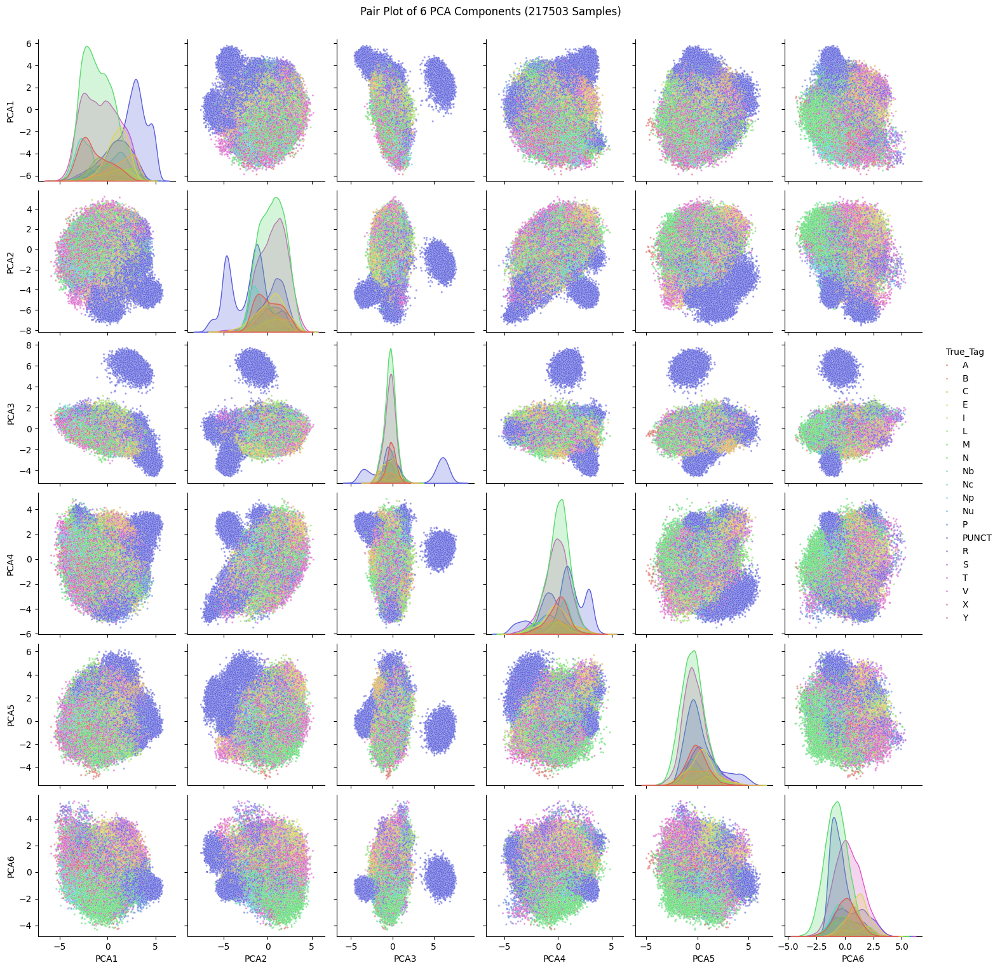

In [ ]:
analyze_reduction_components(X, y, VALID_TAGS, reduction_method='pca')


Detailed LDA Analysis (6 Components)
Taking a random subsample of 217503 first points.
Applying dimensionality reduction using method: LDA
Reducing dimensions using LDA (n_components=6)...
Reduction complete. New shape: (217503, 6)

Explained Variance
Total variance explained by 6 components: 83.39%
  - LDA 1: 48.68% (Cumulative: 48.68%)
  - LDA 2: 10.99% (Cumulative: 59.66%)
  - LDA 3: 8.06% (Cumulative: 67.72%)
  - LDA 4: 5.90% (Cumulative: 73.61%)
  - LDA 5: 5.36% (Cumulative: 78.97%)
  - LDA 6: 4.42% (Cumulative: 83.39%)


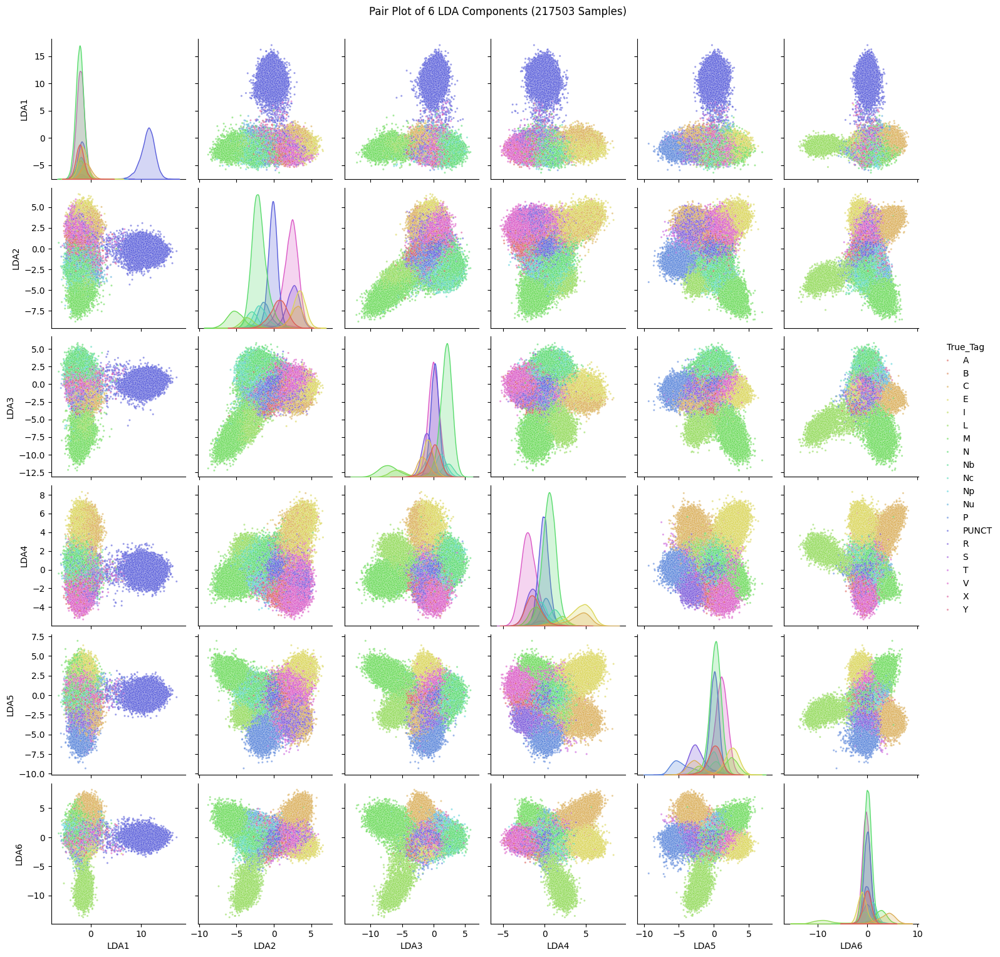

In [ ]:
analyze_reduction_components(X, y, VALID_TAGS, reduction_method='lda')

Clustering Progress:   0%|          | 0/18 [00:00<?, ?it/s]

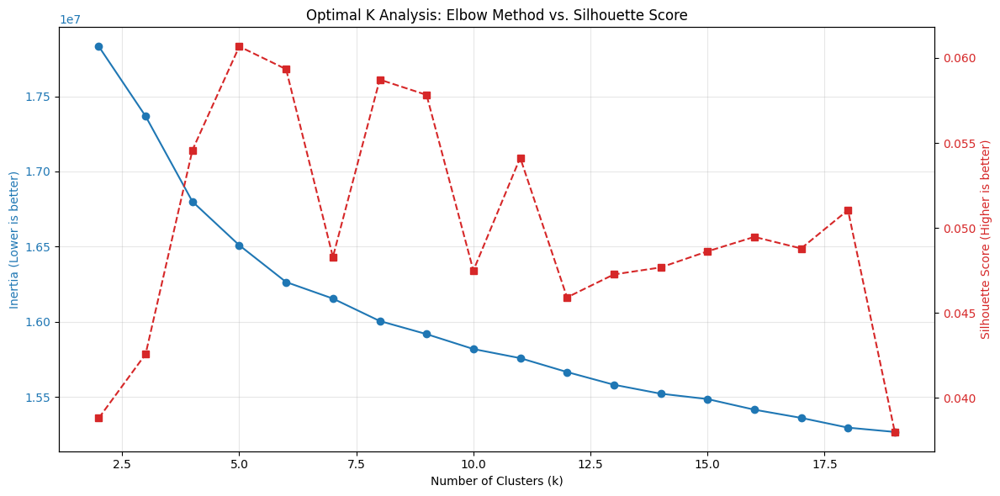

In [ ]:
analyze_optimal_k(X, k_range=range(2, 20))


Clustering & Visualization (PCA, K=5, 217503 samples)
Taking a random subsample of 217503 first points.
Applying dimensionality reduction using method: PCA
Reducing dimensions using PCA (n_components=2)
Reduction complete. New shape: (217503, 2)
Running KMeans with n_clusters=5


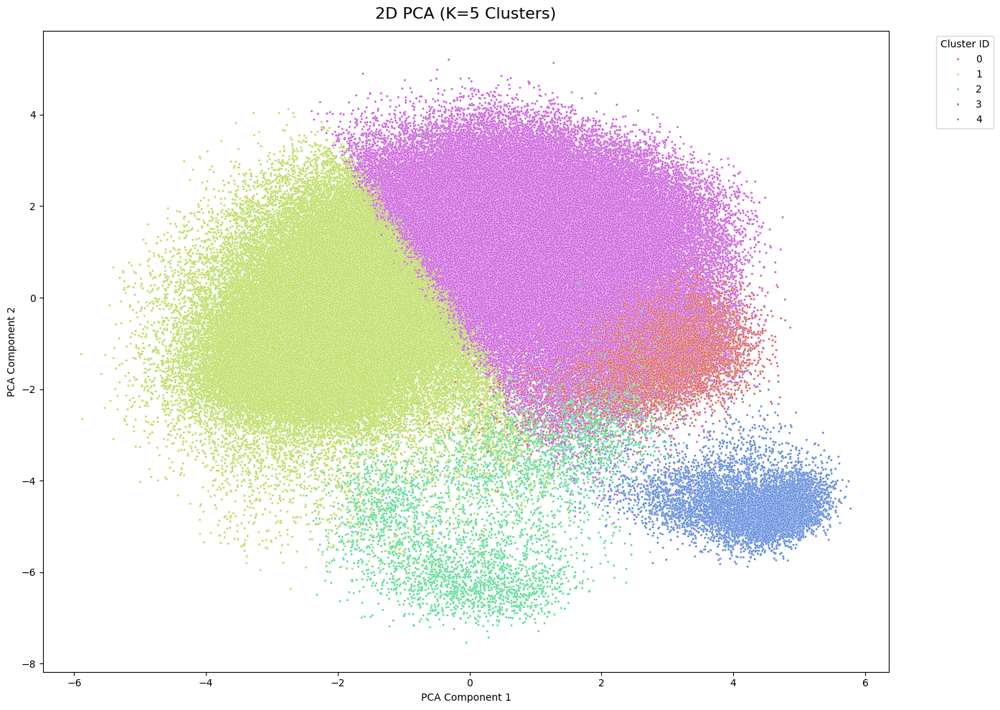

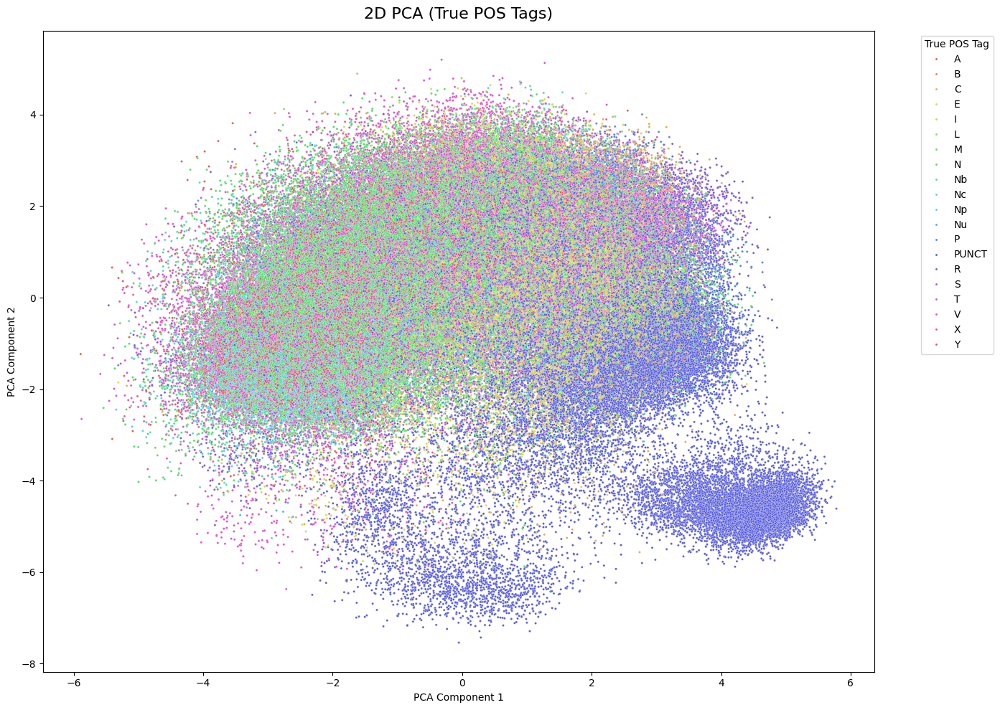

In [ ]:
run_clustering_and_visualization(X, y, VALID_TAGS, n_clusters=5, reduction_method='pca', n_samples=X.shape[0])


Clustering & Visualization (LDA, K=5, 217503 samples)
Taking a random subsample of 217503 first points.
Applying dimensionality reduction using method: LDA
Reducing dimensions using LDA (n_components=2)...
Reduction complete. New shape: (217503, 2)
Running KMeans with n_clusters=5


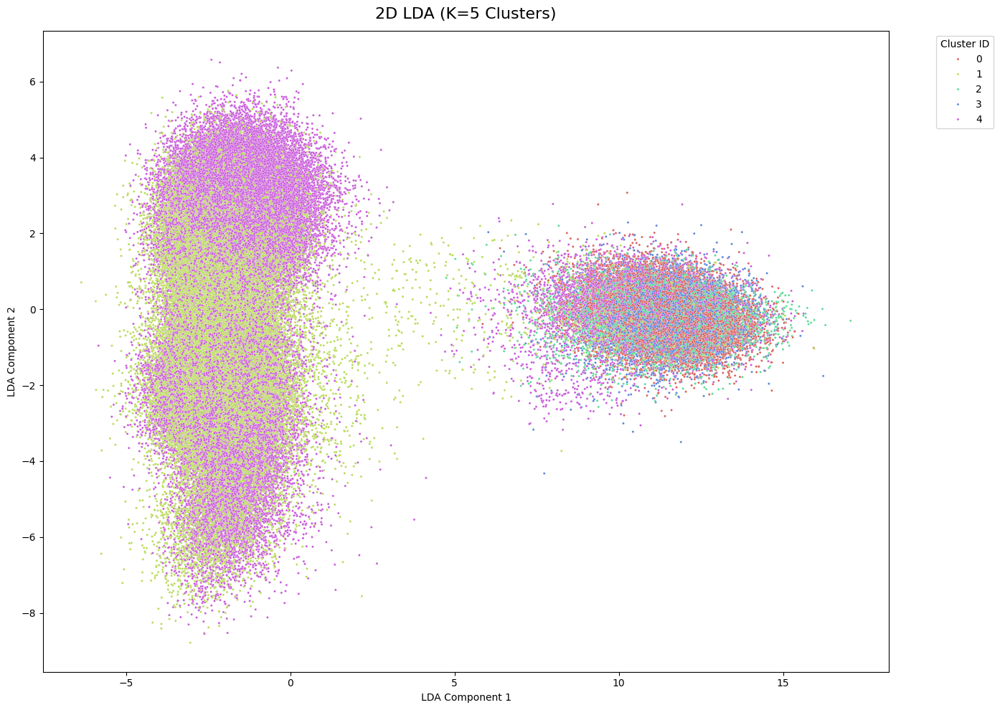

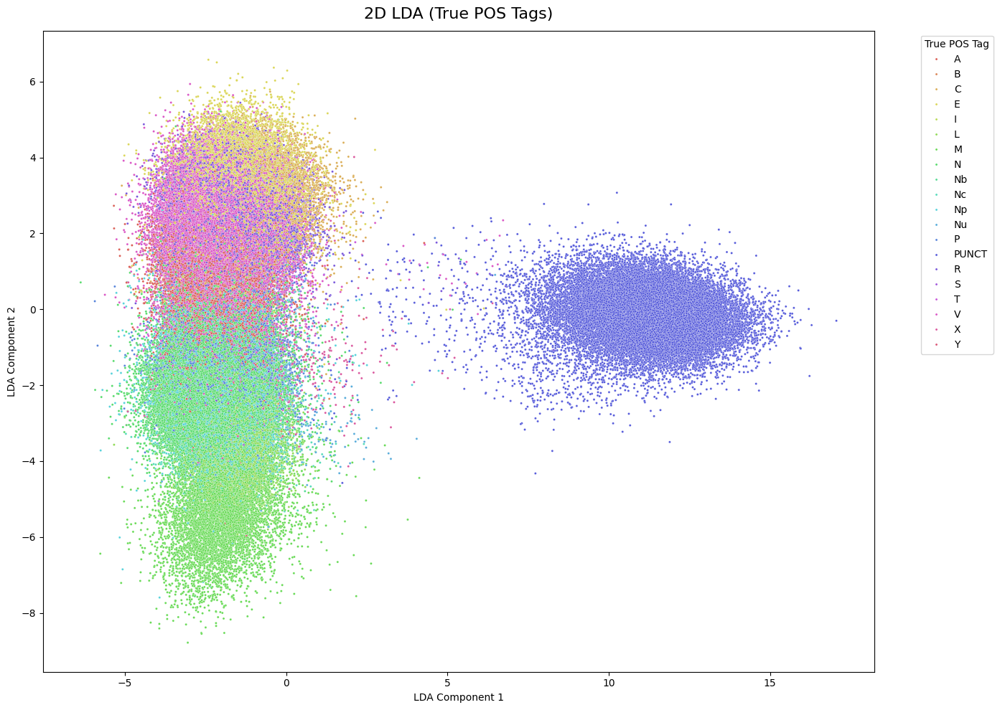

In [ ]:
run_clustering_and_visualization(X, y, VALID_TAGS, n_clusters=5, reduction_method='lda')

# Classification models

## Naive Bayes

In [ ]:
def run_naive_bayes(
    X_train: np.ndarray,
    y_train: List[str],
    X_test: np.ndarray,
    y_test: List[str],
    weighted: bool = False
) -> None:
    """
    Trains and evaluates a Naive Bayes classifier.

    Args:
        X_train (np.ndarray): Training features.
        y_train (List[str]): Training labels.
        X_test (np.ndarray): Test features.
        y_test (List[str]): Test labels.

    Return:
        None: This function trains and evaluates the model.
    """
    nb_model = GaussianNB()
    print("Fitting")
    if weighted:
        sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)
        nb_model.fit(X_train, y_train, sample_weight=sample_weights)
    else:
        nb_model.fit(X_train, y_train)
    print("Predicting")
    y_pred_nb = nb_model.predict(X_test)
    plot_confusion_matrix(y_test, y_pred_nb, labels=VALID_TAGS, title="Confusion Matrix - Naive Bayes")
    print(classification_report(y_test, y_pred_nb, target_names=VALID_TAGS, zero_division=0))

## Softmax Regression

In [ ]:
def run_softmax_regression(
    X_train: np.ndarray,
    y_train: List[str],
    X_test: np.ndarray,
    y_test: List[str],
    weighted: bool = False
) -> None:
    lr_model = SGDClassifier(
                    loss="log_loss",
                    max_iter=1000,
                    learning_rate="optimal",
                    class_weight="balanced",
                    random_state=42,
                    n_jobs=-1
                ) if weighted else SGDClassifier(
                                        loss="log_loss",
                                        max_iter=1000,
                                        learning_rate="optimal",
                                        random_state=42,
                                        n_jobs=-1
                                    )
    print("Fitting")
    lr_model.fit(X_train, y_train)
    print("Predicting")
    y_pred_lr = lr_model.predict(X_test)
    plot_confusion_matrix(y_test, y_pred_lr, labels=VALID_TAGS, title="Confusion Matrix - Logistic Regression")
    print(classification_report(y_test, y_pred_lr, target_names=VALID_TAGS, zero_division=0))

## MLP

In [ ]:
class MLP(nn.Module):
    def __init__(
        self,
        input_dim: int,
        hidden1: int = 256,
        hidden2: int = 128,
        num_classes: int = 0
    ) -> None:
        """
        Initializes the MLP architecture.

        Args:
            input_dim (int): The size of the input features (e.g., 768).
            hidden1 (int): Number of neurons in the first hidden layer.
            hidden2 (int): Number of neurons in the second hidden layer.
            num_classes (int): The number of output classes (number of tags).

        Return:
            None
        """
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden1),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden1, hidden2),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden2, num_classes)
        )

    def forward(
        self,
        x: torch.Tensor
    ) -> torch.Tensor:
        """
        Defines the forward pass of the MLP.

        Args:
            x (torch.Tensor): The input tensor (batch_size, input_dim).

        Return:
            torch.Tensor: The output logits (batch_size, num_classes).
        """
        return self.model(x)

def evaluate_mlp(
    model: nn.Module,
    loader: DataLoader,
    criterion: nn.Module,
    device: torch.device
) -> Tuple[float, float]:
    """
    Evaluates the MLP model on a given DataLoader (for test/validation).

    Args:
        model (nn.Module): The MLP model to evaluate.
        loader (DataLoader): The DataLoader containing the data (test or dev).
        criterion (nn.Module): The loss function (e.g., CrossEntropyLoss).
        device (torch.device): The device (CPU or CUDA) to run on.

    Return:
        Tuple[float, float]: A tuple of (average_loss, accuracy).
    """
    model.eval()
    total_loss = 0.0
    total_samples = 0
    correct = 0

    with torch.no_grad():
        for X_batch, y_batch in loader:
            X_batch = X_batch.to(device)
            y_batch = y_batch.to(device)

            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)

            preds = torch.argmax(outputs, dim=1)
            correct += (preds == y_batch).sum().item()
            total_samples += y_batch.size(0)
            total_loss += loss.item() * y_batch.size(0)

    avg_loss = total_loss / total_samples if total_samples > 0 else 0.0
    acc = correct / total_samples if total_samples > 0 else 0.0
    return avg_loss, acc

def train_mlp(
    X_train: np.ndarray,
    y_train: List[Any],
    X_test: np.ndarray,
    y_test: List[Any],
    all_labels: List[str],
    input_dim: int,
    weighted: bool = False
) -> None:
    """
    Orchestrates the entire training and evaluation pipeline for the MLP model.
    Uses X_test/y_test as the validation set as requested.

    Args:
        X_train (np.ndarray): Training features.
        y_train (List[Any]): Training labels.
        X_test (np.ndarray): Test features (used as validation).
        y_test (List[Any]): Test labels (used as validation).
        all_labels (List[str]): Full list of unique labels for the LabelEncoder.
        input_dim (int): The input feature dimension (768).

    Return:
        None: This function trains the model, prints logs, and shows plots.
    """
    le = LabelEncoder()
    le.fit(all_labels)
    ALL_LABELS_MLP = list(le.classes_)

    y_train_encoded = le.transform(y_train)
    y_test_encoded = le.transform(y_test)

    unique_classes = np.unique(y_train_encoded)
    class_weights = compute_class_weight(
        class_weight='balanced',
        classes=unique_classes,
        y=y_train_encoded
    )
    class_weights_tensor = torch.tensor(class_weights, dtype=torch.float32).to(DEVICE)

    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train_encoded, dtype=torch.long)
    X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test_encoded, dtype=torch.long)

    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

    train_loader = DataLoader(
        train_dataset,
        batch_size=PYTORCH_BATCH_SIZE,
        shuffle=True,
        num_workers=0
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=PYTORCH_BATCH_SIZE * 2,
        shuffle=False,
        num_workers=0
    )

    print(f"Train samples: {len(train_dataset)}, Test samples: {len(test_dataset)}")
    print(f"Train batches: {len(train_loader)}, Test batches: {len(test_loader)}")

    model = MLP(input_dim=input_dim, num_classes=len(ALL_LABELS_MLP)).to(DEVICE)
    criterion = nn.CrossEntropyLoss(weight=class_weights_tensor) if weighted else nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

    best_test_acc = 0.0
    train_losses, test_losses = [], []

    for epoch in range(1, EPOCHS + 1):
        model.train()
        total_train_loss = 0.0
        total_train_samples = 0

        pbar = tqdm(train_loader, desc=f"Epoch {epoch}/{EPOCHS} - train")

        for X_batch, y_batch in pbar:
            X_batch = X_batch.to(DEVICE)
            y_batch = y_batch.to(DEVICE)

            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)
            loss.backward()
            optimizer.step()

            batch_n = y_batch.size(0)
            total_train_loss += loss.item() * batch_n
            total_train_samples += batch_n
            avg_loss_so_far = total_train_loss / total_train_samples
            pbar.set_postfix({"avg_train_loss": f"{avg_loss_so_far:.4f}"})

        avg_train_loss = total_train_loss / total_train_samples

        test_loss, test_acc = evaluate_mlp(model, test_loader, criterion, DEVICE)

        train_losses.append(avg_train_loss)
        test_losses.append(test_loss)

        print(f"\n✅ Epoch {epoch}: Train Loss={avg_train_loss:.4f} | Test Loss={test_loss:.4f} | Test Acc={test_acc:.4f}")

        if test_acc > best_test_acc:
            best_test_acc = test_acc
            torch.save(model.state_dict(), "best_mlp_phobert.pt")
            print(f"New best model saved (test_acc={best_test_acc:.4f})")

    plot_loss(train_losses, test_losses)

    print("Loading best model for final test evaluation...")
    model.load_state_dict(torch.load("best_mlp_phobert.pt"))

    all_true_labels = []
    all_pred_labels = []
    print("Generating predictions for Test set")
    model.eval()
    with torch.no_grad():
        for X_batch, y_batch in tqdm(test_loader, desc="Predicting Test Set"):
            X_batch = X_batch.to(DEVICE)
            y_batch_cpu = y_batch.numpy()

            outputs = model(X_batch)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()

            pred_labels = le.inverse_transform(preds)
            true_labels = le.inverse_transform(y_batch_cpu)

            all_pred_labels.extend(pred_labels)
            all_true_labels.extend(true_labels)

    print(f"Best Test Accuracy (from validation): {best_test_acc:.4f}")
    plot_confusion_matrix(all_true_labels, all_pred_labels, labels=ALL_LABELS_MLP, title="Confusion Matrix - MLP")
    print(classification_report(all_true_labels, all_pred_labels, zero_division=0, target_names=ALL_LABELS_MLP))

# Run classification - 768D

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train, X_test, y_train, y_test = train_test_split_by_ratio()

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501


### Naive Bayes

Fitting
Predicting


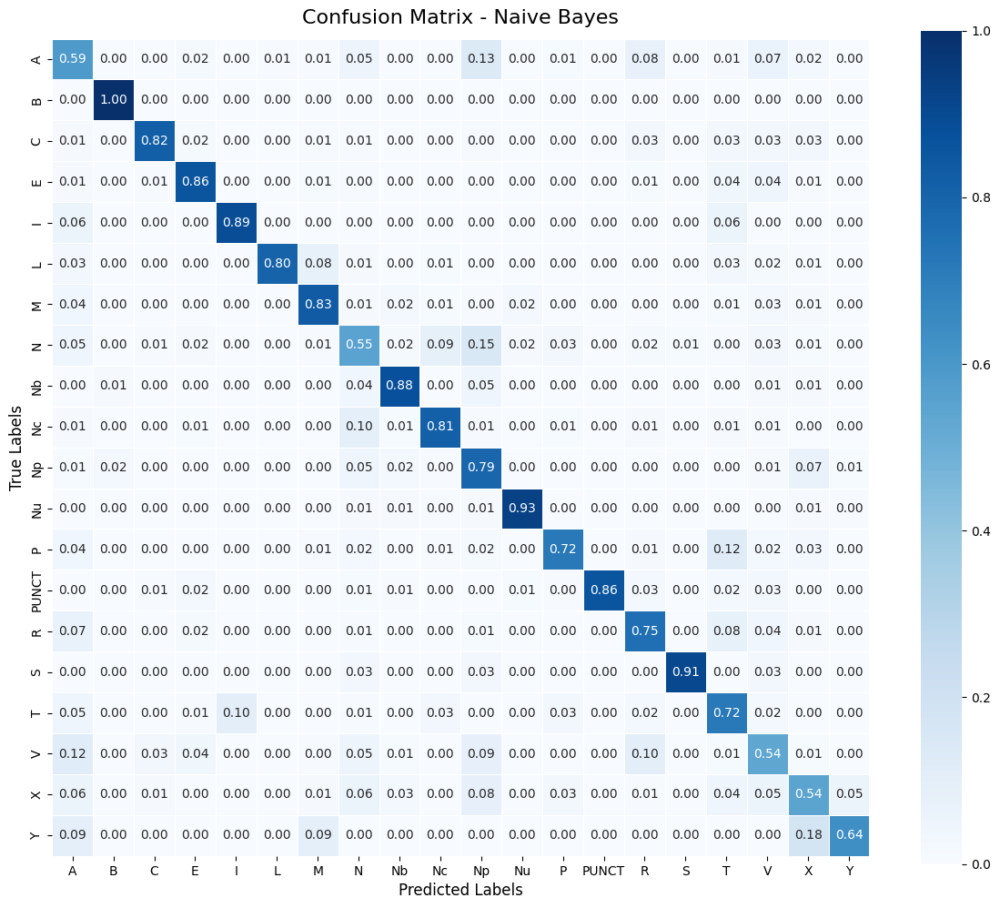

              precision    recall  f1-score   support

           A       0.44      0.59      0.51      2685
           B       0.09      1.00      0.16         4
           C       0.77      0.82      0.79      1578
           E       0.75      0.86      0.80      2708
           I       0.29      0.89      0.44        18
           L       0.96      0.80      0.88       787
           M       0.84      0.83      0.84      1617
           N       0.85      0.55      0.67     10308
          Nb       0.15      0.88      0.25        80
          Nc       0.48      0.81      0.60      1090
          Np       0.33      0.79      0.46      1703
          Nu       0.43      0.93      0.59       206
           P       0.74      0.72      0.73      1853
       PUNCT       1.00      0.86      0.92      6421
           R       0.61      0.75      0.68      3164
           S       0.18      0.91      0.30        32
           T       0.17      0.72      0.27       281
           V       0.81    

In [ ]:
run_naive_bayes(X_train, y_train, X_test, y_test)

### Softmax Regression

Fitting
Predicting


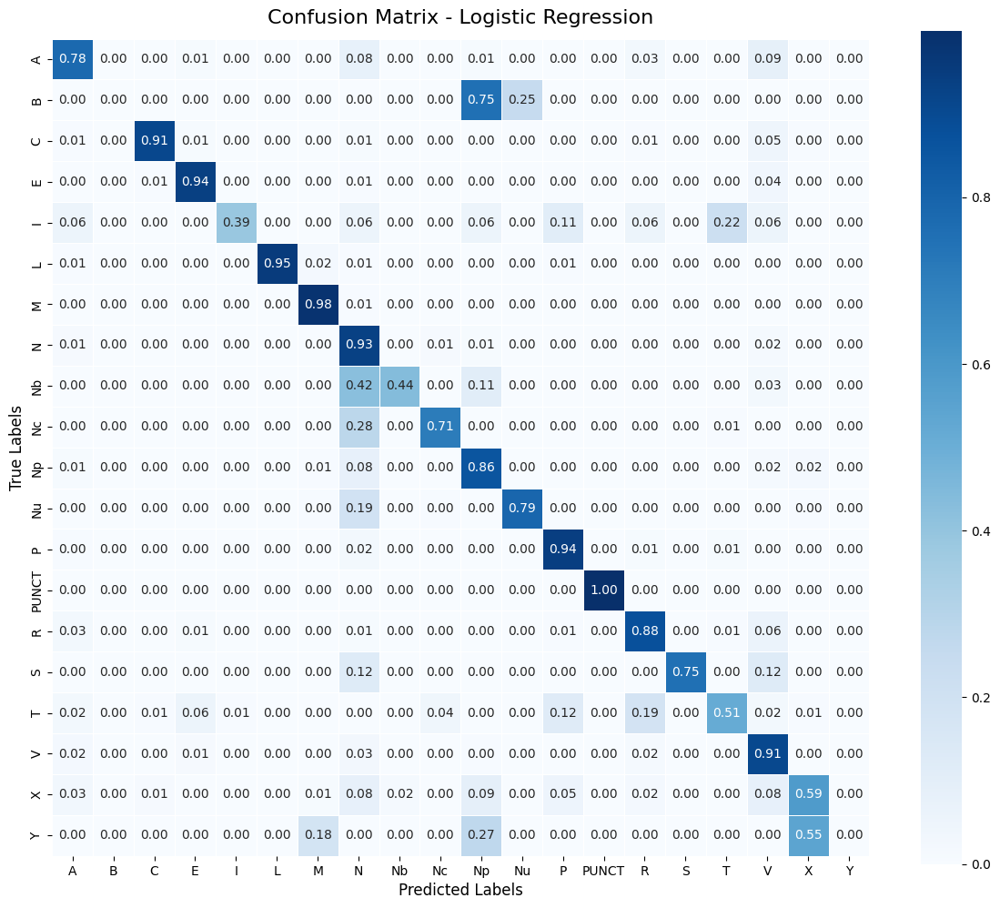

              precision    recall  f1-score   support

           A       0.81      0.78      0.79      2685
           B       0.00      0.00      0.00         4
           C       0.95      0.91      0.93      1578
           E       0.92      0.94      0.93      2708
           I       0.70      0.39      0.50        18
           L       0.98      0.95      0.97       787
           M       0.96      0.98      0.97      1617
           N       0.89      0.93      0.91     10308
          Nb       0.73      0.44      0.55        80
          Nc       0.83      0.71      0.77      1090
          Np       0.87      0.86      0.86      1703
          Nu       0.87      0.79      0.83       206
           P       0.93      0.94      0.94      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.90      0.88      0.89      3164
           S       0.92      0.75      0.83        32
           T       0.68      0.51      0.58       281
           V       0.90    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test)

### MLP

Train samples: 174002, Test samples: 43501
Train batches: 5438, Test batches: 680


Epoch 1/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=1.6344 | Test Loss=0.9329 | Test Acc=0.7456
New best model saved (test_acc=0.7456)


Epoch 2/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=0.7485 | Test Loss=0.5482 | Test Acc=0.8501
New best model saved (test_acc=0.8501)


Epoch 3/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.5305 | Test Loss=0.4396 | Test Acc=0.8707
New best model saved (test_acc=0.8707)


Epoch 4/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.4541 | Test Loss=0.3934 | Test Acc=0.8801
New best model saved (test_acc=0.8801)


Epoch 5/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.4125 | Test Loss=0.3657 | Test Acc=0.8869
New best model saved (test_acc=0.8869)


Epoch 6/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.3858 | Test Loss=0.3465 | Test Acc=0.8930
New best model saved (test_acc=0.8930)


Epoch 7/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.3649 | Test Loss=0.3327 | Test Acc=0.8959
New best model saved (test_acc=0.8959)


Epoch 8/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.3516 | Test Loss=0.3215 | Test Acc=0.8983
New best model saved (test_acc=0.8983)


Epoch 9/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.3387 | Test Loss=0.3131 | Test Acc=0.9006
New best model saved (test_acc=0.9006)


Epoch 10/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.3283 | Test Loss=0.3057 | Test Acc=0.9025
New best model saved (test_acc=0.9025)


Epoch 11/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.3205 | Test Loss=0.2998 | Test Acc=0.9037
New best model saved (test_acc=0.9037)


Epoch 12/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.3119 | Test Loss=0.2941 | Test Acc=0.9054
New best model saved (test_acc=0.9054)


Epoch 13/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.3059 | Test Loss=0.2896 | Test Acc=0.9061
New best model saved (test_acc=0.9061)


Epoch 14/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.3003 | Test Loss=0.2850 | Test Acc=0.9072
New best model saved (test_acc=0.9072)


Epoch 15/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.2941 | Test Loss=0.2813 | Test Acc=0.9075
New best model saved (test_acc=0.9075)


Epoch 16/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.2886 | Test Loss=0.2773 | Test Acc=0.9088
New best model saved (test_acc=0.9088)


Epoch 17/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.2850 | Test Loss=0.2740 | Test Acc=0.9094
New best model saved (test_acc=0.9094)


Epoch 18/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.2805 | Test Loss=0.2708 | Test Acc=0.9104
New best model saved (test_acc=0.9104)


Epoch 19/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.2761 | Test Loss=0.2683 | Test Acc=0.9108
New best model saved (test_acc=0.9108)


Epoch 20/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.2719 | Test Loss=0.2657 | Test Acc=0.9117
New best model saved (test_acc=0.9117)


Epoch 21/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.2683 | Test Loss=0.2628 | Test Acc=0.9122
New best model saved (test_acc=0.9122)


Epoch 22/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.2644 | Test Loss=0.2600 | Test Acc=0.9129
New best model saved (test_acc=0.9129)


Epoch 23/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.2615 | Test Loss=0.2578 | Test Acc=0.9133
New best model saved (test_acc=0.9133)


Epoch 24/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.2584 | Test Loss=0.2556 | Test Acc=0.9139
New best model saved (test_acc=0.9139)


Epoch 25/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.2551 | Test Loss=0.2531 | Test Acc=0.9146
New best model saved (test_acc=0.9146)


Epoch 26/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.2513 | Test Loss=0.2515 | Test Acc=0.9151
New best model saved (test_acc=0.9151)


Epoch 27/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.2490 | Test Loss=0.2497 | Test Acc=0.9152
New best model saved (test_acc=0.9152)


Epoch 28/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.2466 | Test Loss=0.2480 | Test Acc=0.9157
New best model saved (test_acc=0.9157)


Epoch 29/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.2428 | Test Loss=0.2462 | Test Acc=0.9166
New best model saved (test_acc=0.9166)


Epoch 30/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.2414 | Test Loss=0.2446 | Test Acc=0.9168
New best model saved (test_acc=0.9168)


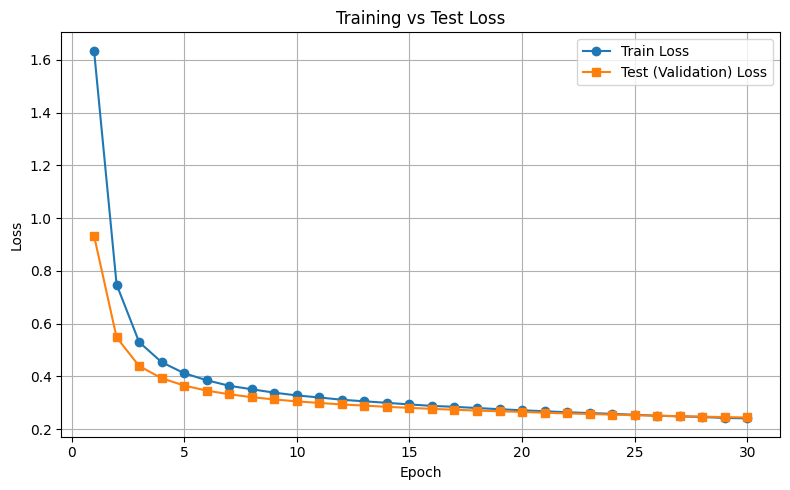

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/680 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.9168


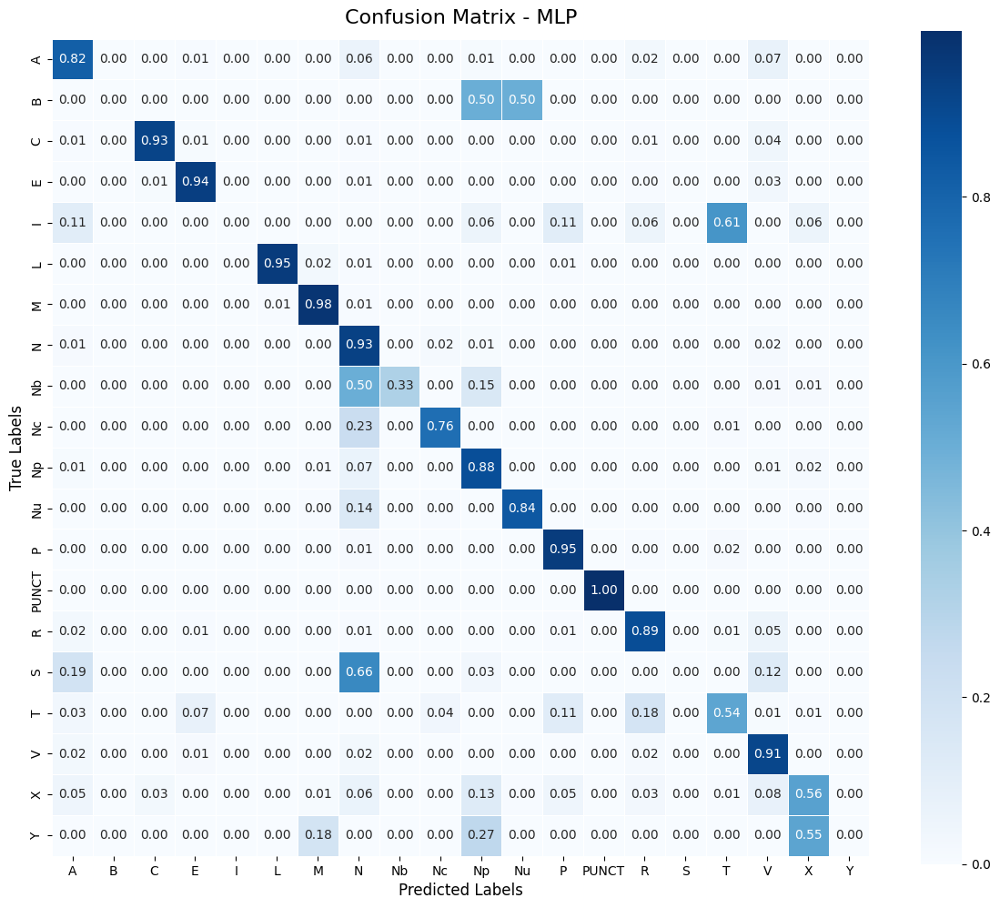

              precision    recall  f1-score   support

           A       0.81      0.82      0.82      2685
           B       0.00      0.00      0.00         4
           C       0.94      0.93      0.93      1578
           E       0.93      0.94      0.93      2708
           I       0.00      0.00      0.00        18
           L       0.98      0.95      0.96       787
           M       0.96      0.98      0.97      1617
           N       0.91      0.93      0.92     10308
          Nb       0.96      0.33      0.49        80
          Nc       0.82      0.76      0.79      1090
          Np       0.86      0.88      0.87      1703
          Nu       0.83      0.84      0.84       206
           P       0.94      0.95      0.94      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.90      0.89      0.90      3164
           S       0.00      0.00      0.00        32
           T       0.62      0.54      0.58       281
           V       0.91    

In [ ]:
train_mlp(X_train, y_train, X_test, y_test, VALID_TAGS, input_dim=X_train.shape[1])

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train, X_test, y_train, y_test = train_test_split_by_ratio()

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251


### Naive Bayes

Fitting
Predicting


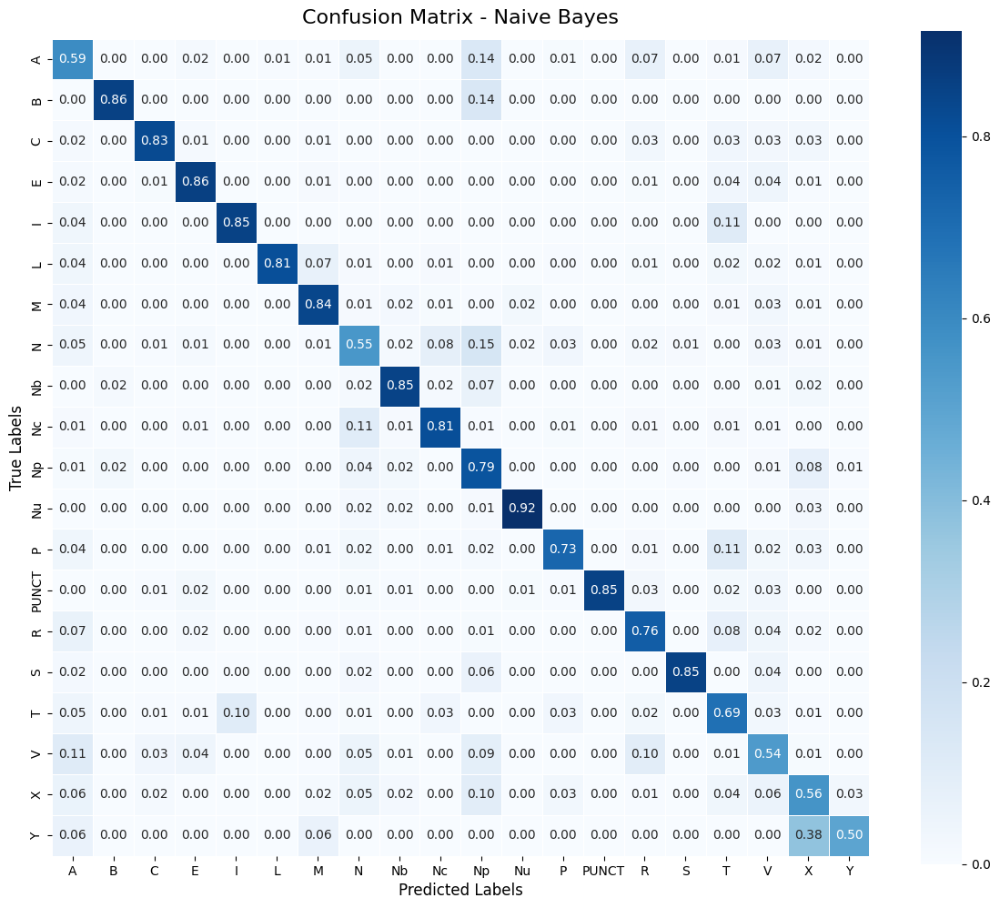

              precision    recall  f1-score   support

           A       0.45      0.59      0.51      4027
           B       0.09      0.86      0.16         7
           C       0.76      0.83      0.79      2367
           E       0.75      0.86      0.80      4061
           I       0.28      0.85      0.43        27
           L       0.97      0.81      0.88      1180
           M       0.84      0.84      0.84      2425
           N       0.85      0.55      0.67     15462
          Nb       0.15      0.85      0.25       121
          Nc       0.48      0.81      0.60      1634
          Np       0.32      0.79      0.46      2555
          Nu       0.42      0.92      0.58       310
           P       0.73      0.73      0.73      2779
       PUNCT       1.00      0.85      0.92      9632
           R       0.62      0.76      0.68      4746
           S       0.17      0.85      0.29        48
           T       0.16      0.69      0.27       422
           V       0.80    

In [ ]:
run_naive_bayes(X_train, y_train, X_test, y_test)

### Softmax Regression

Fitting
Predicting


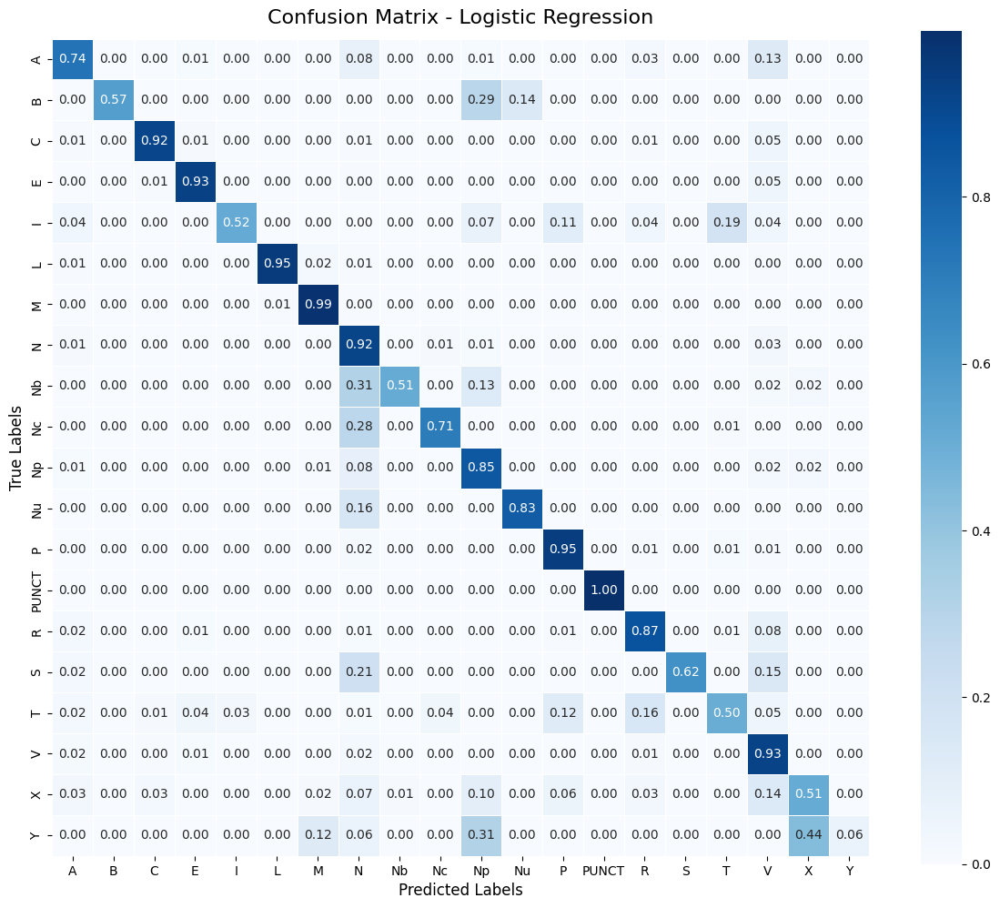

              precision    recall  f1-score   support

           A       0.83      0.74      0.78      4027
           B       0.67      0.57      0.62         7
           C       0.94      0.92      0.93      2367
           E       0.92      0.93      0.93      4061
           I       0.48      0.52      0.50        27
           L       0.96      0.95      0.96      1180
           M       0.96      0.99      0.97      2425
           N       0.90      0.92      0.91     15462
          Nb       0.77      0.51      0.61       121
          Nc       0.83      0.71      0.76      1634
          Np       0.87      0.85      0.86      2555
          Nu       0.87      0.83      0.85       310
           P       0.93      0.95      0.94      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.90      0.87      0.89      4746
           S       0.86      0.62      0.72        48
           T       0.67      0.50      0.58       422
           V       0.87    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test)

### MLP

Train samples: 152252, Test samples: 65251
Train batches: 4758, Test batches: 1020


Epoch 1/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=1.7134 | Test Loss=1.0270 | Test Acc=0.7161
New best model saved (test_acc=0.7161)


Epoch 2/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=0.8213 | Test Loss=0.6014 | Test Acc=0.8424
New best model saved (test_acc=0.8424)


Epoch 3/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.5675 | Test Loss=0.4652 | Test Acc=0.8656
New best model saved (test_acc=0.8656)


Epoch 4/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.4737 | Test Loss=0.4094 | Test Acc=0.8767
New best model saved (test_acc=0.8767)


Epoch 5/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.4288 | Test Loss=0.3784 | Test Acc=0.8840
New best model saved (test_acc=0.8840)


Epoch 6/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.3975 | Test Loss=0.3576 | Test Acc=0.8898
New best model saved (test_acc=0.8898)


Epoch 7/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.3786 | Test Loss=0.3429 | Test Acc=0.8930
New best model saved (test_acc=0.8930)


Epoch 8/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.3608 | Test Loss=0.3309 | Test Acc=0.8964
New best model saved (test_acc=0.8964)


Epoch 9/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.3484 | Test Loss=0.3216 | Test Acc=0.8981
New best model saved (test_acc=0.8981)


Epoch 10/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.3380 | Test Loss=0.3142 | Test Acc=0.8999
New best model saved (test_acc=0.8999)


Epoch 11/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.3282 | Test Loss=0.3079 | Test Acc=0.9014
New best model saved (test_acc=0.9014)


Epoch 12/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.3217 | Test Loss=0.3023 | Test Acc=0.9028
New best model saved (test_acc=0.9028)


Epoch 13/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.3145 | Test Loss=0.2972 | Test Acc=0.9041
New best model saved (test_acc=0.9041)


Epoch 14/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.3088 | Test Loss=0.2929 | Test Acc=0.9051
New best model saved (test_acc=0.9051)


Epoch 15/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.3029 | Test Loss=0.2891 | Test Acc=0.9058
New best model saved (test_acc=0.9058)


Epoch 16/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.2966 | Test Loss=0.2853 | Test Acc=0.9064
New best model saved (test_acc=0.9064)


Epoch 17/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.2923 | Test Loss=0.2822 | Test Acc=0.9077
New best model saved (test_acc=0.9077)


Epoch 18/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.2881 | Test Loss=0.2790 | Test Acc=0.9083
New best model saved (test_acc=0.9083)


Epoch 19/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.2838 | Test Loss=0.2762 | Test Acc=0.9090
New best model saved (test_acc=0.9090)


Epoch 20/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.2796 | Test Loss=0.2737 | Test Acc=0.9099
New best model saved (test_acc=0.9099)


Epoch 21/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.2762 | Test Loss=0.2712 | Test Acc=0.9105
New best model saved (test_acc=0.9105)


Epoch 22/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.2728 | Test Loss=0.2686 | Test Acc=0.9113
New best model saved (test_acc=0.9113)


Epoch 23/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.2680 | Test Loss=0.2664 | Test Acc=0.9117
New best model saved (test_acc=0.9117)


Epoch 24/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.2663 | Test Loss=0.2648 | Test Acc=0.9120
New best model saved (test_acc=0.9120)


Epoch 25/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.2637 | Test Loss=0.2624 | Test Acc=0.9126
New best model saved (test_acc=0.9126)


Epoch 26/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.2612 | Test Loss=0.2607 | Test Acc=0.9132
New best model saved (test_acc=0.9132)


Epoch 27/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.2572 | Test Loss=0.2589 | Test Acc=0.9139
New best model saved (test_acc=0.9139)


Epoch 28/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.2554 | Test Loss=0.2572 | Test Acc=0.9140
New best model saved (test_acc=0.9140)


Epoch 29/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.2528 | Test Loss=0.2555 | Test Acc=0.9147
New best model saved (test_acc=0.9147)


Epoch 30/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.2497 | Test Loss=0.2538 | Test Acc=0.9149
New best model saved (test_acc=0.9149)


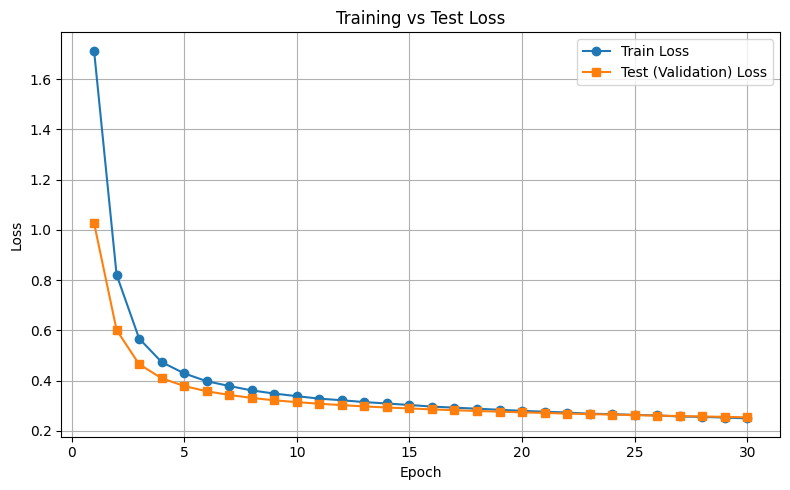

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1020 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.9149


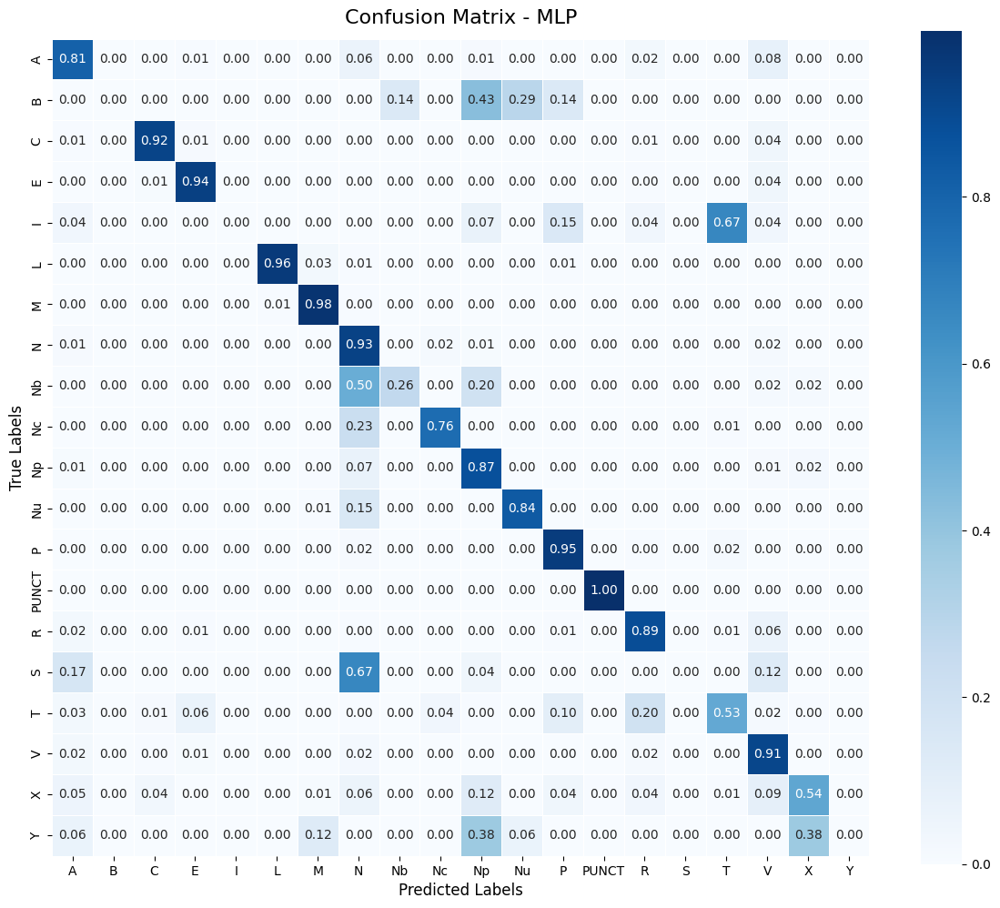

              precision    recall  f1-score   support

           A       0.81      0.81      0.81      4027
           B       0.00      0.00      0.00         7
           C       0.93      0.92      0.93      2367
           E       0.93      0.94      0.93      4061
           I       0.00      0.00      0.00        27
           L       0.97      0.96      0.96      1180
           M       0.96      0.98      0.97      2425
           N       0.91      0.93      0.92     15462
          Nb       0.91      0.26      0.41       121
          Nc       0.82      0.76      0.79      1634
          Np       0.86      0.87      0.87      2555
          Nu       0.84      0.84      0.84       310
           P       0.94      0.95      0.95      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.90      0.89      0.89      4746
           S       0.00      0.00      0.00        48
           T       0.62      0.53      0.57       422
           V       0.90    

In [ ]:
train_mlp(X_train, y_train, X_test, y_test, VALID_TAGS, input_dim=X_train.shape[1])

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train, X_test, y_train, y_test = train_test_split_by_ratio()

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002


### Naive Bayes

Fitting
Predicting


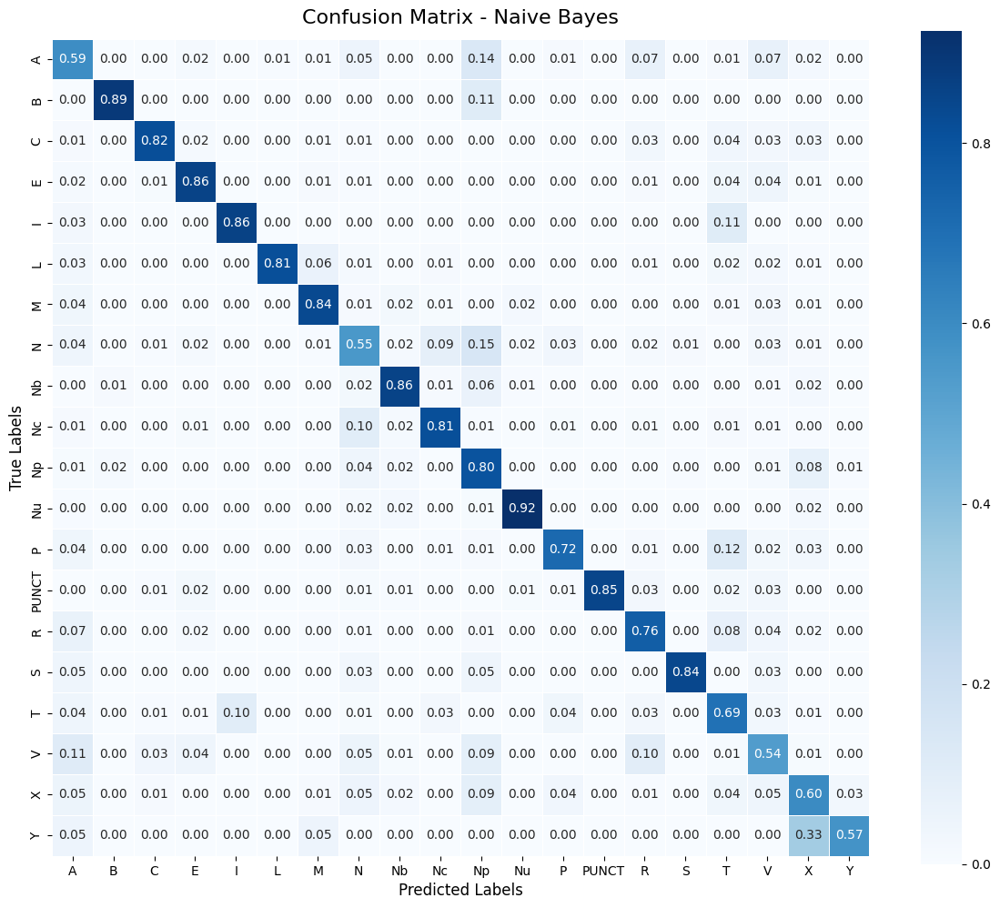

              precision    recall  f1-score   support

           A       0.45      0.59      0.51      5370
           B       0.13      0.89      0.22         9
           C       0.76      0.82      0.79      3156
           E       0.75      0.86      0.80      5415
           I       0.29      0.86      0.44        36
           L       0.97      0.81      0.89      1574
           M       0.85      0.84      0.84      3233
           N       0.85      0.55      0.67     20616
          Nb       0.14      0.86      0.25       161
          Nc       0.48      0.81      0.60      2179
          Np       0.32      0.80      0.46      3406
          Nu       0.44      0.92      0.59       413
           P       0.73      0.72      0.73      3705
       PUNCT       1.00      0.85      0.92     12843
           R       0.62      0.76      0.68      6328
           S       0.16      0.84      0.27        64
           T       0.16      0.69      0.27       563
           V       0.81    

In [ ]:
run_naive_bayes(X_train, y_train, X_test, y_test)

### Softmax Regression

Fitting
Predicting


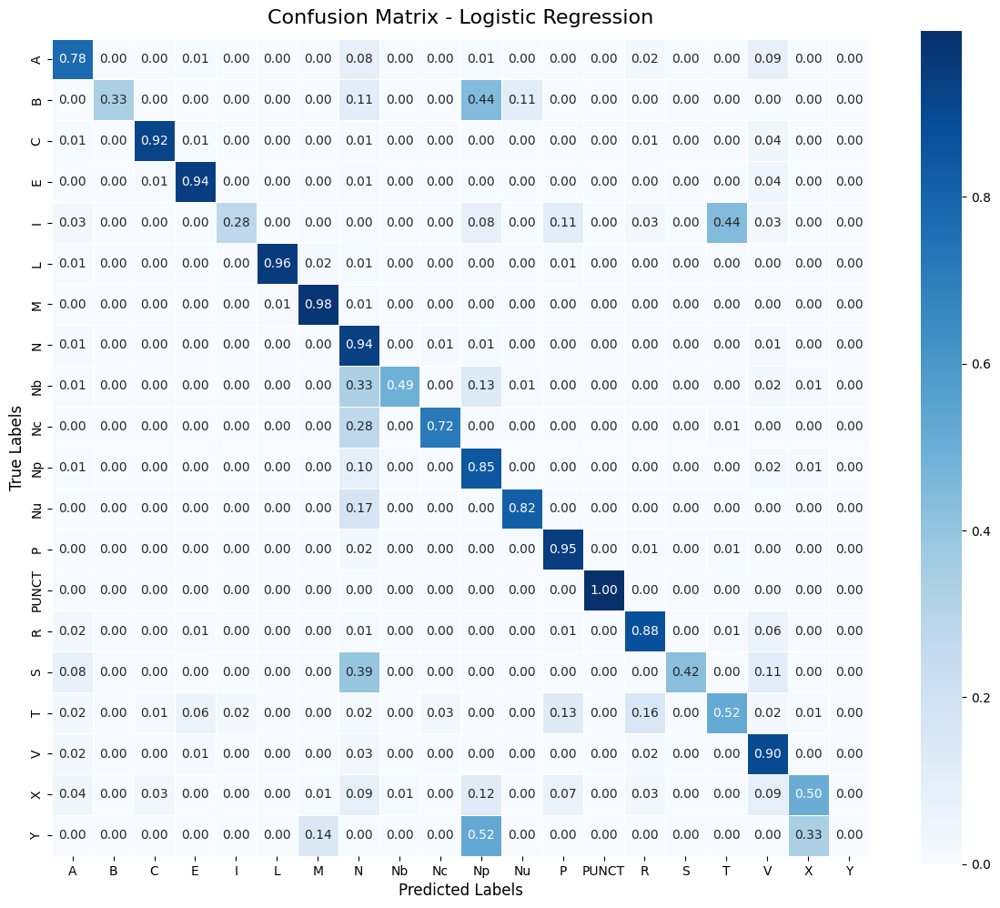

              precision    recall  f1-score   support

           A       0.81      0.78      0.80      5370
           B       0.60      0.33      0.43         9
           C       0.93      0.92      0.93      3156
           E       0.92      0.94      0.93      5415
           I       0.43      0.28      0.34        36
           L       0.96      0.96      0.96      1574
           M       0.97      0.98      0.98      3233
           N       0.89      0.94      0.91     20616
          Nb       0.72      0.49      0.59       161
          Nc       0.84      0.72      0.77      2179
          Np       0.86      0.85      0.86      3406
          Nu       0.90      0.82      0.86       413
           P       0.92      0.95      0.94      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.90      0.88      0.89      6328
           S       0.90      0.42      0.57        64
           T       0.67      0.52      0.58       563
           V       0.90    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test)

### MLP

Train samples: 130501, Test samples: 87002
Train batches: 4079, Test batches: 1360


Epoch 1/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=1.7995 | Test Loss=1.1114 | Test Acc=0.6904
New best model saved (test_acc=0.6904)


Epoch 2/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=0.8979 | Test Loss=0.6683 | Test Acc=0.8254
New best model saved (test_acc=0.8254)


Epoch 3/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.6248 | Test Loss=0.5047 | Test Acc=0.8589
New best model saved (test_acc=0.8589)


Epoch 4/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.5122 | Test Loss=0.4342 | Test Acc=0.8707
New best model saved (test_acc=0.8707)


Epoch 5/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.4563 | Test Loss=0.3964 | Test Acc=0.8785
New best model saved (test_acc=0.8785)


Epoch 6/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.4213 | Test Loss=0.3726 | Test Acc=0.8840
New best model saved (test_acc=0.8840)


Epoch 7/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.3984 | Test Loss=0.3557 | Test Acc=0.8895
New best model saved (test_acc=0.8895)


Epoch 8/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.3798 | Test Loss=0.3425 | Test Acc=0.8933
New best model saved (test_acc=0.8933)


Epoch 9/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.3651 | Test Loss=0.3318 | Test Acc=0.8963
New best model saved (test_acc=0.8963)


Epoch 10/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.3550 | Test Loss=0.3236 | Test Acc=0.8985
New best model saved (test_acc=0.8985)


Epoch 11/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.3438 | Test Loss=0.3158 | Test Acc=0.9010
New best model saved (test_acc=0.9010)


Epoch 12/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.3345 | Test Loss=0.3097 | Test Acc=0.9027
New best model saved (test_acc=0.9027)


Epoch 13/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.3278 | Test Loss=0.3046 | Test Acc=0.9036
New best model saved (test_acc=0.9036)


Epoch 14/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.3197 | Test Loss=0.2999 | Test Acc=0.9047
New best model saved (test_acc=0.9047)


Epoch 15/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.3148 | Test Loss=0.2955 | Test Acc=0.9058
New best model saved (test_acc=0.9058)


Epoch 16/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.3076 | Test Loss=0.2918 | Test Acc=0.9062
New best model saved (test_acc=0.9062)


Epoch 17/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.3032 | Test Loss=0.2881 | Test Acc=0.9071
New best model saved (test_acc=0.9071)


Epoch 18/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.2987 | Test Loss=0.2850 | Test Acc=0.9082
New best model saved (test_acc=0.9082)


Epoch 19/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.2947 | Test Loss=0.2819 | Test Acc=0.9087
New best model saved (test_acc=0.9087)


Epoch 20/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.2912 | Test Loss=0.2790 | Test Acc=0.9090
New best model saved (test_acc=0.9090)


Epoch 21/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.2868 | Test Loss=0.2766 | Test Acc=0.9097
New best model saved (test_acc=0.9097)


Epoch 22/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.2830 | Test Loss=0.2741 | Test Acc=0.9104
New best model saved (test_acc=0.9104)


Epoch 23/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.2798 | Test Loss=0.2720 | Test Acc=0.9108
New best model saved (test_acc=0.9108)


Epoch 24/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.2757 | Test Loss=0.2698 | Test Acc=0.9115
New best model saved (test_acc=0.9115)


Epoch 25/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.2722 | Test Loss=0.2676 | Test Acc=0.9115


Epoch 26/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.2694 | Test Loss=0.2658 | Test Acc=0.9120
New best model saved (test_acc=0.9120)


Epoch 27/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.2661 | Test Loss=0.2638 | Test Acc=0.9121
New best model saved (test_acc=0.9121)


Epoch 28/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.2629 | Test Loss=0.2621 | Test Acc=0.9127
New best model saved (test_acc=0.9127)


Epoch 29/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.2613 | Test Loss=0.2603 | Test Acc=0.9131
New best model saved (test_acc=0.9131)


Epoch 30/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.2569 | Test Loss=0.2589 | Test Acc=0.9137
New best model saved (test_acc=0.9137)


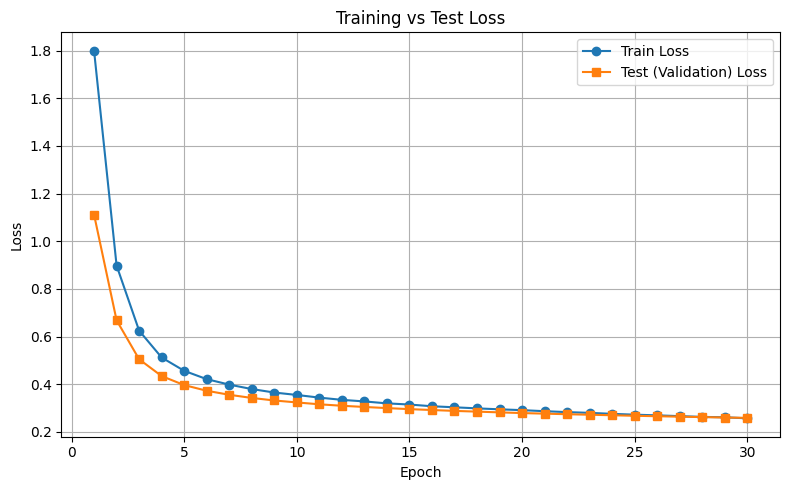

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1360 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.9137


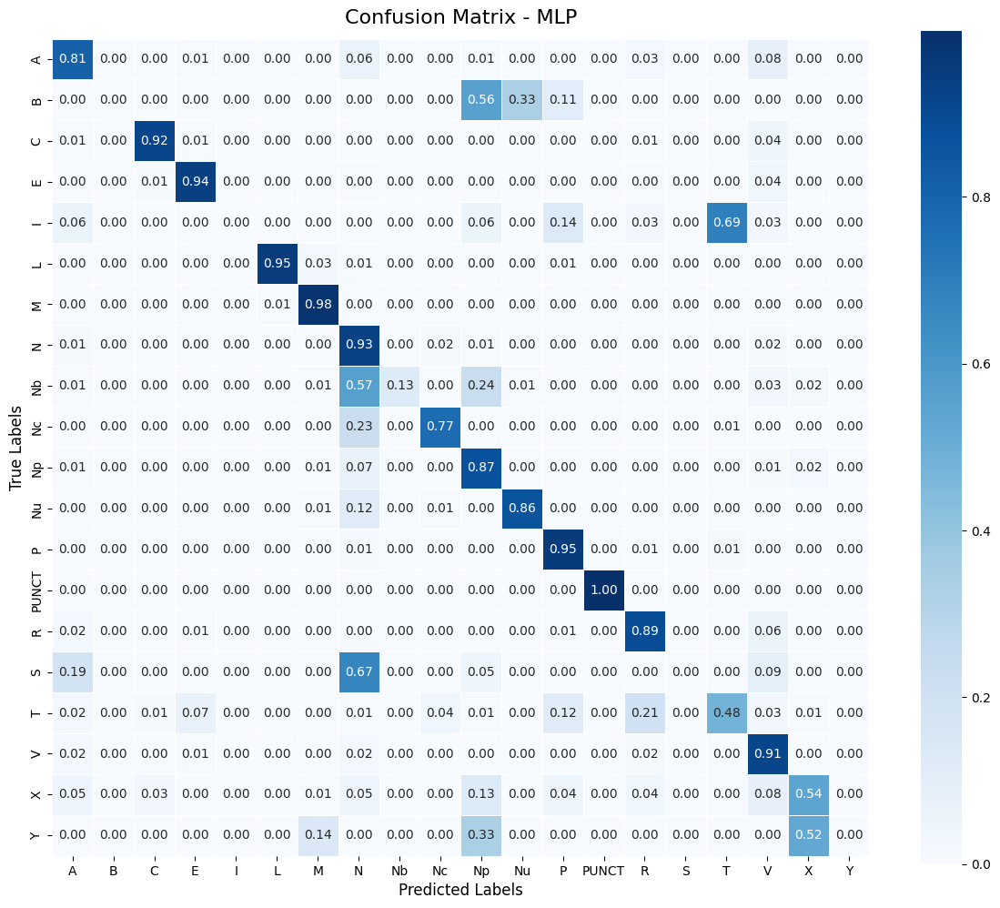

              precision    recall  f1-score   support

           A       0.82      0.81      0.81      5370
           B       0.00      0.00      0.00         9
           C       0.93      0.92      0.93      3156
           E       0.93      0.94      0.93      5415
           I       0.00      0.00      0.00        36
           L       0.96      0.95      0.95      1574
           M       0.96      0.98      0.97      3233
           N       0.91      0.93      0.92     20616
          Nb       0.91      0.13      0.23       161
          Nc       0.82      0.77      0.79      2179
          Np       0.85      0.87      0.86      3406
          Nu       0.84      0.86      0.85       413
           P       0.93      0.95      0.94      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.89      0.89      0.89      6328
           S       0.00      0.00      0.00        64
           T       0.65      0.48      0.55       563
           V       0.90    

In [ ]:
train_mlp(X_train, y_train, X_test, y_test, VALID_TAGS, input_dim=X_train.shape[1])

# Run classification - 256D

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501
Decomposed data (By PCA)
Train shape: (174002, 256), Test shape: (43501, 256)


### Naive Bayes

Fitting
Predicting


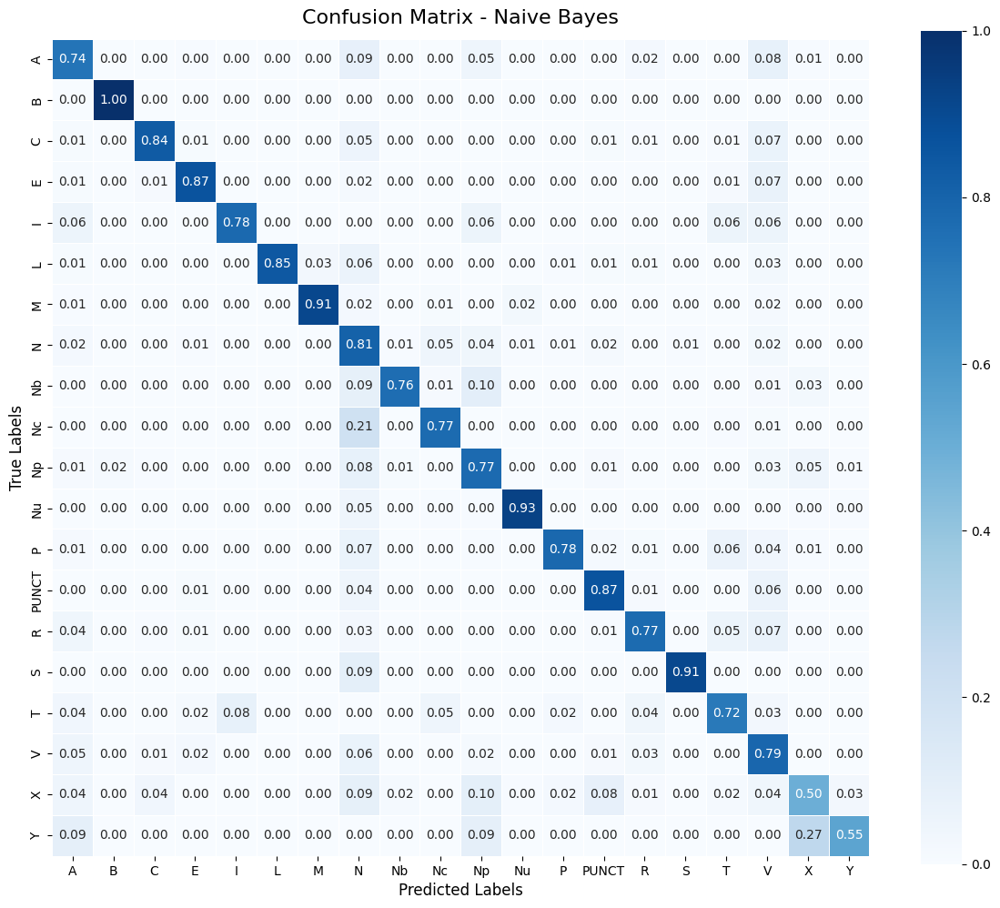

              precision    recall  f1-score   support

           A       0.69      0.74      0.71      2685
           B       0.12      1.00      0.22         4
           C       0.87      0.84      0.85      1578
           E       0.86      0.87      0.86      2708
           I       0.30      0.78      0.44        18
           L       1.00      0.85      0.92       787
           M       0.96      0.91      0.93      1617
           N       0.81      0.81      0.81     10308
          Nb       0.32      0.76      0.45        80
          Nc       0.60      0.77      0.67      1090
          Np       0.63      0.77      0.69      1703
          Nu       0.64      0.93      0.76       206
           P       0.94      0.78      0.85      1853
       PUNCT       0.93      0.87      0.90      6421
           R       0.84      0.77      0.81      3164
           S       0.31      0.91      0.46        32
           T       0.34      0.72      0.46       281
           V       0.81    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test)

### Softmax Regression

Fitting
Predicting


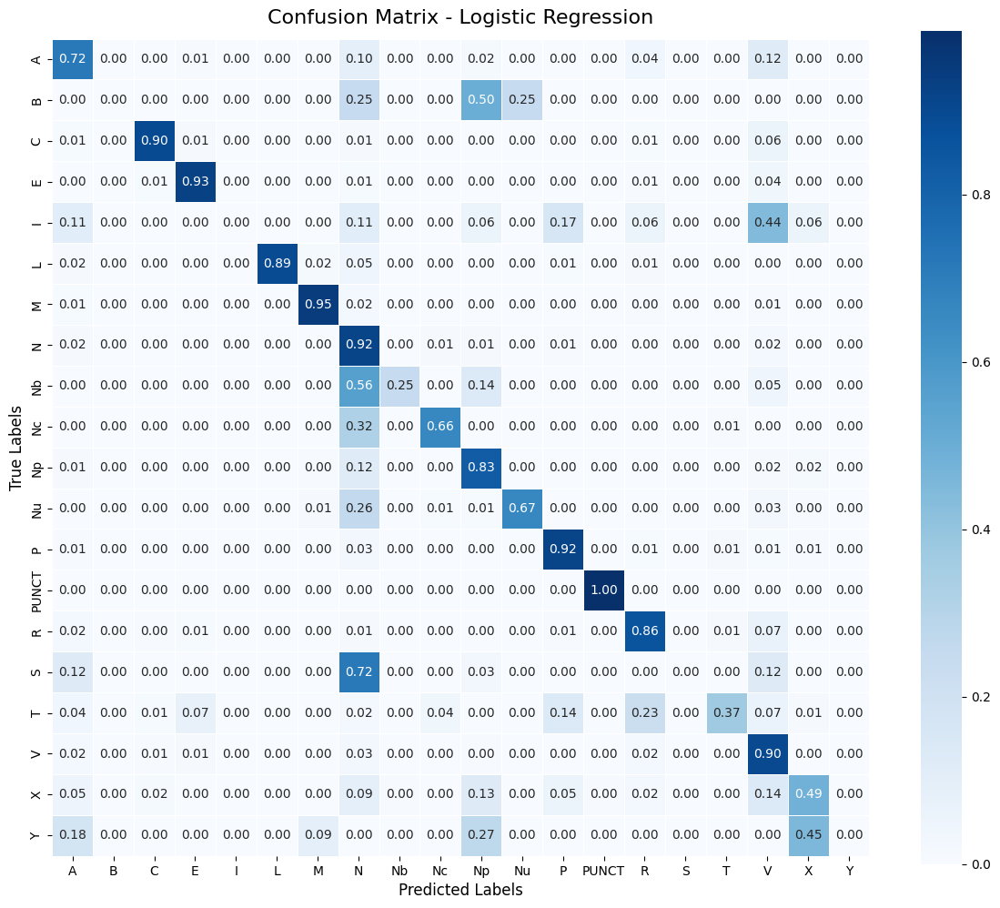

              precision    recall  f1-score   support

           A       0.78      0.72      0.75      2685
           B       0.00      0.00      0.00         4
           C       0.92      0.90      0.91      1578
           E       0.92      0.93      0.92      2708
           I       0.00      0.00      0.00        18
           L       0.97      0.89      0.93       787
           M       0.97      0.95      0.96      1617
           N       0.86      0.92      0.89     10308
          Nb       0.87      0.25      0.39        80
          Nc       0.81      0.66      0.73      1090
          Np       0.83      0.83      0.83      1703
          Nu       0.92      0.67      0.77       206
           P       0.90      0.92      0.91      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.86      0.86      0.86      3164
           S       0.00      0.00      0.00        32
           T       0.57      0.37      0.45       281
           V       0.87    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test)

### MLP

Train samples: 174002, Test samples: 43501
Train batches: 5438, Test batches: 680


Epoch 1/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.1041 | Test Loss=1.4343 | Test Acc=0.5877
New best model saved (test_acc=0.5877)


Epoch 2/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.0990 | Test Loss=0.7939 | Test Acc=0.8032
New best model saved (test_acc=0.8032)


Epoch 3/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.6763 | Test Loss=0.5380 | Test Acc=0.8527
New best model saved (test_acc=0.8527)


Epoch 4/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.5164 | Test Loss=0.4441 | Test Acc=0.8688
New best model saved (test_acc=0.8688)


Epoch 5/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.4500 | Test Loss=0.4010 | Test Acc=0.8778
New best model saved (test_acc=0.8778)


Epoch 6/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.4158 | Test Loss=0.3757 | Test Acc=0.8832
New best model saved (test_acc=0.8832)


Epoch 7/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.3924 | Test Loss=0.3576 | Test Acc=0.8877
New best model saved (test_acc=0.8877)


Epoch 8/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.3756 | Test Loss=0.3438 | Test Acc=0.8921
New best model saved (test_acc=0.8921)


Epoch 9/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.3609 | Test Loss=0.3329 | Test Acc=0.8955
New best model saved (test_acc=0.8955)


Epoch 10/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.3516 | Test Loss=0.3237 | Test Acc=0.8978
New best model saved (test_acc=0.8978)


Epoch 11/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.3413 | Test Loss=0.3162 | Test Acc=0.9000
New best model saved (test_acc=0.9000)


Epoch 12/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.3328 | Test Loss=0.3097 | Test Acc=0.9012
New best model saved (test_acc=0.9012)


Epoch 13/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.3259 | Test Loss=0.3042 | Test Acc=0.9025
New best model saved (test_acc=0.9025)


Epoch 14/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.3203 | Test Loss=0.2994 | Test Acc=0.9034
New best model saved (test_acc=0.9034)


Epoch 15/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.3131 | Test Loss=0.2950 | Test Acc=0.9043
New best model saved (test_acc=0.9043)


Epoch 16/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.3081 | Test Loss=0.2909 | Test Acc=0.9049
New best model saved (test_acc=0.9049)


Epoch 17/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.3034 | Test Loss=0.2874 | Test Acc=0.9061
New best model saved (test_acc=0.9061)


Epoch 18/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.2989 | Test Loss=0.2840 | Test Acc=0.9069
New best model saved (test_acc=0.9069)


Epoch 19/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.2956 | Test Loss=0.2810 | Test Acc=0.9075
New best model saved (test_acc=0.9075)


Epoch 20/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.2913 | Test Loss=0.2781 | Test Acc=0.9082
New best model saved (test_acc=0.9082)


Epoch 21/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.2872 | Test Loss=0.2756 | Test Acc=0.9085
New best model saved (test_acc=0.9085)


Epoch 22/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.2840 | Test Loss=0.2731 | Test Acc=0.9095
New best model saved (test_acc=0.9095)


Epoch 23/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.2813 | Test Loss=0.2705 | Test Acc=0.9100
New best model saved (test_acc=0.9100)


Epoch 24/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.2786 | Test Loss=0.2682 | Test Acc=0.9110
New best model saved (test_acc=0.9110)


Epoch 25/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.2760 | Test Loss=0.2660 | Test Acc=0.9110


Epoch 26/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.2720 | Test Loss=0.2637 | Test Acc=0.9115
New best model saved (test_acc=0.9115)


Epoch 27/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.2711 | Test Loss=0.2620 | Test Acc=0.9124
New best model saved (test_acc=0.9124)


Epoch 28/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.2672 | Test Loss=0.2600 | Test Acc=0.9127
New best model saved (test_acc=0.9127)


Epoch 29/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.2652 | Test Loss=0.2582 | Test Acc=0.9132
New best model saved (test_acc=0.9132)


Epoch 30/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.2617 | Test Loss=0.2566 | Test Acc=0.9135
New best model saved (test_acc=0.9135)


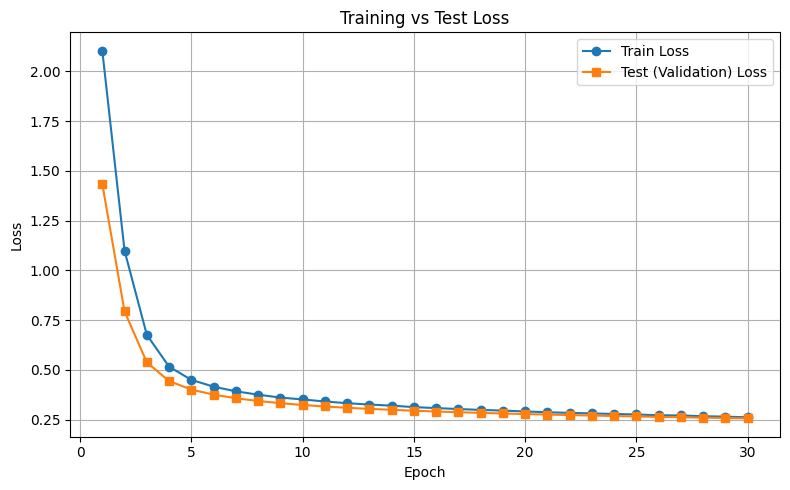

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/680 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.9135


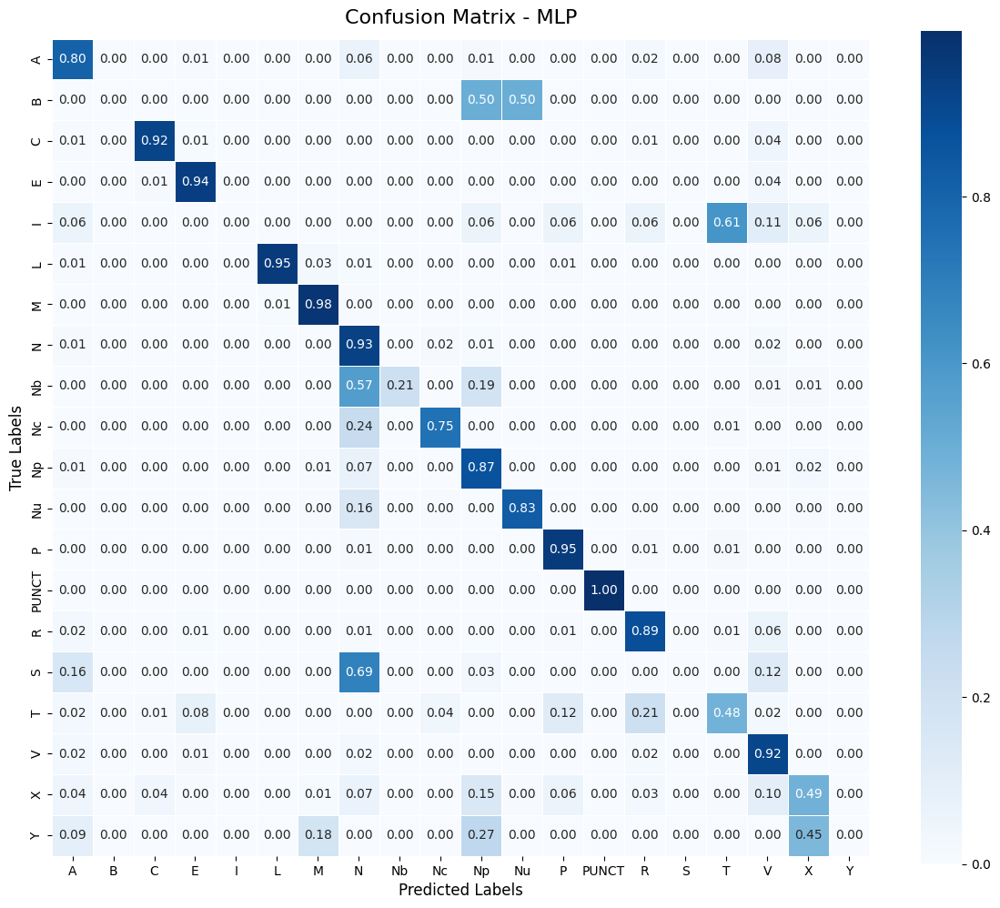

              precision    recall  f1-score   support

           A       0.81      0.80      0.81      2685
           B       0.00      0.00      0.00         4
           C       0.93      0.92      0.93      1578
           E       0.92      0.94      0.93      2708
           I       0.00      0.00      0.00        18
           L       0.97      0.95      0.96       787
           M       0.96      0.98      0.97      1617
           N       0.91      0.93      0.92     10308
          Nb       0.89      0.21      0.34        80
          Nc       0.82      0.75      0.78      1090
          Np       0.86      0.87      0.86      1703
          Nu       0.83      0.83      0.83       206
           P       0.93      0.95      0.94      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.90      0.89      0.89      3164
           S       0.00      0.00      0.00        32
           T       0.63      0.48      0.54       281
           V       0.90    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1])

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251
Decomposed data (By PCA)
Train shape: (152252, 256), Test shape: (65251, 256)


### Naive Bayes

Fitting
Predicting


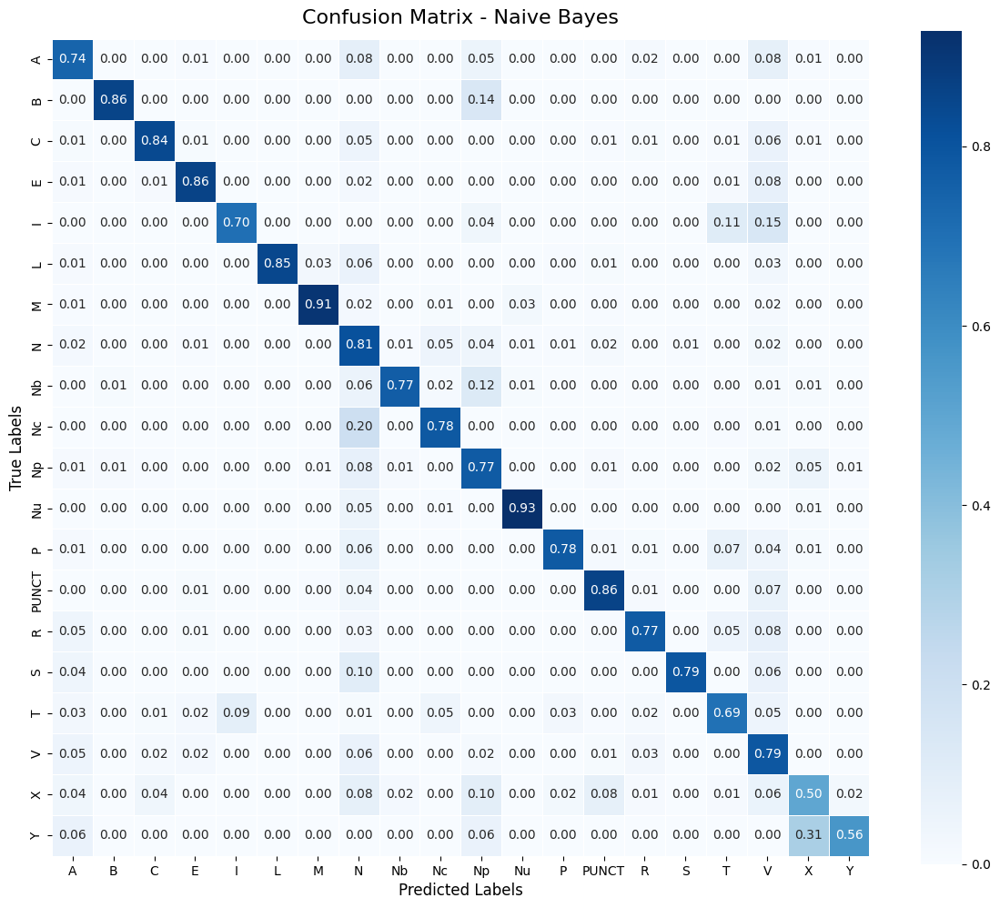

              precision    recall  f1-score   support

           A       0.69      0.74      0.71      4027
           B       0.14      0.86      0.24         7
           C       0.86      0.84      0.85      2367
           E       0.86      0.86      0.86      4061
           I       0.28      0.70      0.40        27
           L       1.00      0.85      0.92      1180
           M       0.95      0.91      0.93      2425
           N       0.82      0.81      0.81     15462
          Nb       0.32      0.77      0.45       121
          Nc       0.61      0.78      0.68      1634
          Np       0.63      0.77      0.69      2555
          Nu       0.65      0.93      0.76       310
           P       0.94      0.78      0.85      2779
       PUNCT       0.93      0.86      0.90      9632
           R       0.85      0.77      0.81      4746
           S       0.28      0.79      0.41        48
           T       0.34      0.69      0.46       422
           V       0.80    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test)

### Softmax Regression

Fitting
Predicting


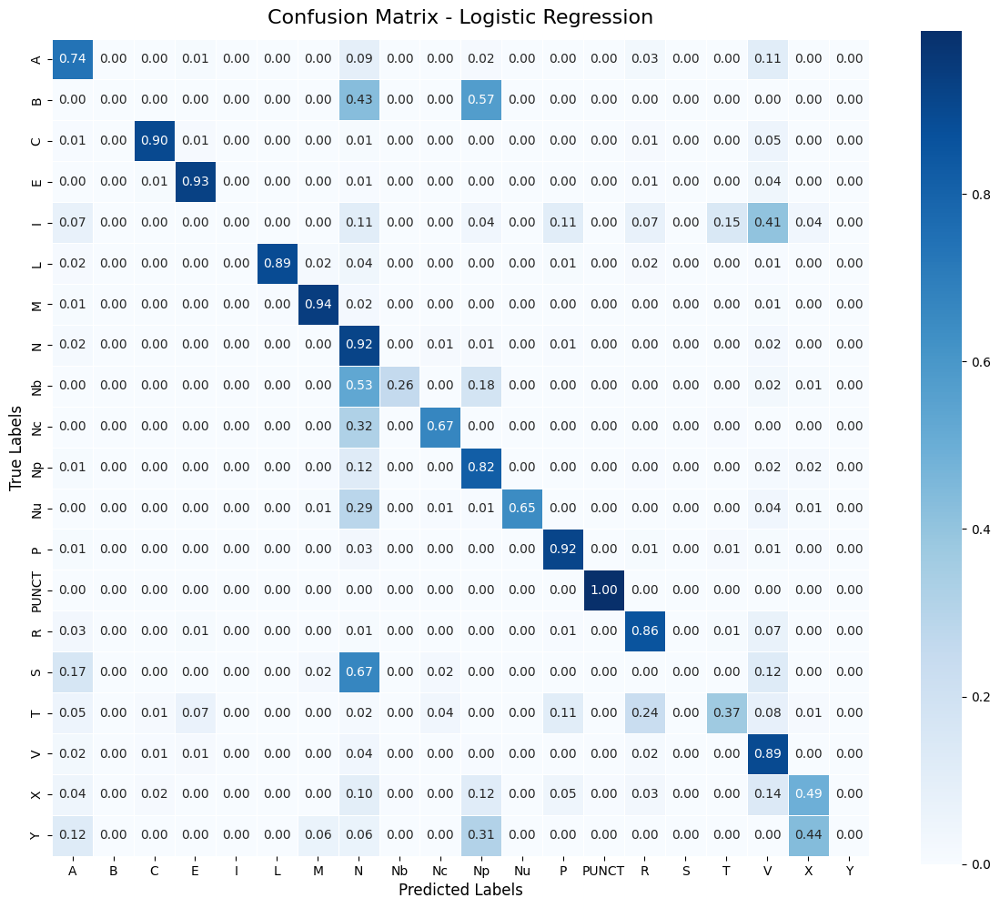

              precision    recall  f1-score   support

           A       0.77      0.74      0.75      4027
           B       0.00      0.00      0.00         7
           C       0.93      0.90      0.91      2367
           E       0.92      0.93      0.92      4061
           I       0.00      0.00      0.00        27
           L       0.97      0.89      0.93      1180
           M       0.97      0.94      0.96      2425
           N       0.86      0.92      0.89     15462
          Nb       0.86      0.26      0.39       121
          Nc       0.81      0.67      0.73      1634
          Np       0.83      0.82      0.83      2555
          Nu       0.92      0.65      0.76       310
           P       0.91      0.92      0.91      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.87      0.86      0.86      4746
           S       0.00      0.00      0.00        48
           T       0.57      0.37      0.45       422
           V       0.87    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test)

### MLP

Train samples: 152252, Test samples: 65251
Train batches: 4758, Test batches: 1020


Epoch 1/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.1724 | Test Loss=1.5223 | Test Acc=0.5606
New best model saved (test_acc=0.5606)


Epoch 2/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.1997 | Test Loss=0.9009 | Test Acc=0.7478
New best model saved (test_acc=0.7478)


Epoch 3/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.7614 | Test Loss=0.6019 | Test Acc=0.8460
New best model saved (test_acc=0.8460)


Epoch 4/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.5627 | Test Loss=0.4762 | Test Acc=0.8666
New best model saved (test_acc=0.8666)


Epoch 5/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.4760 | Test Loss=0.4212 | Test Acc=0.8757
New best model saved (test_acc=0.8757)


Epoch 6/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.4343 | Test Loss=0.3907 | Test Acc=0.8811
New best model saved (test_acc=0.8811)


Epoch 7/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.4071 | Test Loss=0.3709 | Test Acc=0.8848
New best model saved (test_acc=0.8848)


Epoch 8/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.3893 | Test Loss=0.3556 | Test Acc=0.8883
New best model saved (test_acc=0.8883)


Epoch 9/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.3741 | Test Loss=0.3434 | Test Acc=0.8918
New best model saved (test_acc=0.8918)


Epoch 10/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.3616 | Test Loss=0.3331 | Test Acc=0.8948
New best model saved (test_acc=0.8948)


Epoch 11/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.3500 | Test Loss=0.3247 | Test Acc=0.8973
New best model saved (test_acc=0.8973)


Epoch 12/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.3410 | Test Loss=0.3175 | Test Acc=0.8990
New best model saved (test_acc=0.8990)


Epoch 13/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.3330 | Test Loss=0.3113 | Test Acc=0.9004
New best model saved (test_acc=0.9004)


Epoch 14/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.3266 | Test Loss=0.3060 | Test Acc=0.9020
New best model saved (test_acc=0.9020)


Epoch 15/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.3212 | Test Loss=0.3015 | Test Acc=0.9031
New best model saved (test_acc=0.9031)


Epoch 16/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.3157 | Test Loss=0.2976 | Test Acc=0.9040
New best model saved (test_acc=0.9040)


Epoch 17/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.3099 | Test Loss=0.2939 | Test Acc=0.9046
New best model saved (test_acc=0.9046)


Epoch 18/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.3054 | Test Loss=0.2905 | Test Acc=0.9057
New best model saved (test_acc=0.9057)


Epoch 19/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.3012 | Test Loss=0.2871 | Test Acc=0.9070
New best model saved (test_acc=0.9070)


Epoch 20/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.2977 | Test Loss=0.2843 | Test Acc=0.9072
New best model saved (test_acc=0.9072)


Epoch 21/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.2938 | Test Loss=0.2818 | Test Acc=0.9079
New best model saved (test_acc=0.9079)


Epoch 22/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.2915 | Test Loss=0.2792 | Test Acc=0.9085
New best model saved (test_acc=0.9085)


Epoch 23/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.2866 | Test Loss=0.2768 | Test Acc=0.9091
New best model saved (test_acc=0.9091)


Epoch 24/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.2838 | Test Loss=0.2747 | Test Acc=0.9098
New best model saved (test_acc=0.9098)


Epoch 25/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.2799 | Test Loss=0.2725 | Test Acc=0.9104
New best model saved (test_acc=0.9104)


Epoch 26/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.2775 | Test Loss=0.2704 | Test Acc=0.9111
New best model saved (test_acc=0.9111)


Epoch 27/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.2749 | Test Loss=0.2685 | Test Acc=0.9113
New best model saved (test_acc=0.9113)


Epoch 28/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.2731 | Test Loss=0.2667 | Test Acc=0.9118
New best model saved (test_acc=0.9118)


Epoch 29/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.2696 | Test Loss=0.2650 | Test Acc=0.9124
New best model saved (test_acc=0.9124)


Epoch 30/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.2672 | Test Loss=0.2633 | Test Acc=0.9128
New best model saved (test_acc=0.9128)


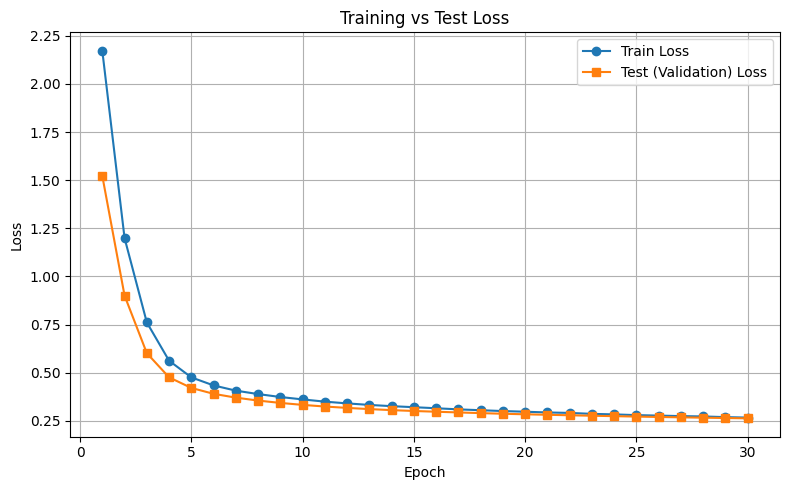

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1020 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.9128


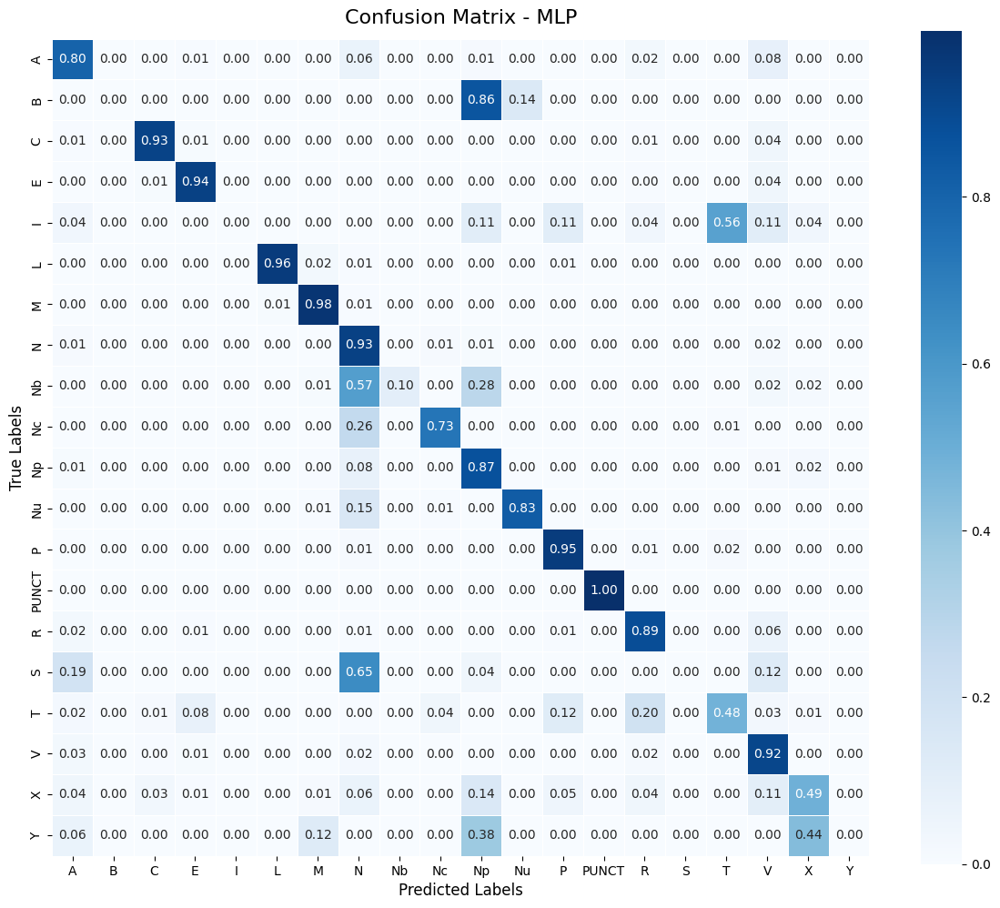

              precision    recall  f1-score   support

           A       0.81      0.80      0.81      4027
           B       0.00      0.00      0.00         7
           C       0.93      0.93      0.93      2367
           E       0.93      0.94      0.93      4061
           I       0.00      0.00      0.00        27
           L       0.96      0.96      0.96      1180
           M       0.96      0.98      0.97      2425
           N       0.91      0.93      0.92     15462
          Nb       0.92      0.10      0.18       121
          Nc       0.83      0.73      0.78      1634
          Np       0.85      0.87      0.86      2555
          Nu       0.84      0.83      0.83       310
           P       0.94      0.95      0.94      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.90      0.89      0.89      4746
           S       0.00      0.00      0.00        48
           T       0.65      0.48      0.56       422
           V       0.90    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1])

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002
Decomposed data (By PCA)
Train shape: (130501, 256), Test shape: (87002, 256)


### Naive Bayes

Fitting
Predicting


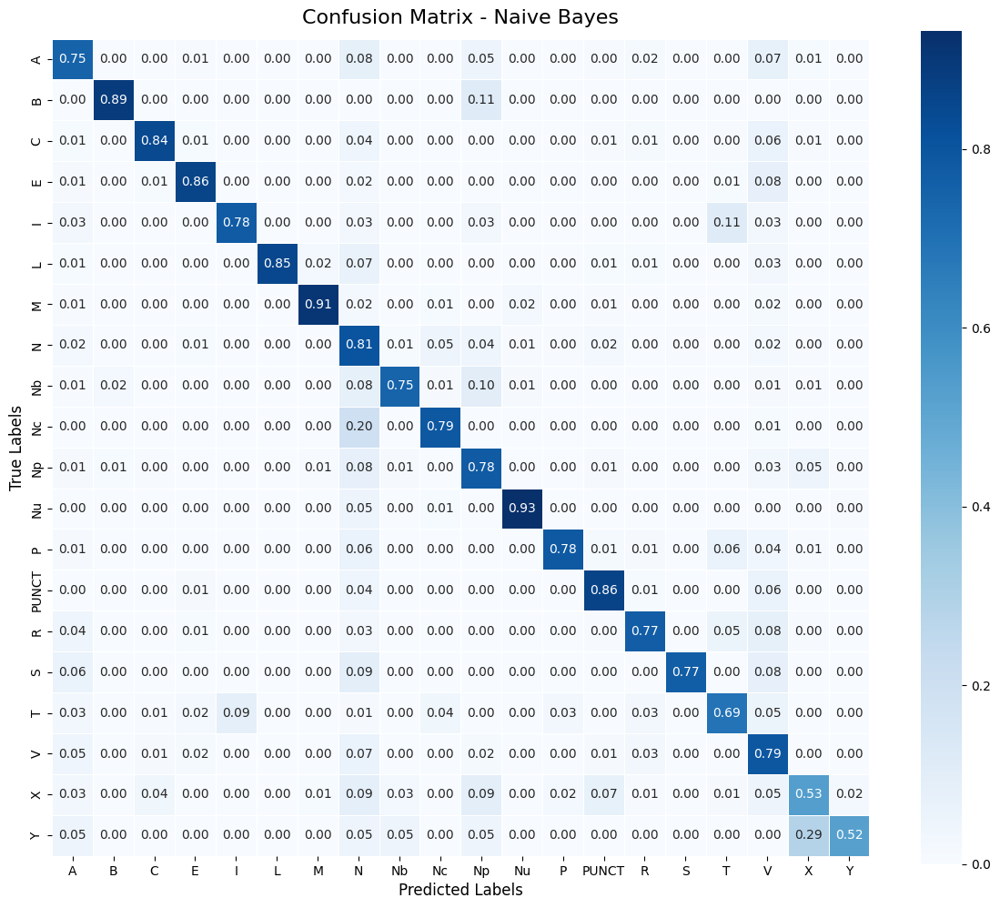

              precision    recall  f1-score   support

           A       0.70      0.75      0.72      5370
           B       0.19      0.89      0.31         9
           C       0.87      0.84      0.85      3156
           E       0.86      0.86      0.86      5415
           I       0.32      0.78      0.46        36
           L       0.99      0.85      0.92      1574
           M       0.96      0.91      0.93      3233
           N       0.82      0.81      0.81     20616
          Nb       0.29      0.75      0.42       161
          Nc       0.61      0.79      0.69      2179
          Np       0.63      0.78      0.70      3406
          Nu       0.65      0.93      0.76       413
           P       0.95      0.78      0.86      3705
       PUNCT       0.93      0.86      0.90     12843
           R       0.85      0.77      0.81      6328
           S       0.30      0.77      0.43        64
           T       0.34      0.69      0.46       563
           V       0.81    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test)

### Softmax Regression

Fitting
Predicting


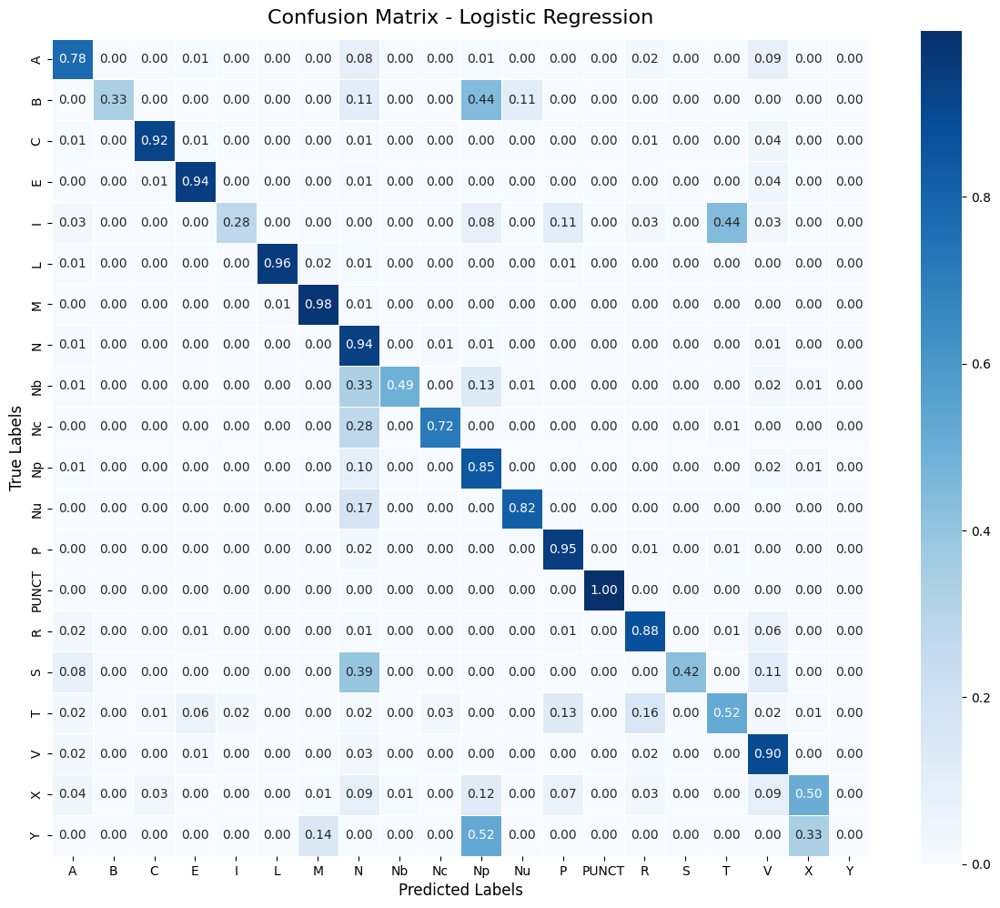

              precision    recall  f1-score   support

           A       0.81      0.78      0.80      5370
           B       0.60      0.33      0.43         9
           C       0.93      0.92      0.93      3156
           E       0.92      0.94      0.93      5415
           I       0.43      0.28      0.34        36
           L       0.96      0.96      0.96      1574
           M       0.97      0.98      0.98      3233
           N       0.89      0.94      0.91     20616
          Nb       0.72      0.49      0.59       161
          Nc       0.84      0.72      0.77      2179
          Np       0.86      0.85      0.86      3406
          Nu       0.90      0.82      0.86       413
           P       0.92      0.95      0.94      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.90      0.88      0.89      6328
           S       0.90      0.42      0.57        64
           T       0.67      0.52      0.58       563
           V       0.90    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test)

### MLP

Train samples: 130501, Test samples: 87002
Train batches: 4079, Test batches: 1360


Epoch 1/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.2518 | Test Loss=1.6218 | Test Acc=0.5437
New best model saved (test_acc=0.5437)


Epoch 2/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.3115 | Test Loss=1.0199 | Test Acc=0.7010
New best model saved (test_acc=0.7010)


Epoch 3/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.8732 | Test Loss=0.7036 | Test Acc=0.8150
New best model saved (test_acc=0.8150)


Epoch 4/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.6472 | Test Loss=0.5421 | Test Acc=0.8528
New best model saved (test_acc=0.8528)


Epoch 5/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.5321 | Test Loss=0.4624 | Test Acc=0.8675
New best model saved (test_acc=0.8675)


Epoch 6/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.4729 | Test Loss=0.4196 | Test Acc=0.8756
New best model saved (test_acc=0.8756)


Epoch 7/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.4366 | Test Loss=0.3934 | Test Acc=0.8808
New best model saved (test_acc=0.8808)


Epoch 8/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.4146 | Test Loss=0.3750 | Test Acc=0.8848
New best model saved (test_acc=0.8848)


Epoch 9/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.3961 | Test Loss=0.3613 | Test Acc=0.8876
New best model saved (test_acc=0.8876)


Epoch 10/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.3828 | Test Loss=0.3499 | Test Acc=0.8904
New best model saved (test_acc=0.8904)


Epoch 11/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.3694 | Test Loss=0.3401 | Test Acc=0.8932
New best model saved (test_acc=0.8932)


Epoch 12/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.3599 | Test Loss=0.3320 | Test Acc=0.8955
New best model saved (test_acc=0.8955)


Epoch 13/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.3524 | Test Loss=0.3246 | Test Acc=0.8979
New best model saved (test_acc=0.8979)


Epoch 14/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.3450 | Test Loss=0.3182 | Test Acc=0.8997
New best model saved (test_acc=0.8997)


Epoch 15/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.3374 | Test Loss=0.3126 | Test Acc=0.9012
New best model saved (test_acc=0.9012)


Epoch 16/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.3310 | Test Loss=0.3075 | Test Acc=0.9025
New best model saved (test_acc=0.9025)


Epoch 17/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.3253 | Test Loss=0.3031 | Test Acc=0.9036
New best model saved (test_acc=0.9036)


Epoch 18/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.3194 | Test Loss=0.2990 | Test Acc=0.9047
New best model saved (test_acc=0.9047)


Epoch 19/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.3149 | Test Loss=0.2955 | Test Acc=0.9053
New best model saved (test_acc=0.9053)


Epoch 20/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.3096 | Test Loss=0.2922 | Test Acc=0.9061
New best model saved (test_acc=0.9061)


Epoch 21/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.3066 | Test Loss=0.2891 | Test Acc=0.9070
New best model saved (test_acc=0.9070)


Epoch 22/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.3028 | Test Loss=0.2864 | Test Acc=0.9078
New best model saved (test_acc=0.9078)


Epoch 23/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.2989 | Test Loss=0.2838 | Test Acc=0.9084
New best model saved (test_acc=0.9084)


Epoch 24/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.2941 | Test Loss=0.2812 | Test Acc=0.9089
New best model saved (test_acc=0.9089)


Epoch 25/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.2923 | Test Loss=0.2789 | Test Acc=0.9096
New best model saved (test_acc=0.9096)


Epoch 26/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.2881 | Test Loss=0.2768 | Test Acc=0.9101
New best model saved (test_acc=0.9101)


Epoch 27/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.2864 | Test Loss=0.2748 | Test Acc=0.9106
New best model saved (test_acc=0.9106)


Epoch 28/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.2833 | Test Loss=0.2728 | Test Acc=0.9111
New best model saved (test_acc=0.9111)


Epoch 29/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.2804 | Test Loss=0.2710 | Test Acc=0.9115
New best model saved (test_acc=0.9115)


Epoch 30/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.2777 | Test Loss=0.2692 | Test Acc=0.9121
New best model saved (test_acc=0.9121)


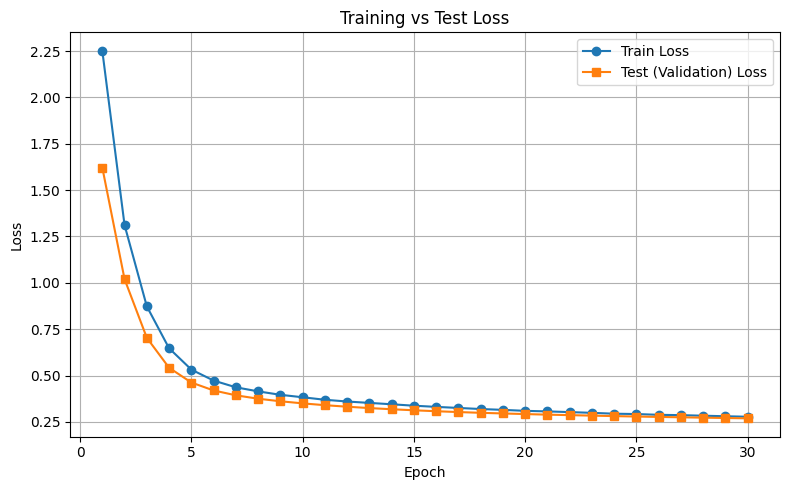

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1360 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.9121


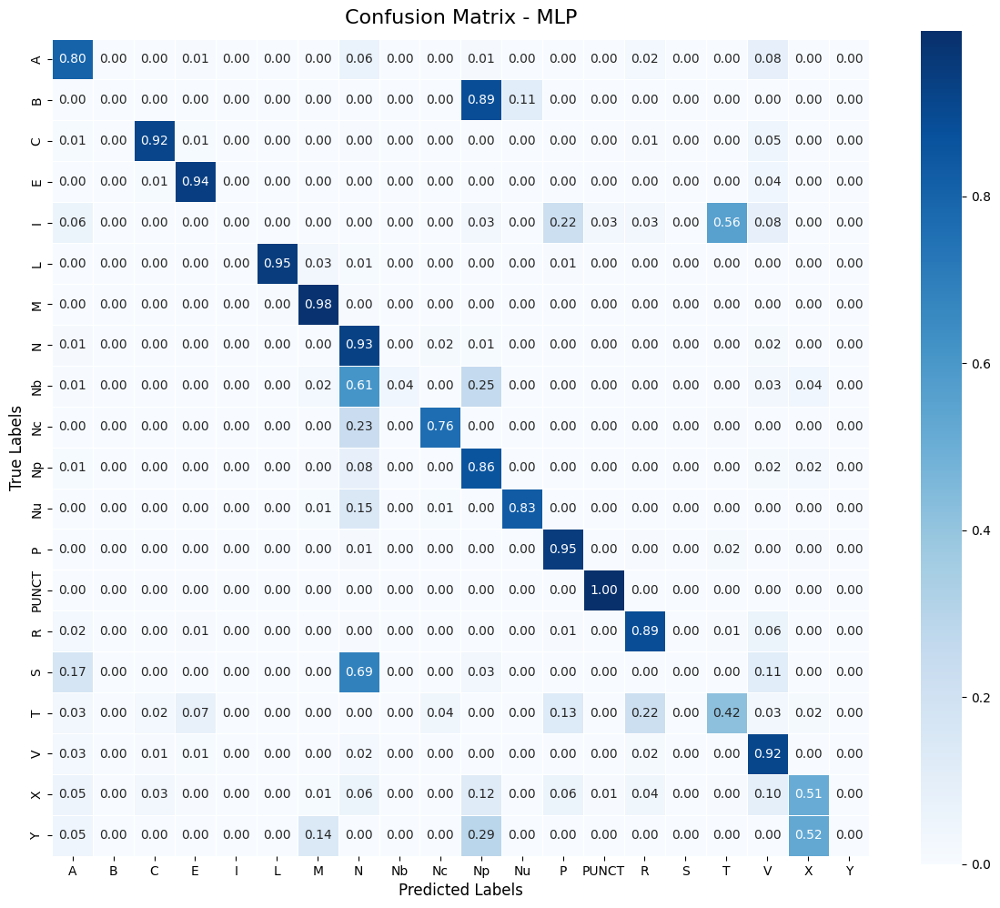

              precision    recall  f1-score   support

           A       0.81      0.80      0.80      5370
           B       0.00      0.00      0.00         9
           C       0.93      0.92      0.92      3156
           E       0.93      0.94      0.94      5415
           I       0.00      0.00      0.00        36
           L       0.97      0.95      0.96      1574
           M       0.96      0.98      0.97      3233
           N       0.91      0.93      0.92     20616
          Nb       1.00      0.04      0.07       161
          Nc       0.82      0.76      0.79      2179
          Np       0.85      0.86      0.86      3406
          Nu       0.84      0.83      0.84       413
           P       0.93      0.95      0.94      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.90      0.89      0.89      6328
           S       0.00      0.00      0.00        64
           T       0.60      0.42      0.49       563
           V       0.90    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1])

# Run classification - 64D

In [ ]:
N_COMPONENTS_PCA_MODEL = 64

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501
Decomposed data (By PCA)
Train shape: (174002, 64), Test shape: (43501, 64)


### Naive Bayes

Fitting
Predicting


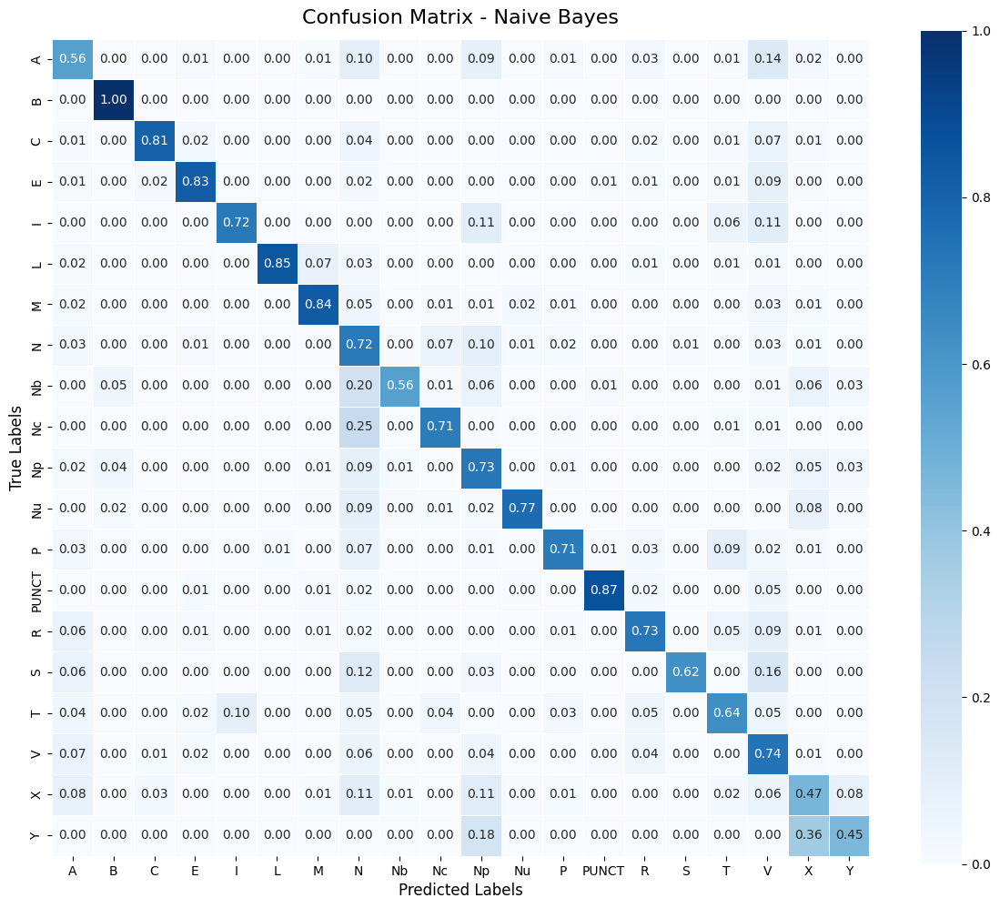

              precision    recall  f1-score   support

           A       0.54      0.56      0.55      2685
           B       0.05      1.00      0.09         4
           C       0.88      0.81      0.84      1578
           E       0.83      0.83      0.83      2708
           I       0.28      0.72      0.40        18
           L       0.96      0.85      0.90       787
           M       0.84      0.84      0.84      1617
           N       0.80      0.72      0.76     10308
          Nb       0.33      0.56      0.42        80
          Nc       0.51      0.71      0.59      1090
          Np       0.42      0.73      0.53      1703
          Nu       0.48      0.77      0.59       206
           P       0.82      0.71      0.76      1853
       PUNCT       0.98      0.87      0.92      6421
           R       0.76      0.73      0.74      3164
           S       0.25      0.62      0.35        32
           T       0.26      0.64      0.37       281
           V       0.78    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test)

### Softmax Regression

Fitting
Predicting


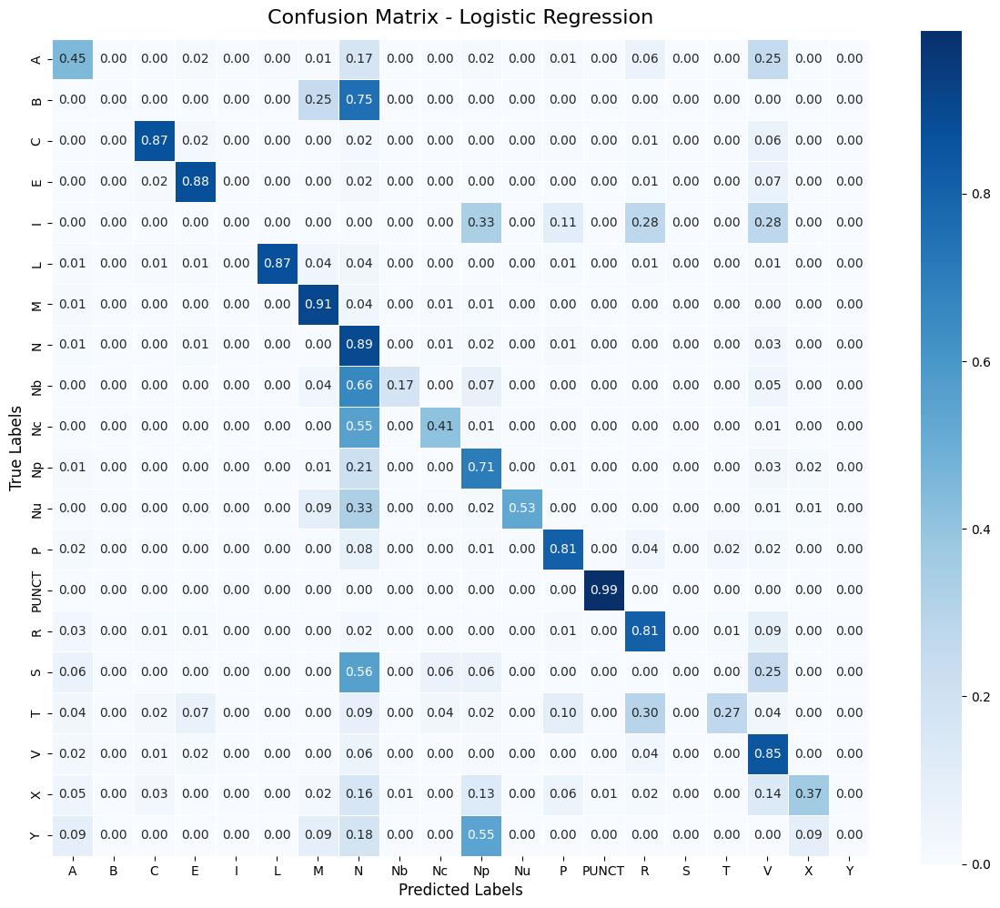

              precision    recall  f1-score   support

           A       0.69      0.45      0.54      2685
           B       0.00      0.00      0.00         4
           C       0.88      0.87      0.88      1578
           E       0.86      0.88      0.87      2708
           I       0.00      0.00      0.00        18
           L       0.95      0.87      0.91       787
           M       0.90      0.91      0.90      1617
           N       0.78      0.89      0.83     10308
          Nb       0.52      0.17      0.26        80
          Nc       0.78      0.41      0.54      1090
          Np       0.75      0.71      0.73      1703
          Nu       0.78      0.53      0.63       206
           P       0.82      0.81      0.81      1853
       PUNCT       1.00      0.99      1.00      6421
           R       0.78      0.81      0.79      3164
           S       0.00      0.00      0.00        32
           T       0.43      0.27      0.33       281
           V       0.80    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test)

### MLP

Train samples: 174002, Test samples: 43501
Train batches: 5438, Test batches: 680


Epoch 1/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.0208 | Test Loss=1.3853 | Test Acc=0.6088
New best model saved (test_acc=0.6088)


Epoch 2/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.1285 | Test Loss=0.8788 | Test Acc=0.7547
New best model saved (test_acc=0.7547)


Epoch 3/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.8076 | Test Loss=0.6788 | Test Acc=0.8034
New best model saved (test_acc=0.8034)


Epoch 4/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.6755 | Test Loss=0.5909 | Test Acc=0.8215
New best model saved (test_acc=0.8215)


Epoch 5/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.6102 | Test Loss=0.5443 | Test Acc=0.8331
New best model saved (test_acc=0.8331)


Epoch 6/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.5731 | Test Loss=0.5157 | Test Acc=0.8386
New best model saved (test_acc=0.8386)


Epoch 7/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.5473 | Test Loss=0.4954 | Test Acc=0.8428
New best model saved (test_acc=0.8428)


Epoch 8/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5292 | Test Loss=0.4803 | Test Acc=0.8466
New best model saved (test_acc=0.8466)


Epoch 9/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5141 | Test Loss=0.4677 | Test Acc=0.8497
New best model saved (test_acc=0.8497)


Epoch 10/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5010 | Test Loss=0.4570 | Test Acc=0.8523
New best model saved (test_acc=0.8523)


Epoch 11/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.4914 | Test Loss=0.4478 | Test Acc=0.8546
New best model saved (test_acc=0.8546)


Epoch 12/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4818 | Test Loss=0.4395 | Test Acc=0.8565
New best model saved (test_acc=0.8565)


Epoch 13/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4735 | Test Loss=0.4323 | Test Acc=0.8589
New best model saved (test_acc=0.8589)


Epoch 14/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4649 | Test Loss=0.4258 | Test Acc=0.8608
New best model saved (test_acc=0.8608)


Epoch 15/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4582 | Test Loss=0.4197 | Test Acc=0.8628
New best model saved (test_acc=0.8628)


Epoch 16/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4509 | Test Loss=0.4141 | Test Acc=0.8639
New best model saved (test_acc=0.8639)


Epoch 17/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4455 | Test Loss=0.4090 | Test Acc=0.8660
New best model saved (test_acc=0.8660)


Epoch 18/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4408 | Test Loss=0.4042 | Test Acc=0.8669
New best model saved (test_acc=0.8669)


Epoch 19/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4347 | Test Loss=0.3997 | Test Acc=0.8681
New best model saved (test_acc=0.8681)


Epoch 20/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.4315 | Test Loss=0.3955 | Test Acc=0.8697
New best model saved (test_acc=0.8697)


Epoch 21/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.4263 | Test Loss=0.3918 | Test Acc=0.8705
New best model saved (test_acc=0.8705)


Epoch 22/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.4216 | Test Loss=0.3879 | Test Acc=0.8712
New best model saved (test_acc=0.8712)


Epoch 23/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.4179 | Test Loss=0.3845 | Test Acc=0.8724
New best model saved (test_acc=0.8724)


Epoch 24/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.4136 | Test Loss=0.3811 | Test Acc=0.8736
New best model saved (test_acc=0.8736)


Epoch 25/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.4105 | Test Loss=0.3779 | Test Acc=0.8746
New best model saved (test_acc=0.8746)


Epoch 26/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.4065 | Test Loss=0.3749 | Test Acc=0.8754
New best model saved (test_acc=0.8754)


Epoch 27/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.4037 | Test Loss=0.3719 | Test Acc=0.8767
New best model saved (test_acc=0.8767)


Epoch 28/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3999 | Test Loss=0.3691 | Test Acc=0.8768
New best model saved (test_acc=0.8768)


Epoch 29/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3975 | Test Loss=0.3664 | Test Acc=0.8783
New best model saved (test_acc=0.8783)


Epoch 30/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3943 | Test Loss=0.3637 | Test Acc=0.8790
New best model saved (test_acc=0.8790)


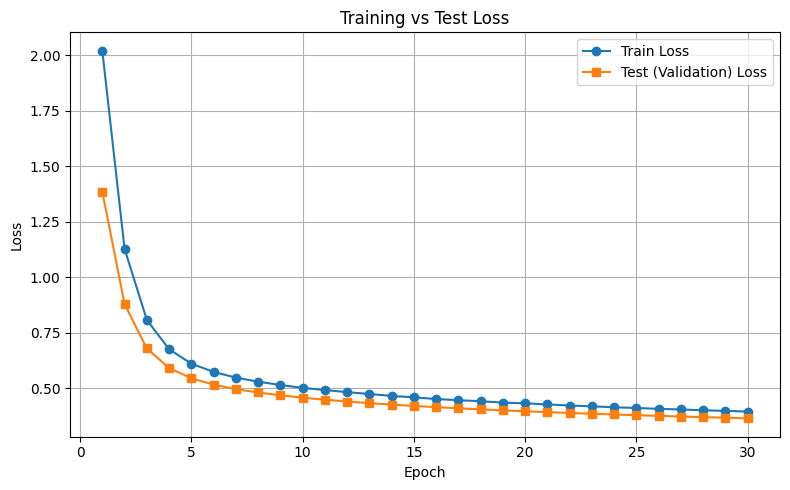

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/680 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8790


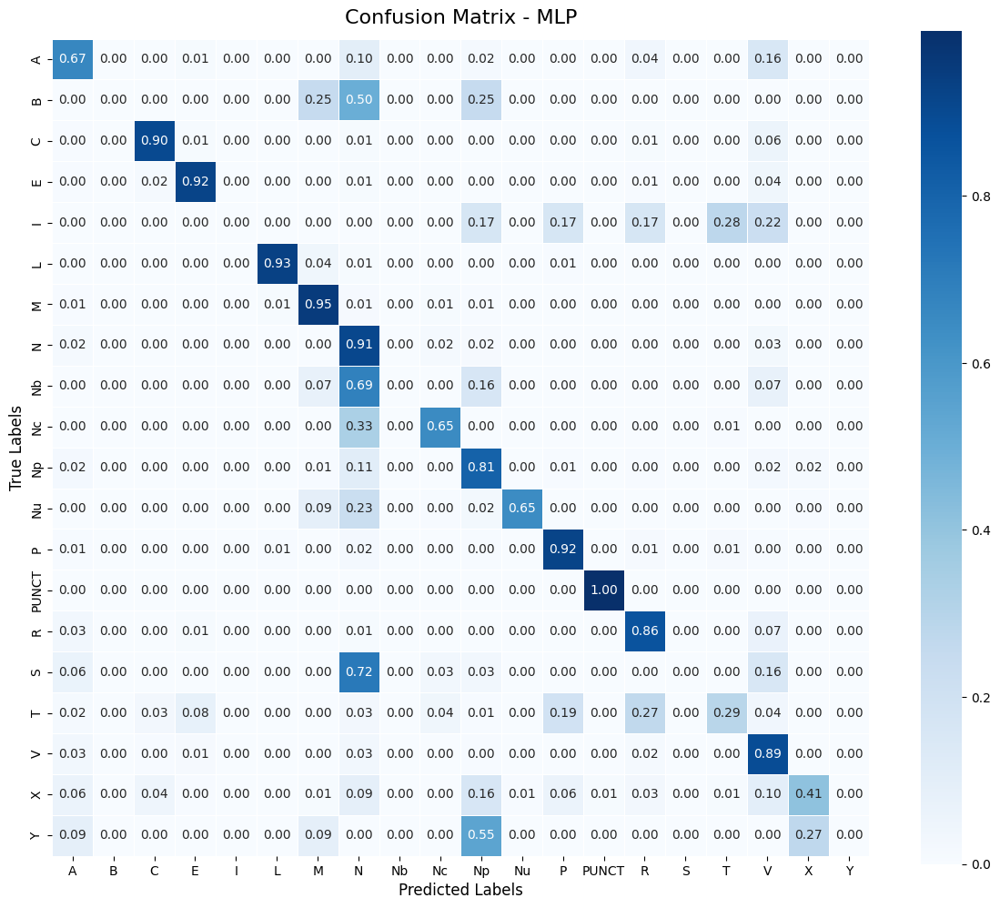

              precision    recall  f1-score   support

           A       0.72      0.67      0.69      2685
           B       0.00      0.00      0.00         4
           C       0.91      0.90      0.91      1578
           E       0.91      0.92      0.91      2708
           I       0.00      0.00      0.00        18
           L       0.94      0.93      0.94       787
           M       0.92      0.95      0.94      1617
           N       0.87      0.91      0.89     10308
          Nb       0.00      0.00      0.00        80
          Nc       0.78      0.65      0.71      1090
          Np       0.79      0.81      0.80      1703
          Nu       0.82      0.65      0.72       206
           P       0.91      0.92      0.92      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.87      0.86      0.86      3164
           S       0.00      0.00      0.00        32
           T       0.55      0.29      0.38       281
           V       0.86    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1])

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251
Decomposed data (By PCA)
Train shape: (152252, 64), Test shape: (65251, 64)


### Naive Bayes

Fitting
Predicting


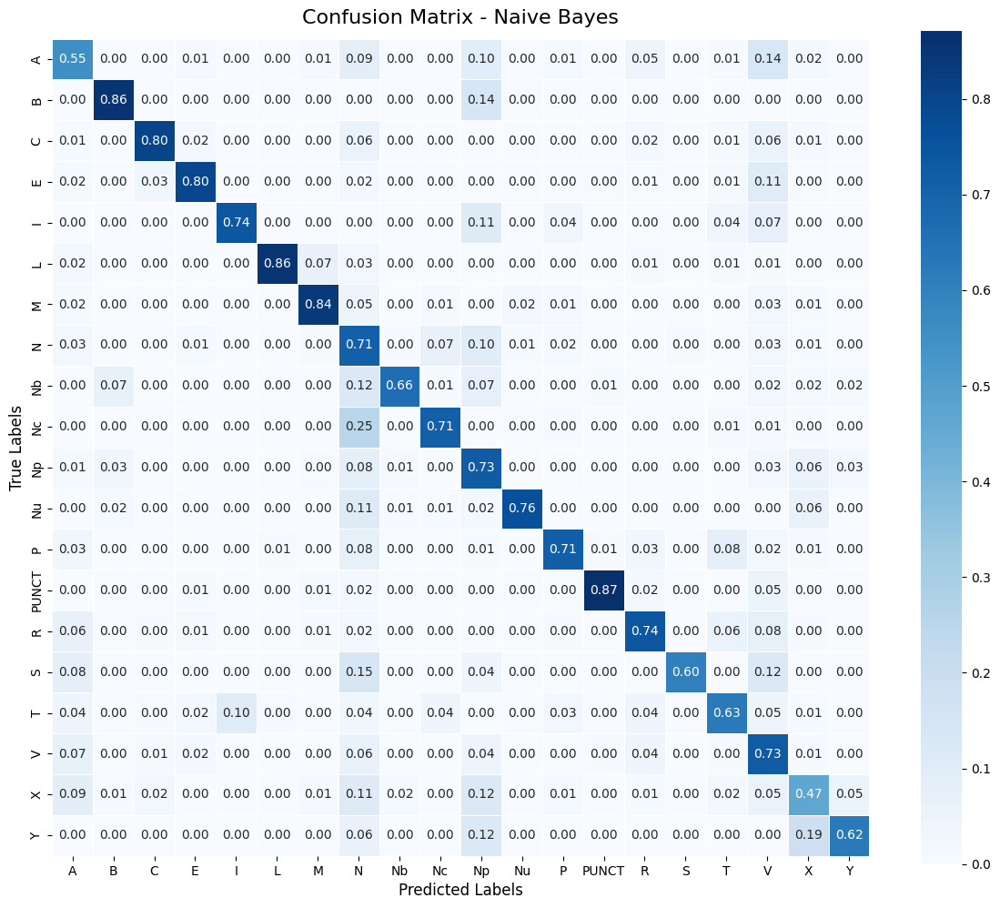

              precision    recall  f1-score   support

           A       0.53      0.55      0.54      4027
           B       0.05      0.86      0.09         7
           C       0.84      0.80      0.82      2367
           E       0.81      0.80      0.80      4061
           I       0.28      0.74      0.40        27
           L       0.96      0.86      0.91      1180
           M       0.83      0.84      0.83      2425
           N       0.79      0.71      0.75     15462
          Nb       0.37      0.66      0.48       121
          Nc       0.51      0.71      0.59      1634
          Np       0.41      0.73      0.53      2555
          Nu       0.51      0.76      0.61       310
           P       0.82      0.71      0.76      2779
       PUNCT       0.98      0.87      0.92      9632
           R       0.75      0.74      0.75      4746
           S       0.27      0.60      0.37        48
           T       0.26      0.63      0.37       422
           V       0.77    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test)

### Softmax Regression

Fitting
Predicting


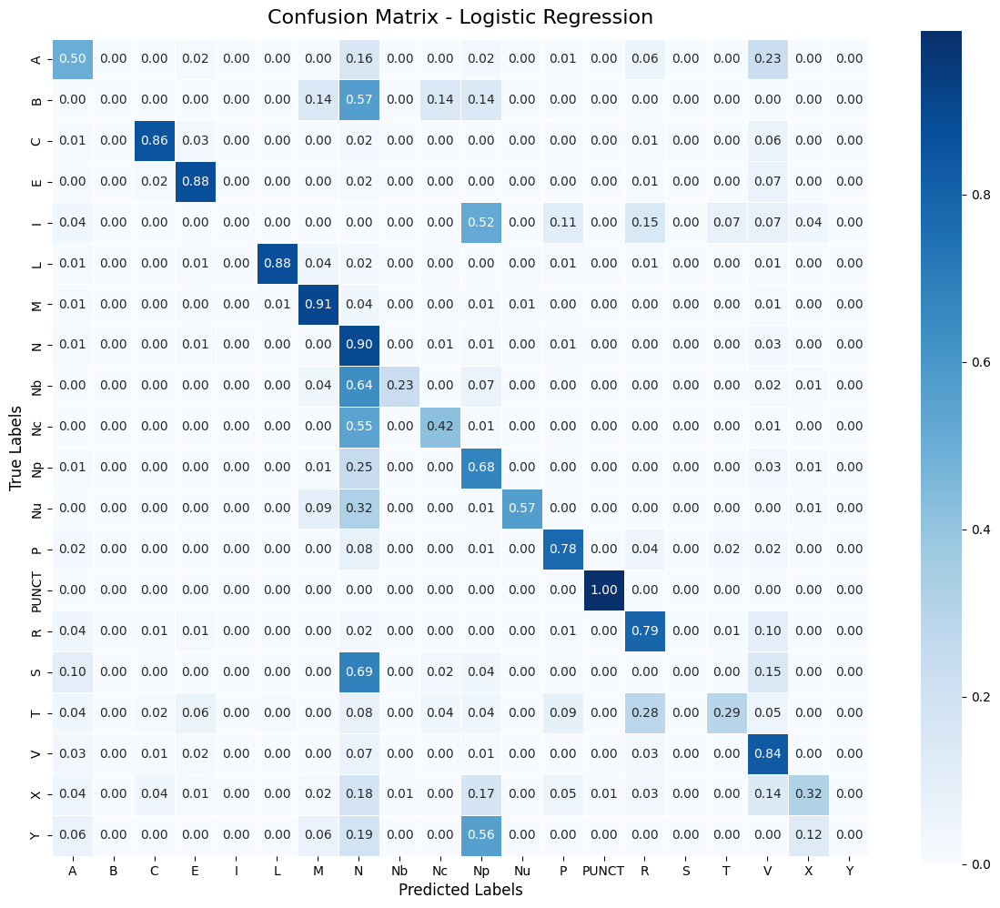

              precision    recall  f1-score   support

           A       0.66      0.50      0.57      4027
           B       0.00      0.00      0.00         7
           C       0.88      0.86      0.87      2367
           E       0.85      0.88      0.87      4061
           I       0.00      0.00      0.00        27
           L       0.94      0.88      0.91      1180
           M       0.90      0.91      0.90      2425
           N       0.78      0.90      0.83     15462
          Nb       0.64      0.23      0.34       121
          Nc       0.79      0.42      0.55      1634
          Np       0.74      0.68      0.71      2555
          Nu       0.79      0.57      0.66       310
           P       0.83      0.78      0.80      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.79      0.79      0.79      4746
           S       0.00      0.00      0.00        48
           T       0.44      0.29      0.35       422
           V       0.81    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test)

### MLP

Train samples: 152252, Test samples: 65251
Train batches: 4758, Test batches: 1020


Epoch 1/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.0886 | Test Loss=1.4764 | Test Acc=0.5875
New best model saved (test_acc=0.5875)


Epoch 2/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.2062 | Test Loss=0.9484 | Test Acc=0.7336
New best model saved (test_acc=0.7336)


Epoch 3/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.8619 | Test Loss=0.7264 | Test Acc=0.7921
New best model saved (test_acc=0.7921)


Epoch 4/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.7106 | Test Loss=0.6224 | Test Acc=0.8160
New best model saved (test_acc=0.8160)


Epoch 5/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.6344 | Test Loss=0.5678 | Test Acc=0.8278
New best model saved (test_acc=0.8278)


Epoch 6/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.5915 | Test Loss=0.5353 | Test Acc=0.8344
New best model saved (test_acc=0.8344)


Epoch 7/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.5655 | Test Loss=0.5130 | Test Acc=0.8392
New best model saved (test_acc=0.8392)


Epoch 8/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5446 | Test Loss=0.4966 | Test Acc=0.8417
New best model saved (test_acc=0.8417)


Epoch 9/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5278 | Test Loss=0.4830 | Test Acc=0.8453
New best model saved (test_acc=0.8453)


Epoch 10/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5164 | Test Loss=0.4716 | Test Acc=0.8482
New best model saved (test_acc=0.8482)


Epoch 11/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.5030 | Test Loss=0.4618 | Test Acc=0.8511
New best model saved (test_acc=0.8511)


Epoch 12/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4934 | Test Loss=0.4528 | Test Acc=0.8538
New best model saved (test_acc=0.8538)


Epoch 13/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4839 | Test Loss=0.4451 | Test Acc=0.8562
New best model saved (test_acc=0.8562)


Epoch 14/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4771 | Test Loss=0.4380 | Test Acc=0.8591
New best model saved (test_acc=0.8591)


Epoch 15/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4684 | Test Loss=0.4318 | Test Acc=0.8607
New best model saved (test_acc=0.8607)


Epoch 16/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4619 | Test Loss=0.4259 | Test Acc=0.8628
New best model saved (test_acc=0.8628)


Epoch 17/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4557 | Test Loss=0.4203 | Test Acc=0.8644
New best model saved (test_acc=0.8644)


Epoch 18/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4493 | Test Loss=0.4153 | Test Acc=0.8662
New best model saved (test_acc=0.8662)


Epoch 19/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4446 | Test Loss=0.4106 | Test Acc=0.8673
New best model saved (test_acc=0.8673)


Epoch 20/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.4395 | Test Loss=0.4063 | Test Acc=0.8686
New best model saved (test_acc=0.8686)


Epoch 21/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.4361 | Test Loss=0.4024 | Test Acc=0.8691
New best model saved (test_acc=0.8691)


Epoch 22/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.4308 | Test Loss=0.3984 | Test Acc=0.8708
New best model saved (test_acc=0.8708)


Epoch 23/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.4262 | Test Loss=0.3948 | Test Acc=0.8717
New best model saved (test_acc=0.8717)


Epoch 24/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.4230 | Test Loss=0.3913 | Test Acc=0.8727
New best model saved (test_acc=0.8727)


Epoch 25/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.4179 | Test Loss=0.3879 | Test Acc=0.8739
New best model saved (test_acc=0.8739)


Epoch 26/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.4149 | Test Loss=0.3849 | Test Acc=0.8741
New best model saved (test_acc=0.8741)


Epoch 27/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.4121 | Test Loss=0.3819 | Test Acc=0.8753
New best model saved (test_acc=0.8753)


Epoch 28/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.4078 | Test Loss=0.3788 | Test Acc=0.8761
New best model saved (test_acc=0.8761)


Epoch 29/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.4054 | Test Loss=0.3761 | Test Acc=0.8771
New best model saved (test_acc=0.8771)


Epoch 30/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.4016 | Test Loss=0.3735 | Test Acc=0.8778
New best model saved (test_acc=0.8778)


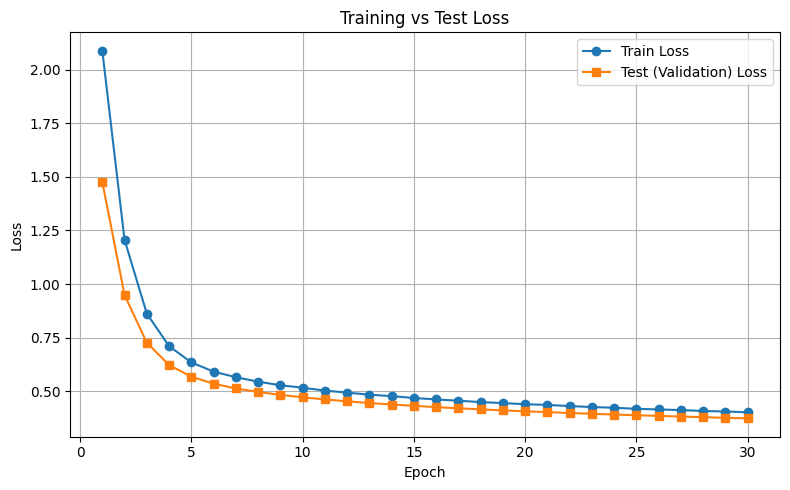

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1020 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8778


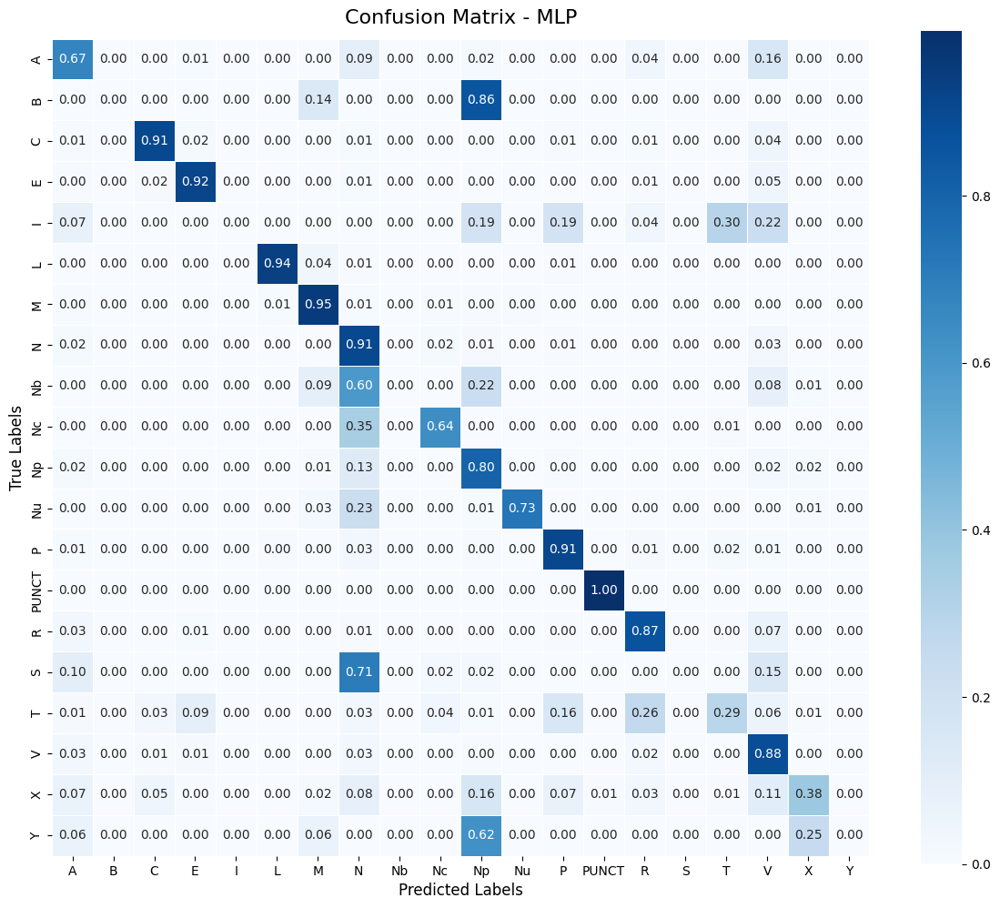

              precision    recall  f1-score   support

           A       0.73      0.67      0.70      4027
           B       0.00      0.00      0.00         7
           C       0.90      0.91      0.90      2367
           E       0.91      0.92      0.91      4061
           I       0.00      0.00      0.00        27
           L       0.95      0.94      0.94      1180
           M       0.93      0.95      0.94      2425
           N       0.87      0.91      0.89     15462
          Nb       0.00      0.00      0.00       121
          Nc       0.79      0.64      0.70      1634
          Np       0.80      0.80      0.80      2555
          Nu       0.83      0.73      0.78       310
           P       0.90      0.91      0.91      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.86      0.87      0.86      4746
           S       0.00      0.00      0.00        48
           T       0.53      0.29      0.38       422
           V       0.85    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1])

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002
Decomposed data (By PCA)
Train shape: (130501, 64), Test shape: (87002, 64)


### Naive Bayes

Fitting
Predicting


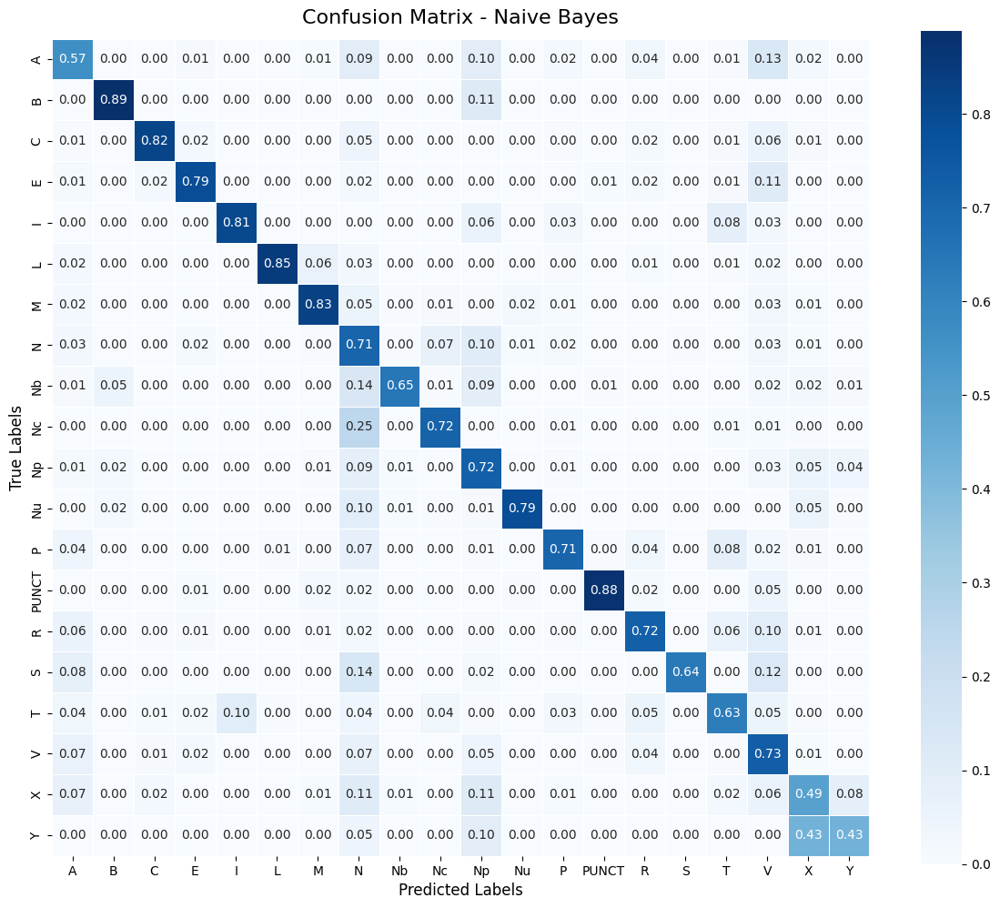

              precision    recall  f1-score   support

           A       0.55      0.57      0.56      5370
           B       0.07      0.89      0.13         9
           C       0.86      0.82      0.84      3156
           E       0.82      0.79      0.80      5415
           I       0.28      0.81      0.42        36
           L       0.96      0.85      0.90      1574
           M       0.83      0.83      0.83      3233
           N       0.79      0.71      0.75     20616
          Nb       0.37      0.65      0.47       161
          Nc       0.51      0.72      0.60      2179
          Np       0.40      0.72      0.52      3406
          Nu       0.51      0.79      0.62       413
           P       0.81      0.71      0.76      3705
       PUNCT       0.98      0.88      0.93     12843
           R       0.76      0.72      0.74      6328
           S       0.27      0.64      0.38        64
           T       0.27      0.63      0.37       563
           V       0.77    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test)

### Softmax Regression

Fitting
Predicting


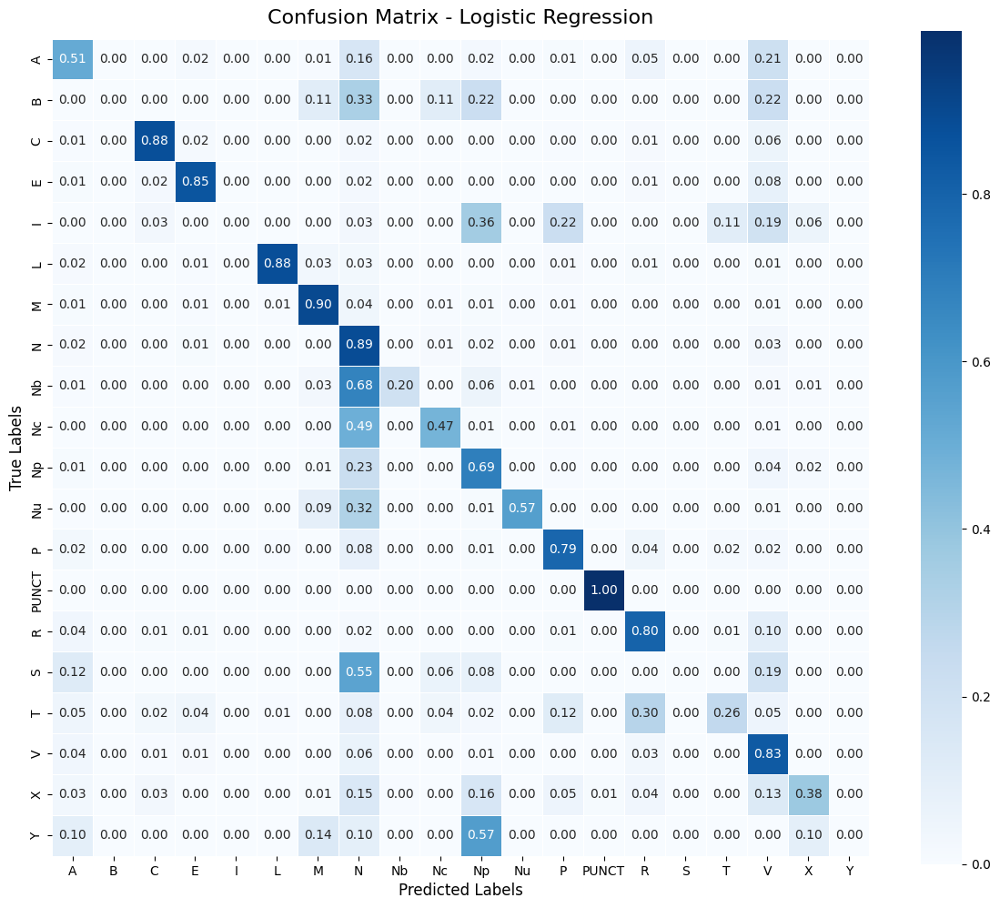

              precision    recall  f1-score   support

           A       0.65      0.51      0.58      5370
           B       0.00      0.00      0.00         9
           C       0.88      0.88      0.88      3156
           E       0.87      0.85      0.86      5415
           I       0.00      0.00      0.00        36
           L       0.94      0.88      0.91      1574
           M       0.91      0.90      0.90      3233
           N       0.78      0.89      0.83     20616
          Nb       0.61      0.20      0.31       161
          Nc       0.76      0.47      0.58      2179
          Np       0.73      0.69      0.71      3406
          Nu       0.81      0.57      0.67       413
           P       0.82      0.79      0.80      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.78      0.80      0.79      6328
           S       0.00      0.00      0.00        64
           T       0.46      0.26      0.34       563
           V       0.80    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test)

### MLP

Train samples: 130501, Test samples: 87002
Train batches: 4079, Test batches: 1360


Epoch 1/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.1191 | Test Loss=1.5705 | Test Acc=0.5607
New best model saved (test_acc=0.5607)


Epoch 2/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.3128 | Test Loss=1.0543 | Test Acc=0.6941
New best model saved (test_acc=0.6941)


Epoch 3/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.9523 | Test Loss=0.8034 | Test Acc=0.7736
New best model saved (test_acc=0.7736)


Epoch 4/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.7760 | Test Loss=0.6777 | Test Acc=0.8026
New best model saved (test_acc=0.8026)


Epoch 5/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.6839 | Test Loss=0.6084 | Test Acc=0.8182
New best model saved (test_acc=0.8182)


Epoch 6/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.6304 | Test Loss=0.5661 | Test Acc=0.8264
New best model saved (test_acc=0.8264)


Epoch 7/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.5945 | Test Loss=0.5374 | Test Acc=0.8327
New best model saved (test_acc=0.8327)


Epoch 8/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5703 | Test Loss=0.5169 | Test Acc=0.8368
New best model saved (test_acc=0.8368)


Epoch 9/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5514 | Test Loss=0.5013 | Test Acc=0.8405
New best model saved (test_acc=0.8405)


Epoch 10/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5355 | Test Loss=0.4881 | Test Acc=0.8433
New best model saved (test_acc=0.8433)


Epoch 11/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.5257 | Test Loss=0.4773 | Test Acc=0.8458
New best model saved (test_acc=0.8458)


Epoch 12/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.5131 | Test Loss=0.4676 | Test Acc=0.8485
New best model saved (test_acc=0.8485)


Epoch 13/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.5034 | Test Loss=0.4592 | Test Acc=0.8511
New best model saved (test_acc=0.8511)


Epoch 14/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4931 | Test Loss=0.4516 | Test Acc=0.8533
New best model saved (test_acc=0.8533)


Epoch 15/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4874 | Test Loss=0.4451 | Test Acc=0.8552
New best model saved (test_acc=0.8552)


Epoch 16/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4805 | Test Loss=0.4389 | Test Acc=0.8568
New best model saved (test_acc=0.8568)


Epoch 17/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4759 | Test Loss=0.4334 | Test Acc=0.8584
New best model saved (test_acc=0.8584)


Epoch 18/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4673 | Test Loss=0.4281 | Test Acc=0.8600
New best model saved (test_acc=0.8600)


Epoch 19/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4617 | Test Loss=0.4233 | Test Acc=0.8612
New best model saved (test_acc=0.8612)


Epoch 20/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.4570 | Test Loss=0.4187 | Test Acc=0.8627
New best model saved (test_acc=0.8627)


Epoch 21/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.4521 | Test Loss=0.4145 | Test Acc=0.8638
New best model saved (test_acc=0.8638)


Epoch 22/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.4491 | Test Loss=0.4107 | Test Acc=0.8647
New best model saved (test_acc=0.8647)


Epoch 23/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.4438 | Test Loss=0.4067 | Test Acc=0.8662
New best model saved (test_acc=0.8662)


Epoch 24/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.4405 | Test Loss=0.4031 | Test Acc=0.8671
New best model saved (test_acc=0.8671)


Epoch 25/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.4346 | Test Loss=0.3995 | Test Acc=0.8684
New best model saved (test_acc=0.8684)


Epoch 26/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.4326 | Test Loss=0.3964 | Test Acc=0.8690
New best model saved (test_acc=0.8690)


Epoch 27/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.4282 | Test Loss=0.3935 | Test Acc=0.8701
New best model saved (test_acc=0.8701)


Epoch 28/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.4243 | Test Loss=0.3903 | Test Acc=0.8710
New best model saved (test_acc=0.8710)


Epoch 29/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.4206 | Test Loss=0.3874 | Test Acc=0.8721
New best model saved (test_acc=0.8721)


Epoch 30/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.4169 | Test Loss=0.3845 | Test Acc=0.8726
New best model saved (test_acc=0.8726)


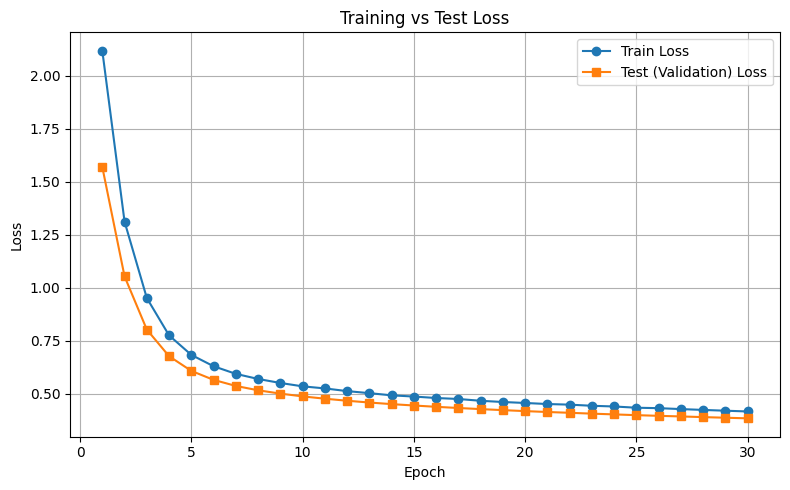

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1360 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8726


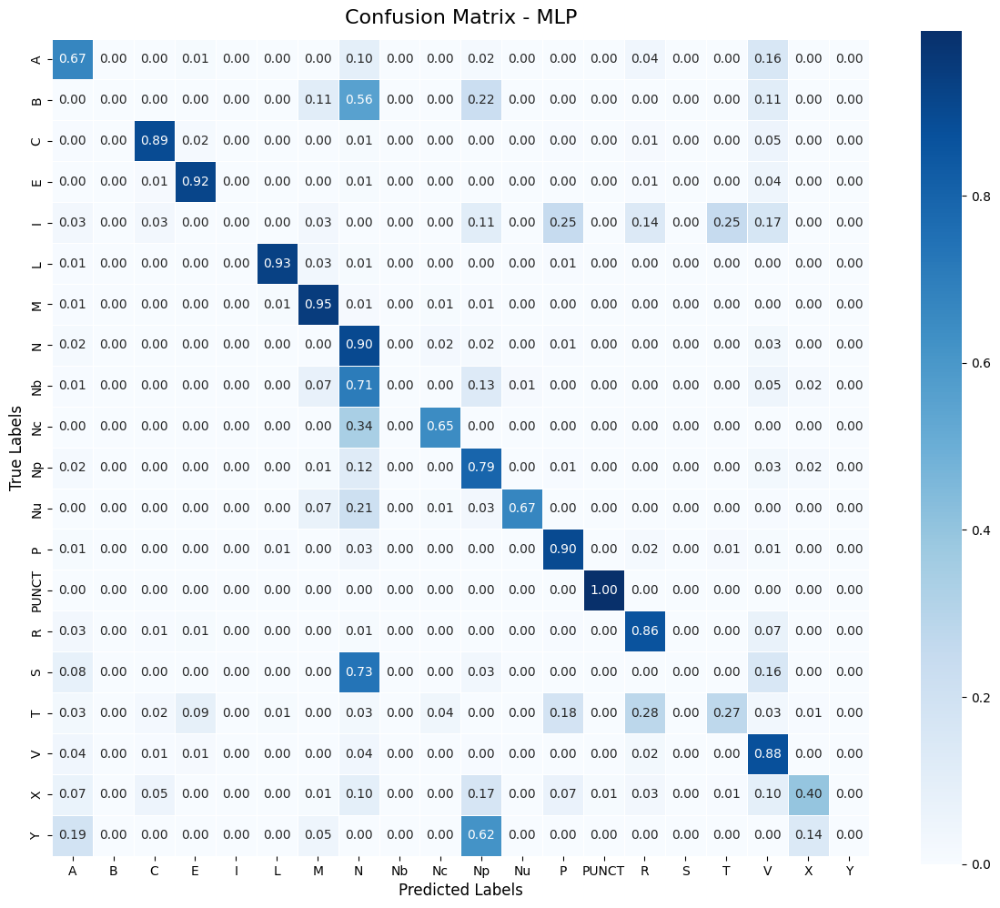

              precision    recall  f1-score   support

           A       0.71      0.67      0.69      5370
           B       0.00      0.00      0.00         9
           C       0.90      0.89      0.90      3156
           E       0.90      0.92      0.91      5415
           I       0.00      0.00      0.00        36
           L       0.94      0.93      0.94      1574
           M       0.92      0.95      0.94      3233
           N       0.86      0.90      0.88     20616
          Nb       0.00      0.00      0.00       161
          Nc       0.74      0.65      0.69      2179
          Np       0.78      0.79      0.79      3406
          Nu       0.84      0.67      0.75       413
           P       0.89      0.90      0.90      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.85      0.86      0.86      6328
           S       0.00      0.00      0.00        64
           T       0.59      0.27      0.37       563
           V       0.85    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1])

# Run classification (weighted) - 768D

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train, X_test, y_train, y_test = train_test_split_by_ratio()

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501


### Naive Bayes

Fitting
Predicting


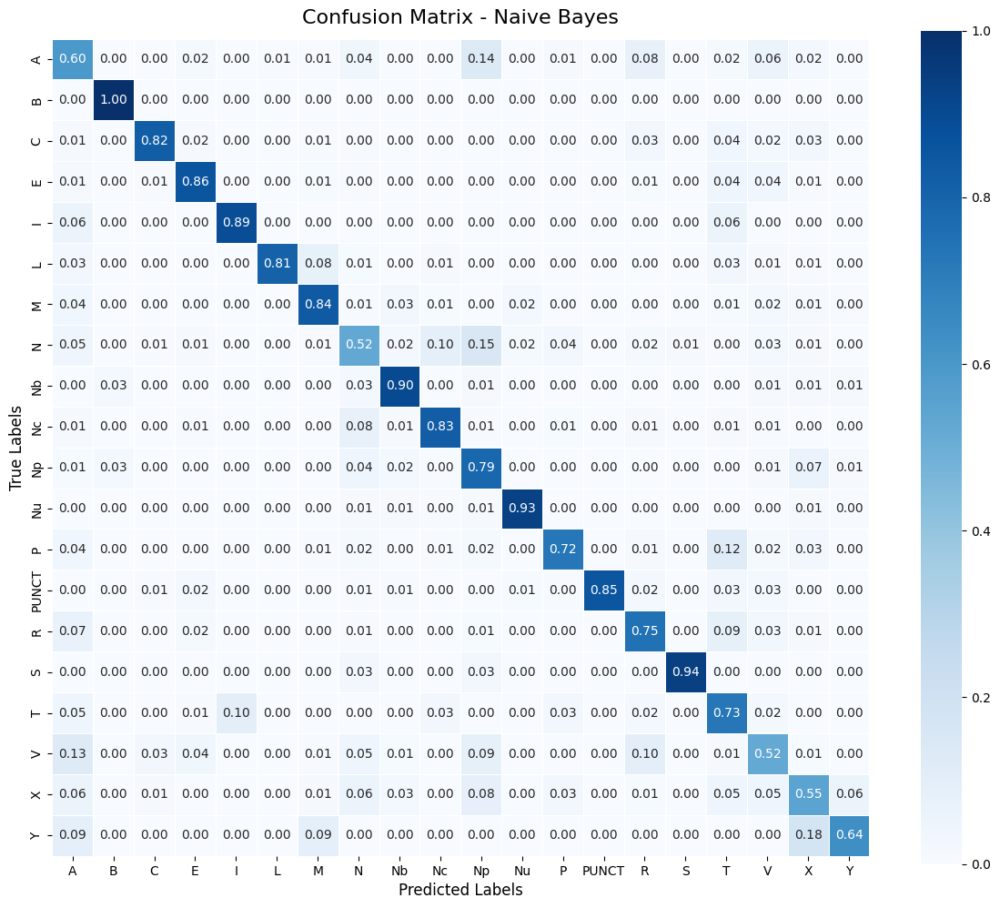

              precision    recall  f1-score   support

           A       0.43      0.60      0.50      2685
           B       0.08      1.00      0.14         4
           C       0.76      0.82      0.79      1578
           E       0.74      0.86      0.80      2708
           I       0.29      0.89      0.44        18
           L       0.96      0.81      0.88       787
           M       0.83      0.84      0.84      1617
           N       0.86      0.52      0.65     10308
          Nb       0.13      0.90      0.22        80
          Nc       0.46      0.83      0.59      1090
          Np       0.32      0.79      0.46      1703
          Nu       0.39      0.93      0.55       206
           P       0.73      0.72      0.73      1853
       PUNCT       1.00      0.85      0.92      6421
           R       0.61      0.75      0.67      3164
           S       0.15      0.94      0.26        32
           T       0.15      0.73      0.25       281
           V       0.82    

In [ ]:
run_naive_bayes(X_train, y_train, X_test, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


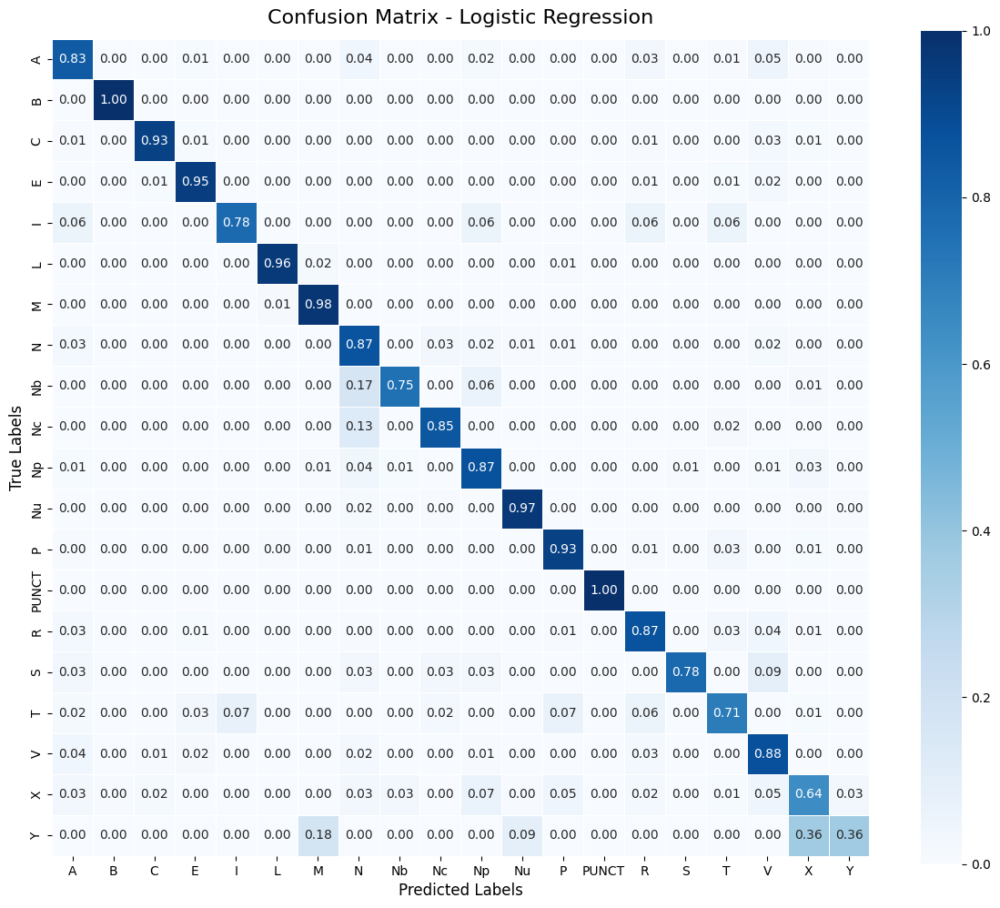

              precision    recall  f1-score   support

           A       0.75      0.83      0.79      2685
           B       0.67      1.00      0.80         4
           C       0.92      0.93      0.93      1578
           E       0.91      0.95      0.93      2708
           I       0.37      0.78      0.50        18
           L       0.94      0.96      0.95       787
           M       0.96      0.98      0.97      1617
           N       0.94      0.87      0.90     10308
          Nb       0.47      0.75      0.57        80
          Nc       0.73      0.85      0.78      1090
          Np       0.80      0.87      0.83      1703
          Nu       0.74      0.97      0.84       206
           P       0.92      0.93      0.92      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.88      0.87      0.87      3164
           S       0.27      0.78      0.40        32
           T       0.43      0.71      0.53       281
           V       0.93    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test, weighted=True)

### MLP

Train samples: 174002, Test samples: 43501
Train batches: 5438, Test batches: 680


Epoch 1/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.4660 | Test Loss=1.8388 | Test Acc=0.6013
New best model saved (test_acc=0.6013)


Epoch 2/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.4350 | Test Loss=1.1513 | Test Acc=0.7339
New best model saved (test_acc=0.7339)


Epoch 3/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=0.9931 | Test Loss=0.8598 | Test Acc=0.7941
New best model saved (test_acc=0.7941)


Epoch 4/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.7917 | Test Loss=0.7074 | Test Acc=0.8136
New best model saved (test_acc=0.8136)


Epoch 5/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.6849 | Test Loss=0.6170 | Test Acc=0.8222
New best model saved (test_acc=0.8222)


Epoch 6/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.6126 | Test Loss=0.5575 | Test Acc=0.8316
New best model saved (test_acc=0.8316)


Epoch 7/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.5628 | Test Loss=0.5169 | Test Acc=0.8448
New best model saved (test_acc=0.8448)


Epoch 8/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5299 | Test Loss=0.4891 | Test Acc=0.8517
New best model saved (test_acc=0.8517)


Epoch 9/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.4990 | Test Loss=0.4663 | Test Acc=0.8555
New best model saved (test_acc=0.8555)


Epoch 10/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.4752 | Test Loss=0.4479 | Test Acc=0.8546


Epoch 11/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.4599 | Test Loss=0.4321 | Test Acc=0.8576
New best model saved (test_acc=0.8576)


Epoch 12/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4434 | Test Loss=0.4193 | Test Acc=0.8621
New best model saved (test_acc=0.8621)


Epoch 13/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4259 | Test Loss=0.4094 | Test Acc=0.8641
New best model saved (test_acc=0.8641)


Epoch 14/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4153 | Test Loss=0.4016 | Test Acc=0.8694
New best model saved (test_acc=0.8694)


Epoch 15/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4046 | Test Loss=0.3911 | Test Acc=0.8693


Epoch 16/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.3968 | Test Loss=0.3856 | Test Acc=0.8686


Epoch 17/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.3853 | Test Loss=0.3794 | Test Acc=0.8727
New best model saved (test_acc=0.8727)


Epoch 18/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.3777 | Test Loss=0.3742 | Test Acc=0.8739
New best model saved (test_acc=0.8739)


Epoch 19/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.3707 | Test Loss=0.3690 | Test Acc=0.8718


Epoch 20/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.3642 | Test Loss=0.3649 | Test Acc=0.8758
New best model saved (test_acc=0.8758)


Epoch 21/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.3545 | Test Loss=0.3625 | Test Acc=0.8768
New best model saved (test_acc=0.8768)


Epoch 22/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.3509 | Test Loss=0.3581 | Test Acc=0.8766


Epoch 23/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.3460 | Test Loss=0.3541 | Test Acc=0.8766


Epoch 24/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.3402 | Test Loss=0.3501 | Test Acc=0.8784
New best model saved (test_acc=0.8784)


Epoch 25/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.3356 | Test Loss=0.3491 | Test Acc=0.8824
New best model saved (test_acc=0.8824)


Epoch 26/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.3306 | Test Loss=0.3446 | Test Acc=0.8803


Epoch 27/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.3258 | Test Loss=0.3408 | Test Acc=0.8790


Epoch 28/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3195 | Test Loss=0.3413 | Test Acc=0.8838
New best model saved (test_acc=0.8838)


Epoch 29/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3174 | Test Loss=0.3394 | Test Acc=0.8828


Epoch 30/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3141 | Test Loss=0.3378 | Test Acc=0.8858
New best model saved (test_acc=0.8858)


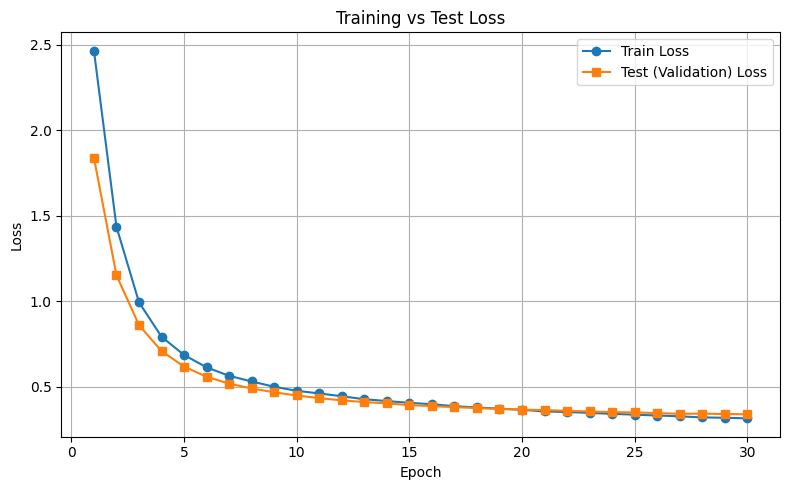

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/680 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8858


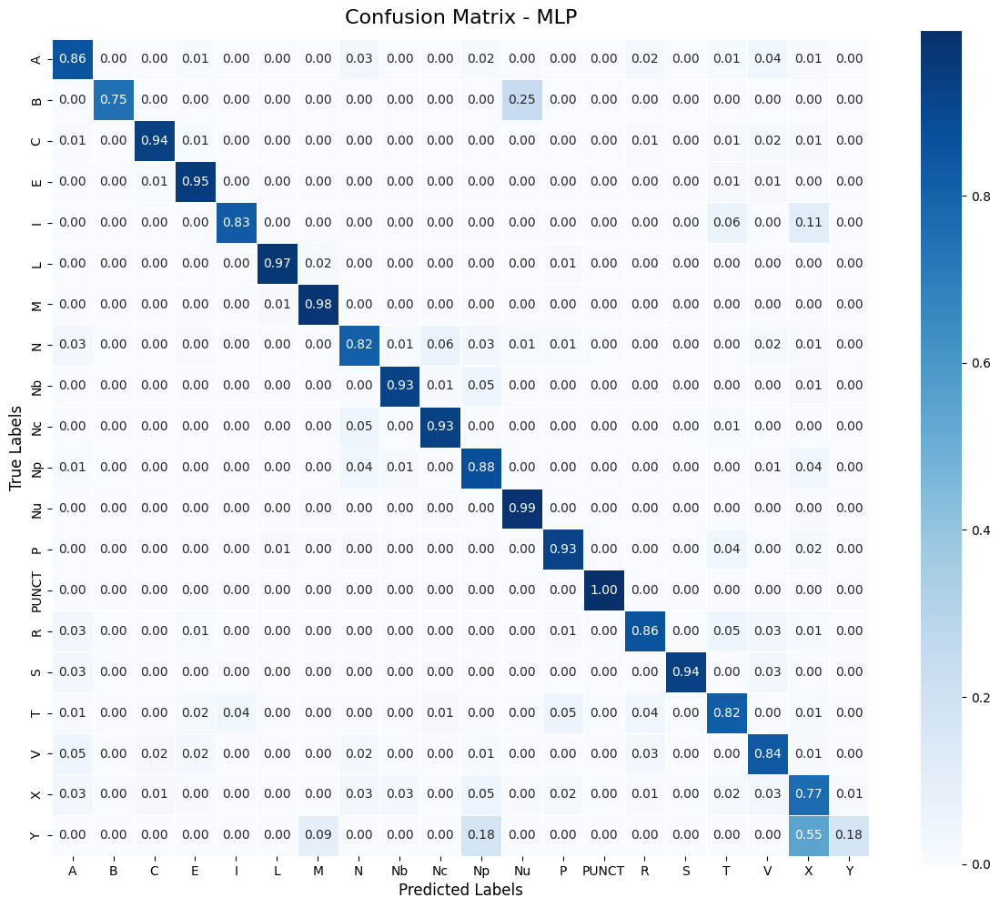

              precision    recall  f1-score   support

           A       0.72      0.86      0.78      2685
           B       1.00      0.75      0.86         4
           C       0.89      0.94      0.91      1578
           E       0.89      0.95      0.92      2708
           I       0.48      0.83      0.61        18
           L       0.93      0.97      0.95       787
           M       0.97      0.98      0.97      1617
           N       0.95      0.82      0.88     10308
          Nb       0.43      0.93      0.59        80
          Nc       0.61      0.93      0.74      1090
          Np       0.77      0.88      0.82      1703
          Nu       0.65      0.99      0.78       206
           P       0.92      0.93      0.92      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.88      0.86      0.87      3164
           S       0.52      0.94      0.67        32
           T       0.40      0.82      0.54       281
           V       0.94    

In [ ]:
train_mlp(X_train, y_train, X_test, y_test, VALID_TAGS, input_dim=X_train.shape[1], weighted=True)

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train, X_test, y_train, y_test = train_test_split_by_ratio()

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251


### Naive Bayes

Fitting
Predicting


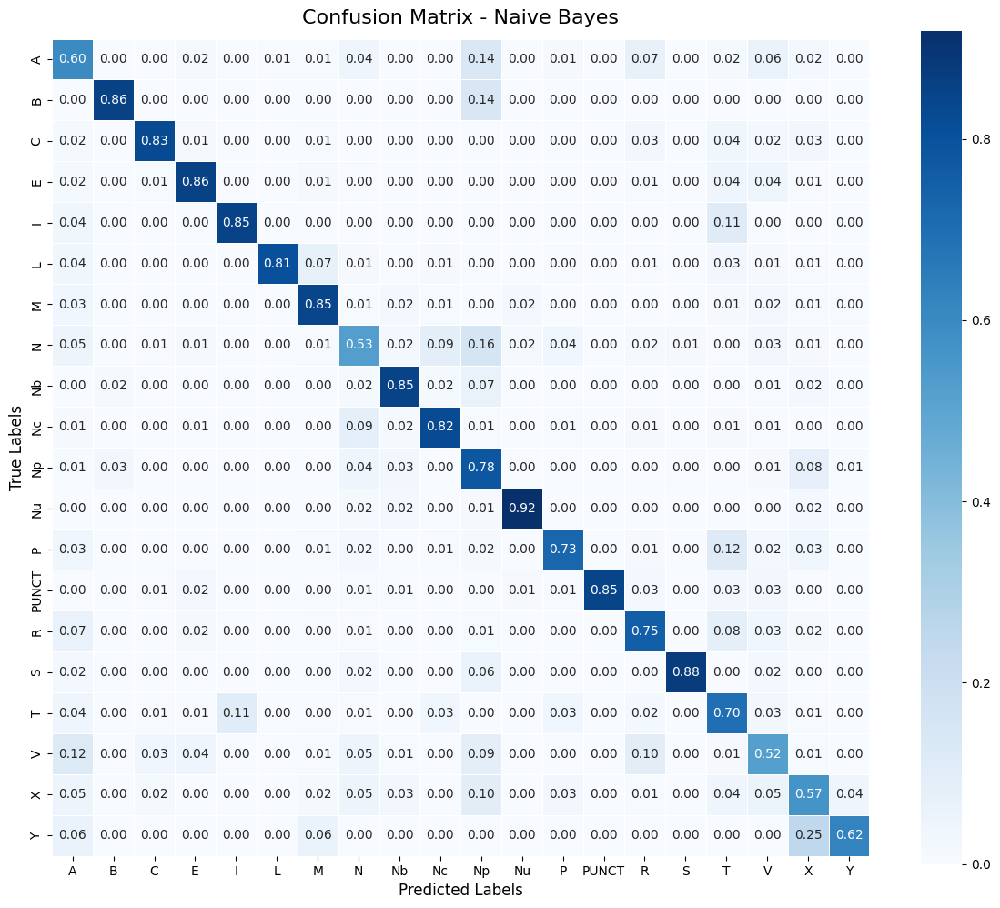

              precision    recall  f1-score   support

           A       0.44      0.60      0.51      4027
           B       0.08      0.86      0.14         7
           C       0.75      0.83      0.79      2367
           E       0.75      0.86      0.80      4061
           I       0.28      0.85      0.42        27
           L       0.96      0.81      0.88      1180
           M       0.83      0.85      0.84      2425
           N       0.86      0.53      0.65     15462
          Nb       0.12      0.85      0.21       121
          Nc       0.46      0.82      0.59      1634
          Np       0.32      0.78      0.45      2555
          Nu       0.39      0.92      0.55       310
           P       0.73      0.73      0.73      2779
       PUNCT       1.00      0.85      0.92      9632
           R       0.62      0.75      0.68      4746
           S       0.15      0.88      0.25        48
           T       0.15      0.70      0.25       422
           V       0.82    

In [ ]:
run_naive_bayes(X_train, y_train, X_test, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


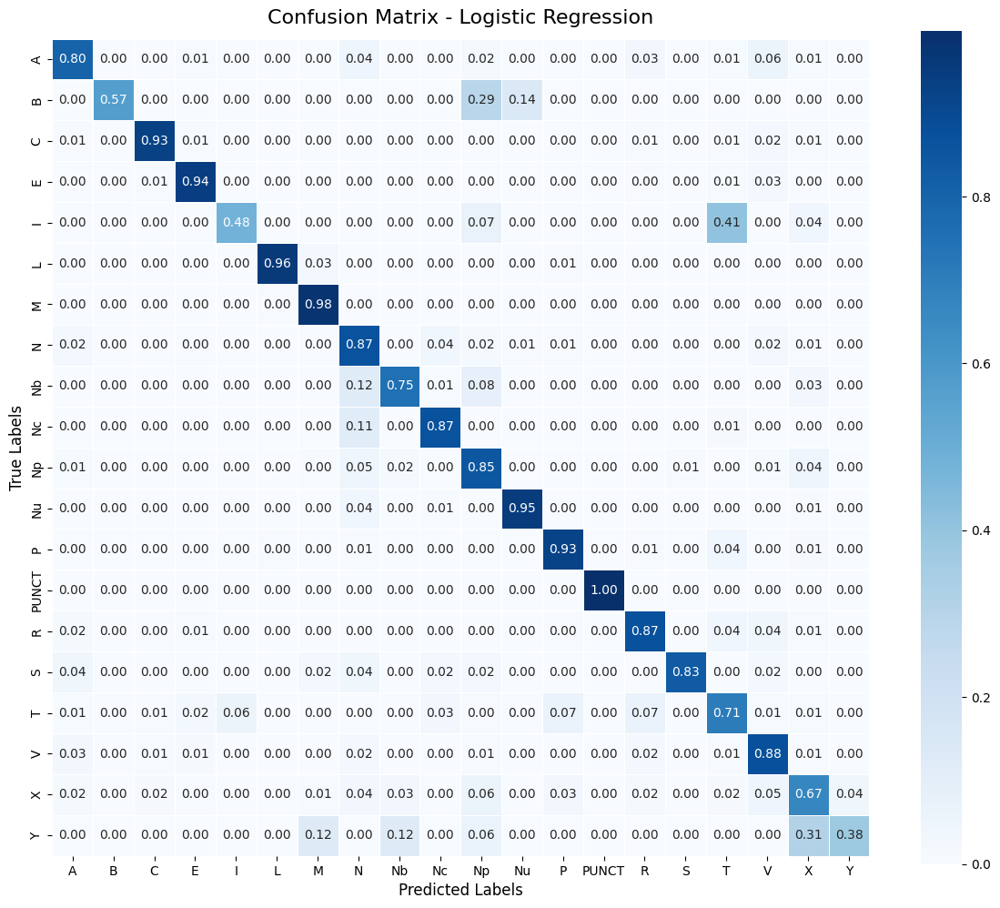

              precision    recall  f1-score   support

           A       0.78      0.80      0.79      4027
           B       0.67      0.57      0.62         7
           C       0.91      0.93      0.92      2367
           E       0.91      0.94      0.93      4061
           I       0.32      0.48      0.38        27
           L       0.96      0.96      0.96      1180
           M       0.96      0.98      0.97      2425
           N       0.94      0.87      0.90     15462
          Nb       0.41      0.75      0.53       121
          Nc       0.71      0.87      0.78      1634
          Np       0.82      0.85      0.83      2555
          Nu       0.73      0.95      0.83       310
           P       0.92      0.93      0.93      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.88      0.87      0.87      4746
           S       0.29      0.83      0.43        48
           T       0.37      0.71      0.49       422
           V       0.92    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test, weighted=True)

### MLP

Train samples: 152252, Test samples: 65251
Train batches: 4758, Test batches: 1020


Epoch 1/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.5694 | Test Loss=2.0317 | Test Acc=0.6081
New best model saved (test_acc=0.6081)


Epoch 2/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.5874 | Test Loss=1.2793 | Test Acc=0.7203
New best model saved (test_acc=0.7203)


Epoch 3/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.0859 | Test Loss=0.9434 | Test Acc=0.7695
New best model saved (test_acc=0.7695)


Epoch 4/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.8484 | Test Loss=0.7736 | Test Acc=0.7951
New best model saved (test_acc=0.7951)


Epoch 5/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.7238 | Test Loss=0.6780 | Test Acc=0.8163
New best model saved (test_acc=0.8163)


Epoch 6/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.6481 | Test Loss=0.6142 | Test Acc=0.8277
New best model saved (test_acc=0.8277)


Epoch 7/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.5931 | Test Loss=0.5669 | Test Acc=0.8336
New best model saved (test_acc=0.8336)


Epoch 8/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5532 | Test Loss=0.5335 | Test Acc=0.8391
New best model saved (test_acc=0.8391)


Epoch 9/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5237 | Test Loss=0.5069 | Test Acc=0.8467
New best model saved (test_acc=0.8467)


Epoch 10/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.4991 | Test Loss=0.4880 | Test Acc=0.8509
New best model saved (test_acc=0.8509)


Epoch 11/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.4781 | Test Loss=0.4708 | Test Acc=0.8519
New best model saved (test_acc=0.8519)


Epoch 12/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4581 | Test Loss=0.4571 | Test Acc=0.8561
New best model saved (test_acc=0.8561)


Epoch 13/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4469 | Test Loss=0.4453 | Test Acc=0.8574
New best model saved (test_acc=0.8574)


Epoch 14/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4323 | Test Loss=0.4365 | Test Acc=0.8629
New best model saved (test_acc=0.8629)


Epoch 15/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4242 | Test Loss=0.4263 | Test Acc=0.8627


Epoch 16/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4115 | Test Loss=0.4202 | Test Acc=0.8659
New best model saved (test_acc=0.8659)


Epoch 17/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.3972 | Test Loss=0.4139 | Test Acc=0.8685
New best model saved (test_acc=0.8685)


Epoch 18/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.3917 | Test Loss=0.4055 | Test Acc=0.8696
New best model saved (test_acc=0.8696)


Epoch 19/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.3827 | Test Loss=0.4007 | Test Acc=0.8710
New best model saved (test_acc=0.8710)


Epoch 20/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.3747 | Test Loss=0.3967 | Test Acc=0.8722
New best model saved (test_acc=0.8722)


Epoch 21/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.3704 | Test Loss=0.3908 | Test Acc=0.8701


Epoch 22/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.3636 | Test Loss=0.3862 | Test Acc=0.8731
New best model saved (test_acc=0.8731)


Epoch 23/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.3602 | Test Loss=0.3835 | Test Acc=0.8741
New best model saved (test_acc=0.8741)


Epoch 24/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.3521 | Test Loss=0.3811 | Test Acc=0.8750
New best model saved (test_acc=0.8750)


Epoch 25/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.3440 | Test Loss=0.3764 | Test Acc=0.8774
New best model saved (test_acc=0.8774)


Epoch 26/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.3384 | Test Loss=0.3765 | Test Acc=0.8810
New best model saved (test_acc=0.8810)


Epoch 27/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.3350 | Test Loss=0.3731 | Test Acc=0.8795


Epoch 28/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3316 | Test Loss=0.3670 | Test Acc=0.8773


Epoch 29/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3281 | Test Loss=0.3673 | Test Acc=0.8809


Epoch 30/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3200 | Test Loss=0.3648 | Test Acc=0.8824
New best model saved (test_acc=0.8824)


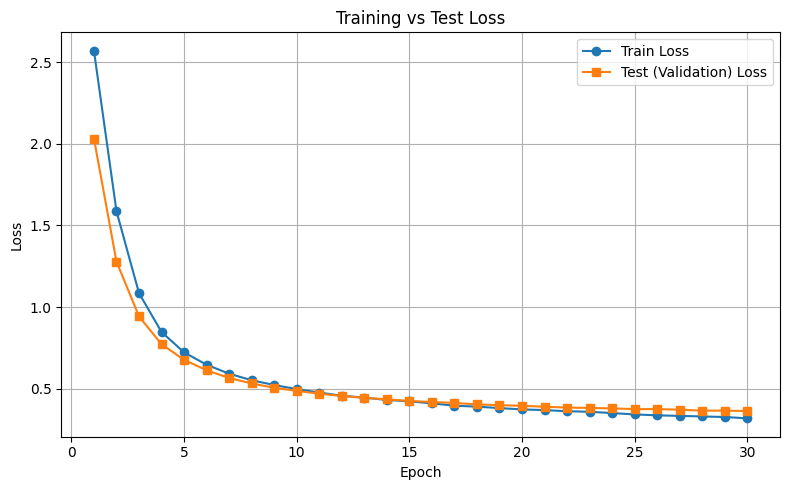

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1020 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8824


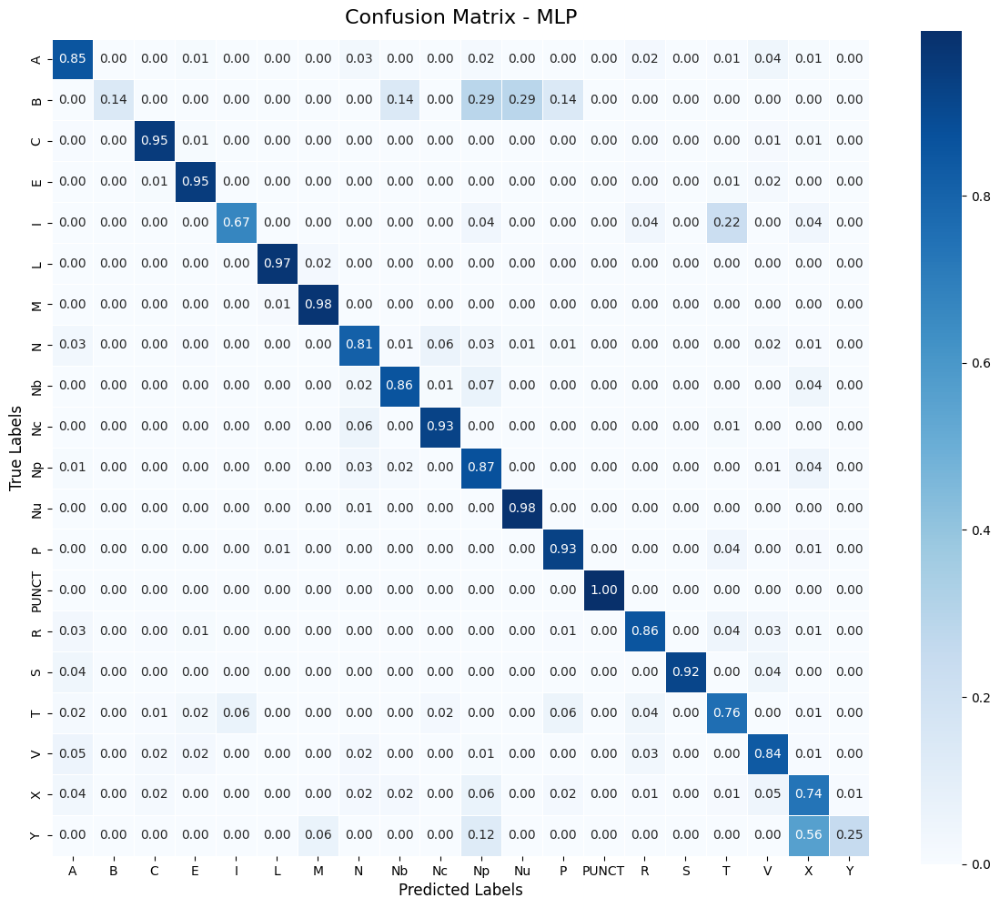

              precision    recall  f1-score   support

           A       0.71      0.85      0.78      4027
           B       0.50      0.14      0.22         7
           C       0.87      0.95      0.91      2367
           E       0.89      0.95      0.92      4061
           I       0.33      0.67      0.44        27
           L       0.91      0.97      0.94      1180
           M       0.96      0.98      0.97      2425
           N       0.95      0.81      0.88     15462
          Nb       0.39      0.86      0.53       121
          Nc       0.61      0.93      0.74      1634
          Np       0.75      0.87      0.81      2555
          Nu       0.65      0.98      0.78       310
           P       0.91      0.93      0.92      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.88      0.86      0.87      4746
           S       0.52      0.92      0.66        48
           T       0.40      0.76      0.53       422
           V       0.93    

In [ ]:
train_mlp(X_train, y_train, X_test, y_test, VALID_TAGS, input_dim=X_train.shape[1], weighted=True)

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train, X_test, y_train, y_test = train_test_split_by_ratio()

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002


### Naive Bayes

Fitting
Predicting


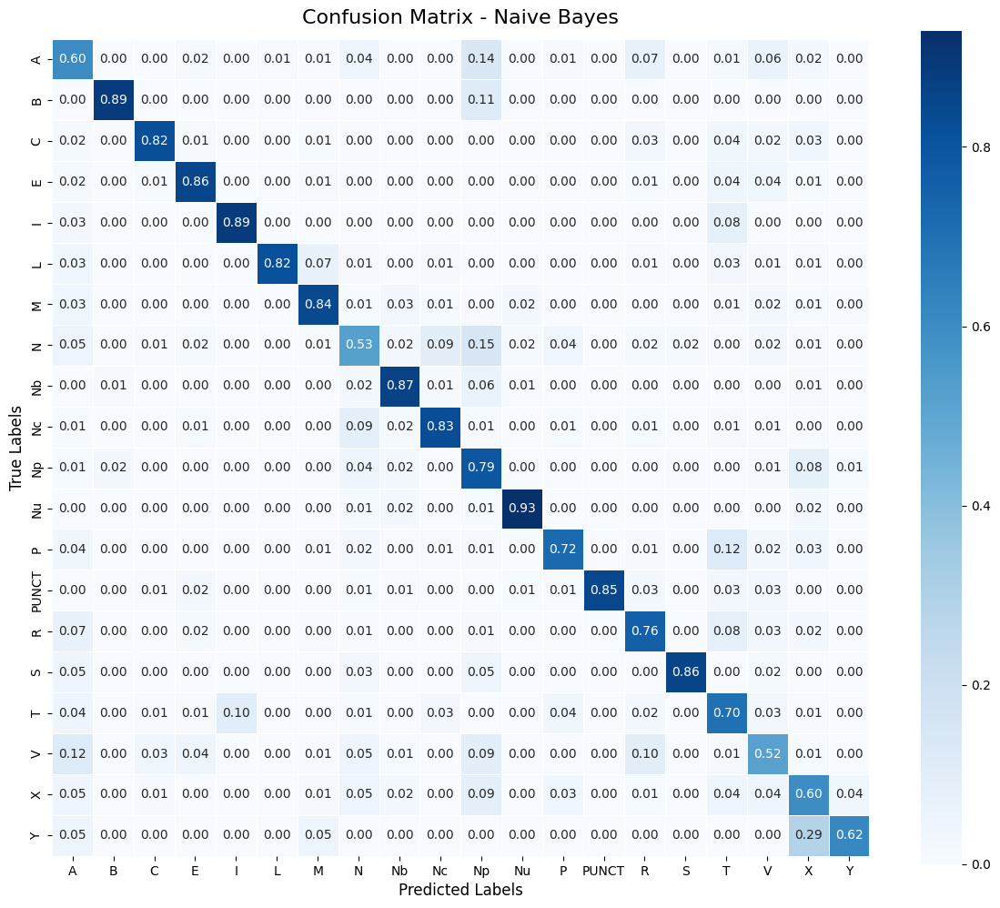

              precision    recall  f1-score   support

           A       0.44      0.60      0.51      5370
           B       0.11      0.89      0.19         9
           C       0.75      0.82      0.79      3156
           E       0.74      0.86      0.79      5415
           I       0.29      0.89      0.44        36
           L       0.97      0.82      0.88      1574
           M       0.84      0.84      0.84      3233
           N       0.86      0.53      0.65     20616
          Nb       0.12      0.87      0.22       161
          Nc       0.46      0.83      0.59      2179
          Np       0.32      0.79      0.45      3406
          Nu       0.40      0.93      0.56       413
           P       0.72      0.72      0.72      3705
       PUNCT       1.00      0.85      0.92     12843
           R       0.61      0.76      0.68      6328
           S       0.13      0.86      0.23        64
           T       0.15      0.70      0.25       563
           V       0.82    

In [ ]:
run_naive_bayes(X_train, y_train, X_test, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


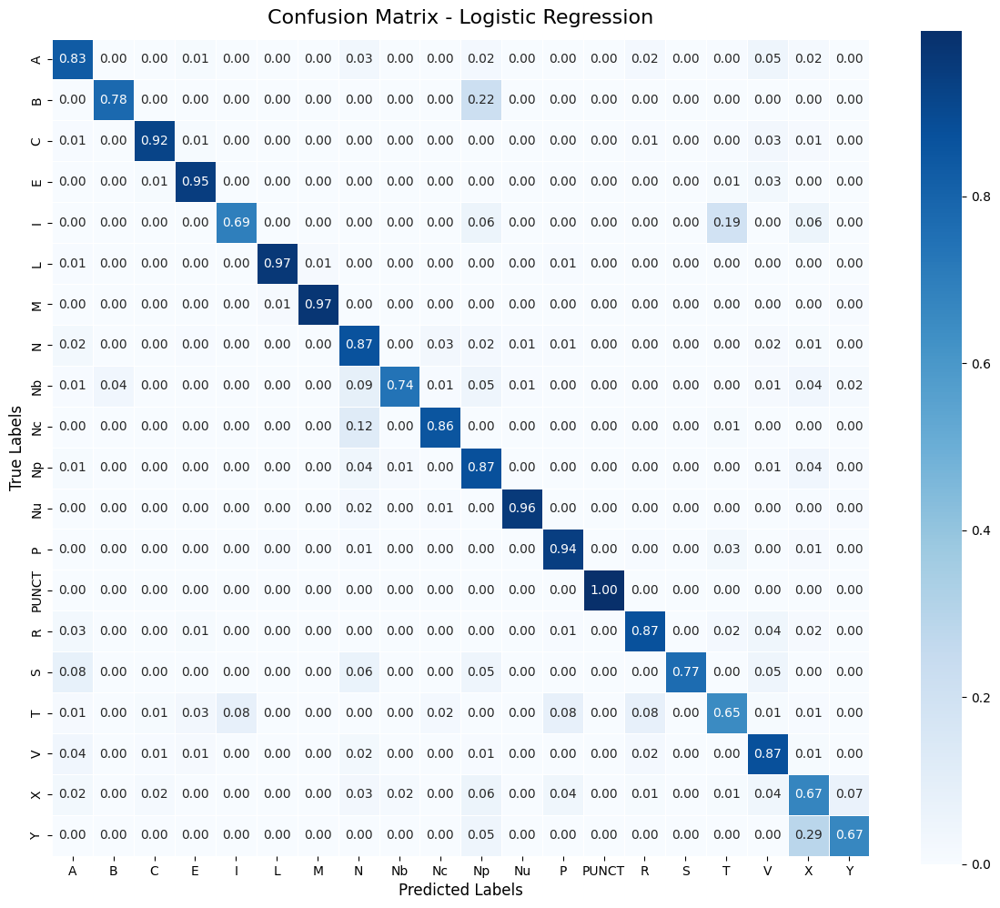

              precision    recall  f1-score   support

           A       0.76      0.83      0.80      5370
           B       0.32      0.78      0.45         9
           C       0.93      0.92      0.93      3156
           E       0.91      0.95      0.93      5415
           I       0.31      0.69      0.43        36
           L       0.94      0.97      0.95      1574
           M       0.97      0.97      0.97      3233
           N       0.94      0.87      0.90     20616
          Nb       0.47      0.74      0.57       161
          Nc       0.73      0.86      0.79      2179
          Np       0.79      0.87      0.83      3406
          Nu       0.73      0.96      0.83       413
           P       0.91      0.94      0.93      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.90      0.87      0.88      6328
           S       0.44      0.77      0.56        64
           T       0.46      0.65      0.54       563
           V       0.93    

In [ ]:
run_softmax_regression(X_train, y_train, X_test, y_test, weighted=True)

### MLP

Train samples: 130501, Test samples: 87002
Train batches: 4079, Test batches: 1360


Epoch 1/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.6349 | Test Loss=2.1578 | Test Acc=0.5929
New best model saved (test_acc=0.5929)


Epoch 2/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=1.7402 | Test Loss=1.4346 | Test Acc=0.7082
New best model saved (test_acc=0.7082)


Epoch 3/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.2090 | Test Loss=1.0478 | Test Acc=0.7573
New best model saved (test_acc=0.7573)


Epoch 4/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=0.9478 | Test Loss=0.8462 | Test Acc=0.7906
New best model saved (test_acc=0.7906)


Epoch 5/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.7940 | Test Loss=0.7253 | Test Acc=0.8085
New best model saved (test_acc=0.8085)


Epoch 6/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.7000 | Test Loss=0.6450 | Test Acc=0.8230
New best model saved (test_acc=0.8230)


Epoch 7/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.6404 | Test Loss=0.5912 | Test Acc=0.8343
New best model saved (test_acc=0.8343)


Epoch 8/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5917 | Test Loss=0.5534 | Test Acc=0.8362
New best model saved (test_acc=0.8362)


Epoch 9/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5544 | Test Loss=0.5215 | Test Acc=0.8415
New best model saved (test_acc=0.8415)


Epoch 10/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5297 | Test Loss=0.4980 | Test Acc=0.8454
New best model saved (test_acc=0.8454)


Epoch 11/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.5017 | Test Loss=0.4803 | Test Acc=0.8526
New best model saved (test_acc=0.8526)


Epoch 12/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4879 | Test Loss=0.4639 | Test Acc=0.8582
New best model saved (test_acc=0.8582)


Epoch 13/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4678 | Test Loss=0.4504 | Test Acc=0.8553


Epoch 14/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4526 | Test Loss=0.4397 | Test Acc=0.8604
New best model saved (test_acc=0.8604)


Epoch 15/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4410 | Test Loss=0.4301 | Test Acc=0.8630
New best model saved (test_acc=0.8630)


Epoch 16/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4308 | Test Loss=0.4227 | Test Acc=0.8651
New best model saved (test_acc=0.8651)


Epoch 17/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4234 | Test Loss=0.4152 | Test Acc=0.8616


Epoch 18/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4114 | Test Loss=0.4089 | Test Acc=0.8665
New best model saved (test_acc=0.8665)


Epoch 19/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4068 | Test Loss=0.4025 | Test Acc=0.8705
New best model saved (test_acc=0.8705)


Epoch 20/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.3975 | Test Loss=0.3981 | Test Acc=0.8719
New best model saved (test_acc=0.8719)


Epoch 21/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.3853 | Test Loss=0.3928 | Test Acc=0.8704


Epoch 22/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.3796 | Test Loss=0.3910 | Test Acc=0.8743
New best model saved (test_acc=0.8743)


Epoch 23/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.3752 | Test Loss=0.3847 | Test Acc=0.8722


Epoch 24/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.3681 | Test Loss=0.3806 | Test Acc=0.8747
New best model saved (test_acc=0.8747)


Epoch 25/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.3642 | Test Loss=0.3782 | Test Acc=0.8760
New best model saved (test_acc=0.8760)


Epoch 26/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.3569 | Test Loss=0.3744 | Test Acc=0.8759


Epoch 27/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.3538 | Test Loss=0.3735 | Test Acc=0.8786
New best model saved (test_acc=0.8786)


Epoch 28/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3471 | Test Loss=0.3705 | Test Acc=0.8779


Epoch 29/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3440 | Test Loss=0.3677 | Test Acc=0.8791
New best model saved (test_acc=0.8791)


Epoch 30/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3367 | Test Loss=0.3646 | Test Acc=0.8793
New best model saved (test_acc=0.8793)


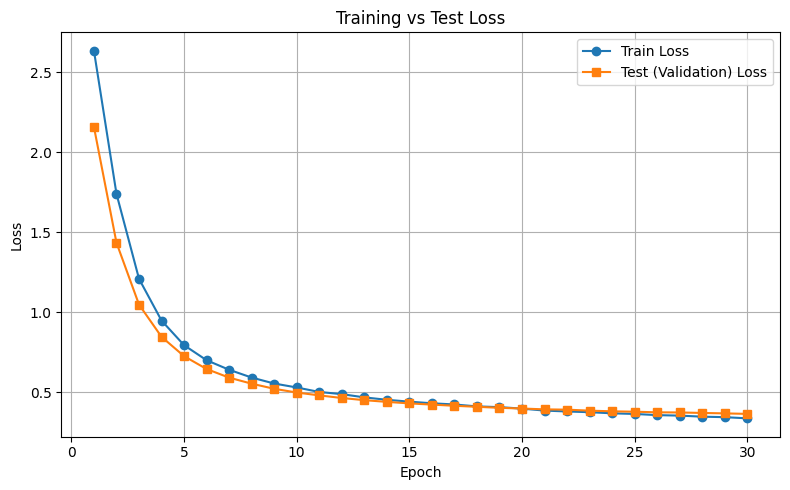

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1360 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8793


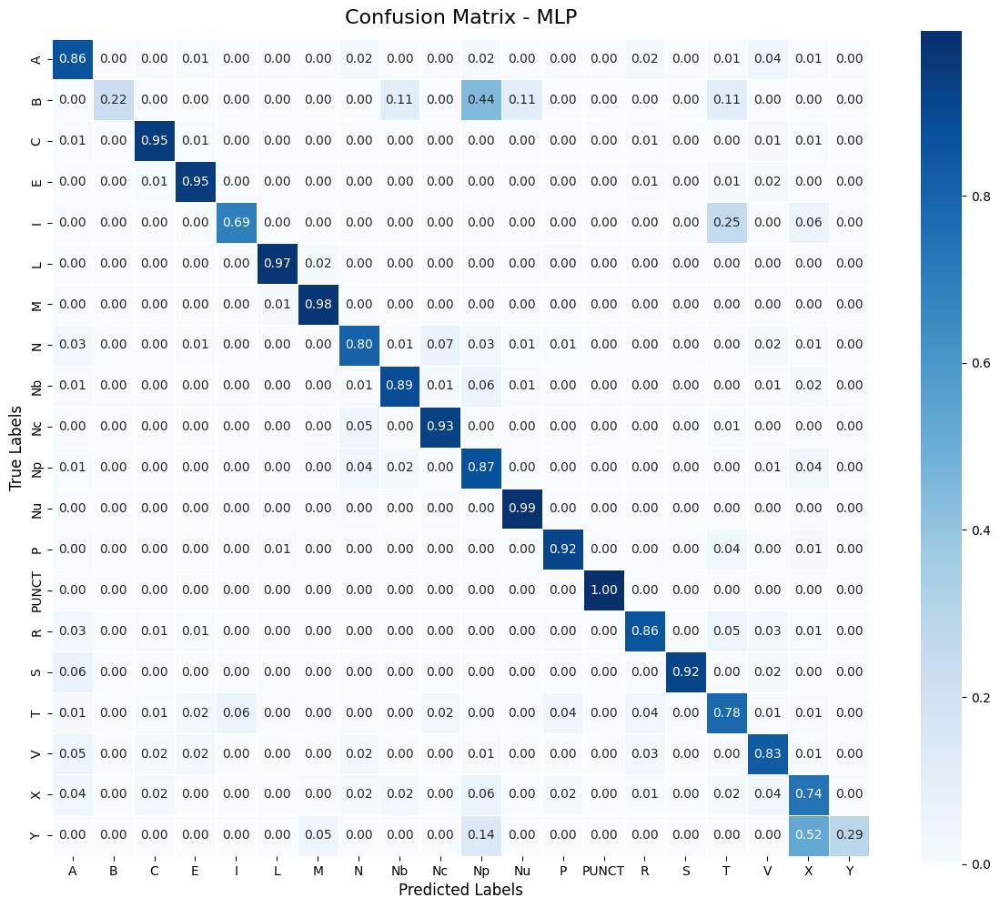

              precision    recall  f1-score   support

           A       0.71      0.86      0.78      5370
           B       0.50      0.22      0.31         9
           C       0.86      0.95      0.90      3156
           E       0.89      0.95      0.92      5415
           I       0.37      0.69      0.49        36
           L       0.91      0.97      0.94      1574
           M       0.96      0.98      0.97      3233
           N       0.96      0.80      0.87     20616
          Nb       0.35      0.89      0.50       161
          Nc       0.59      0.93      0.72      2179
          Np       0.75      0.87      0.81      3406
          Nu       0.65      0.99      0.79       413
           P       0.92      0.92      0.92      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.87      0.86      0.86      6328
           S       0.45      0.92      0.61        64
           T       0.38      0.78      0.51       563
           V       0.94    

In [ ]:
train_mlp(X_train, y_train, X_test, y_test, VALID_TAGS, input_dim=X_train.shape[1], weighted=True)

# Run classification (weighted) - 256D

In [ ]:
N_COMPONENTS_PCA_MODEL = 256

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501
Decomposed data (By PCA)
Train shape: (174002, 256), Test shape: (43501, 256)


### Naive Bayes

Fitting
Predicting


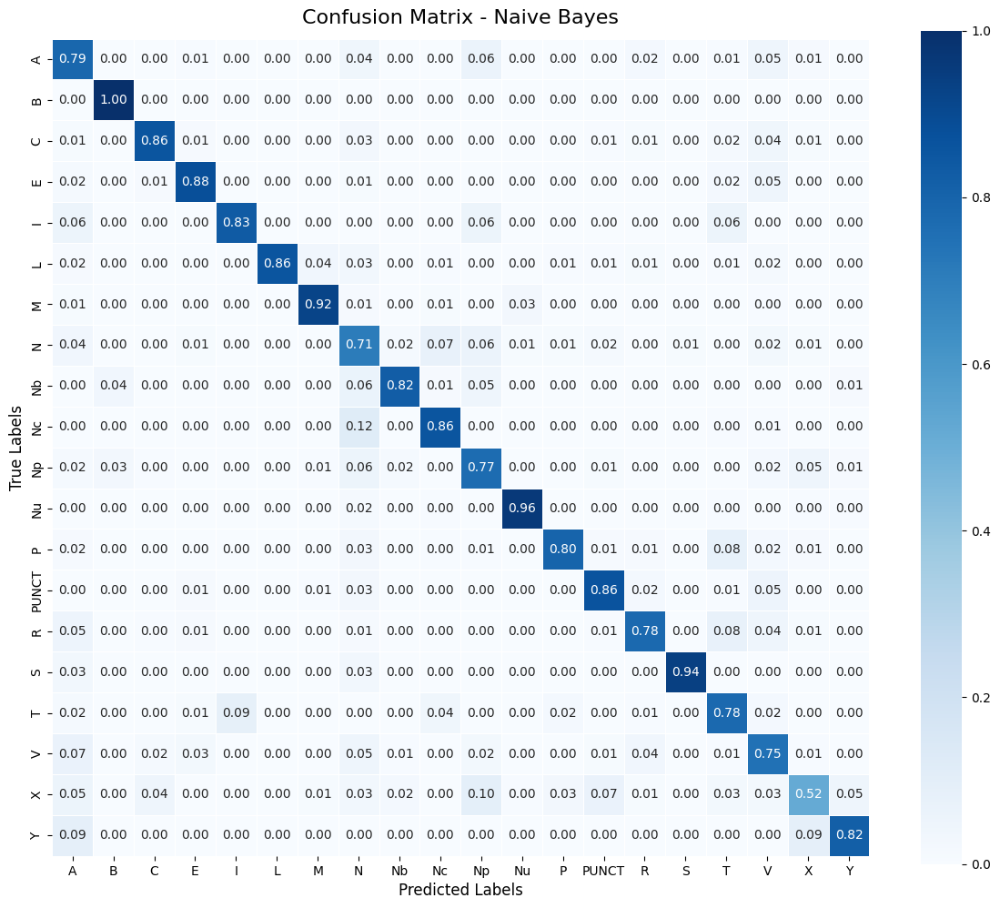

              precision    recall  f1-score   support

           A       0.61      0.79      0.69      2685
           B       0.07      1.00      0.12         4
           C       0.85      0.86      0.85      1578
           E       0.83      0.88      0.85      2708
           I       0.30      0.83      0.44        18
           L       1.00      0.86      0.92       787
           M       0.93      0.92      0.92      1617
           N       0.86      0.71      0.78     10308
          Nb       0.20      0.82      0.32        80
          Nc       0.53      0.86      0.65      1090
          Np       0.55      0.77      0.64      1703
          Nu       0.59      0.96      0.73       206
           P       0.91      0.80      0.85      1853
       PUNCT       0.93      0.86      0.90      6421
           R       0.80      0.78      0.79      3164
           S       0.21      0.94      0.34        32
           T       0.26      0.78      0.38       281
           V       0.84    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


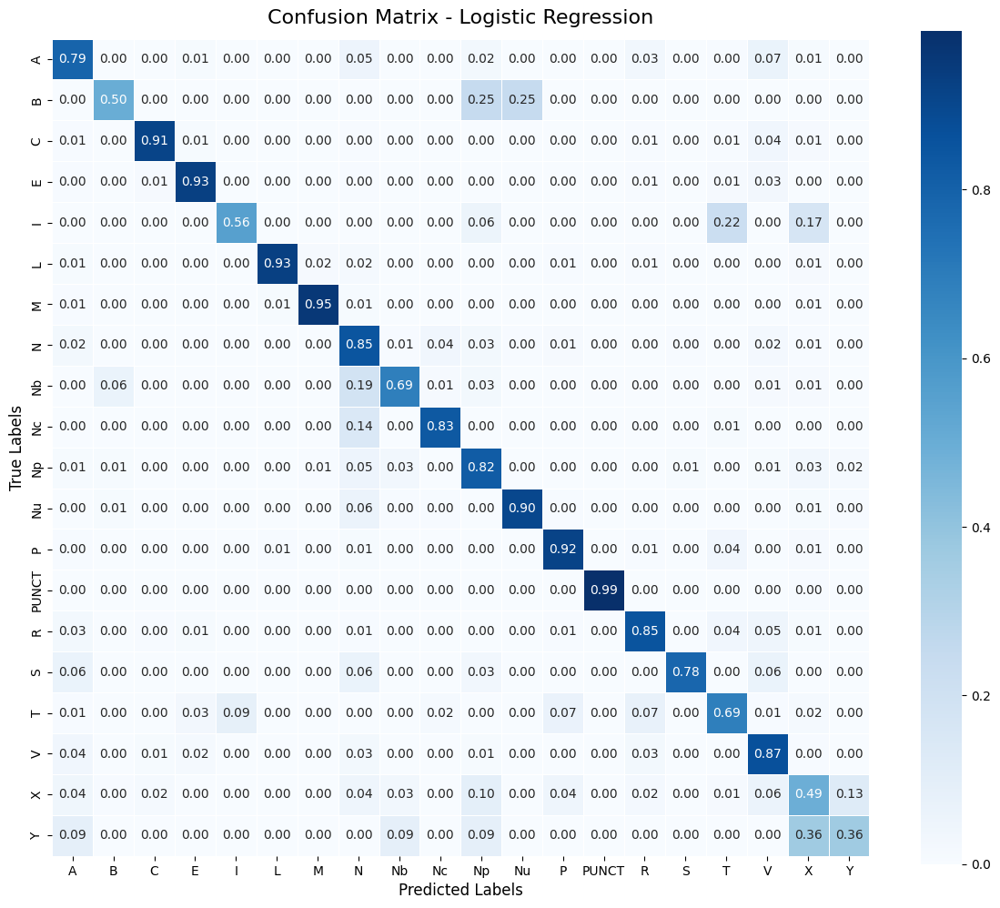

              precision    recall  f1-score   support

           A       0.74      0.79      0.76      2685
           B       0.06      0.50      0.11         4
           C       0.91      0.91      0.91      1578
           E       0.91      0.93      0.92      2708
           I       0.26      0.56      0.35        18
           L       0.94      0.93      0.94       787
           M       0.97      0.95      0.96      1617
           N       0.92      0.85      0.88     10308
          Nb       0.29      0.69      0.41        80
          Nc       0.69      0.83      0.75      1090
          Np       0.75      0.82      0.78      1703
          Nu       0.76      0.90      0.83       206
           P       0.89      0.92      0.90      1853
       PUNCT       1.00      0.99      0.99      6421
           R       0.87      0.85      0.86      3164
           S       0.24      0.78      0.36        32
           T       0.40      0.69      0.50       281
           V       0.91    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### MLP

Train samples: 174002, Test samples: 43501
Train batches: 5438, Test batches: 680


Epoch 1/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.7789 | Test Loss=2.4857 | Test Acc=0.5545
New best model saved (test_acc=0.5545)


Epoch 2/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=2.0298 | Test Loss=1.6746 | Test Acc=0.6090
New best model saved (test_acc=0.6090)


Epoch 3/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.3586 | Test Loss=1.1778 | Test Acc=0.7113
New best model saved (test_acc=0.7113)


Epoch 4/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=1.0011 | Test Loss=0.9217 | Test Acc=0.7695
New best model saved (test_acc=0.7695)


Epoch 5/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.8189 | Test Loss=0.7729 | Test Acc=0.8026
New best model saved (test_acc=0.8026)


Epoch 6/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.7069 | Test Loss=0.6759 | Test Acc=0.8198
New best model saved (test_acc=0.8198)


Epoch 7/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.6391 | Test Loss=0.6094 | Test Acc=0.8282
New best model saved (test_acc=0.8282)


Epoch 8/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.5862 | Test Loss=0.5636 | Test Acc=0.8388
New best model saved (test_acc=0.8388)


Epoch 9/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5509 | Test Loss=0.5274 | Test Acc=0.8425
New best model saved (test_acc=0.8425)


Epoch 10/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5151 | Test Loss=0.5008 | Test Acc=0.8485
New best model saved (test_acc=0.8485)


Epoch 11/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.4947 | Test Loss=0.4801 | Test Acc=0.8553
New best model saved (test_acc=0.8553)


Epoch 12/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4801 | Test Loss=0.4630 | Test Acc=0.8568
New best model saved (test_acc=0.8568)


Epoch 13/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4640 | Test Loss=0.4489 | Test Acc=0.8600
New best model saved (test_acc=0.8600)


Epoch 14/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4523 | Test Loss=0.4373 | Test Acc=0.8604
New best model saved (test_acc=0.8604)


Epoch 15/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4390 | Test Loss=0.4296 | Test Acc=0.8649
New best model saved (test_acc=0.8649)


Epoch 16/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4278 | Test Loss=0.4195 | Test Acc=0.8661
New best model saved (test_acc=0.8661)


Epoch 17/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4170 | Test Loss=0.4130 | Test Acc=0.8675
New best model saved (test_acc=0.8675)


Epoch 18/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4131 | Test Loss=0.4054 | Test Acc=0.8681
New best model saved (test_acc=0.8681)


Epoch 19/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4027 | Test Loss=0.3991 | Test Acc=0.8700
New best model saved (test_acc=0.8700)


Epoch 20/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.3992 | Test Loss=0.3934 | Test Acc=0.8687


Epoch 21/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.3903 | Test Loss=0.3889 | Test Acc=0.8709
New best model saved (test_acc=0.8709)


Epoch 22/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.3858 | Test Loss=0.3841 | Test Acc=0.8726
New best model saved (test_acc=0.8726)


Epoch 23/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.3779 | Test Loss=0.3811 | Test Acc=0.8733
New best model saved (test_acc=0.8733)


Epoch 24/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.3747 | Test Loss=0.3766 | Test Acc=0.8748
New best model saved (test_acc=0.8748)


Epoch 25/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.3705 | Test Loss=0.3735 | Test Acc=0.8743


Epoch 26/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.3661 | Test Loss=0.3699 | Test Acc=0.8751
New best model saved (test_acc=0.8751)


Epoch 27/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.3620 | Test Loss=0.3668 | Test Acc=0.8739


Epoch 28/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3587 | Test Loss=0.3645 | Test Acc=0.8758
New best model saved (test_acc=0.8758)


Epoch 29/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3531 | Test Loss=0.3615 | Test Acc=0.8767
New best model saved (test_acc=0.8767)


Epoch 30/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3499 | Test Loss=0.3592 | Test Acc=0.8773
New best model saved (test_acc=0.8773)


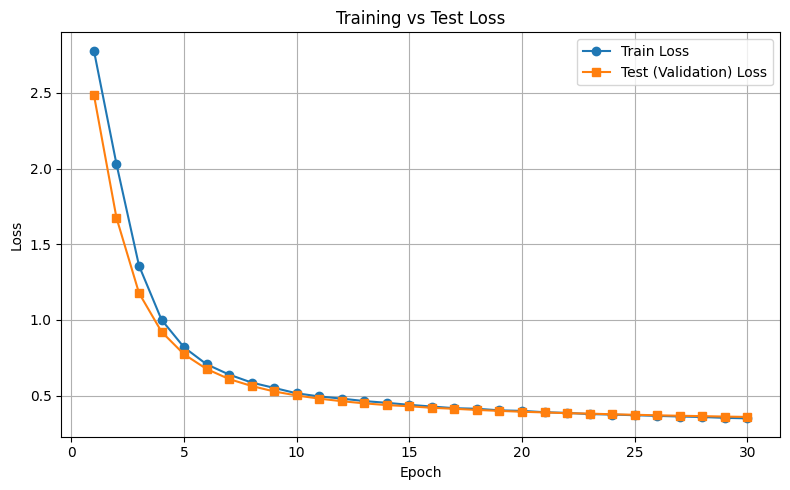

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/680 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8773


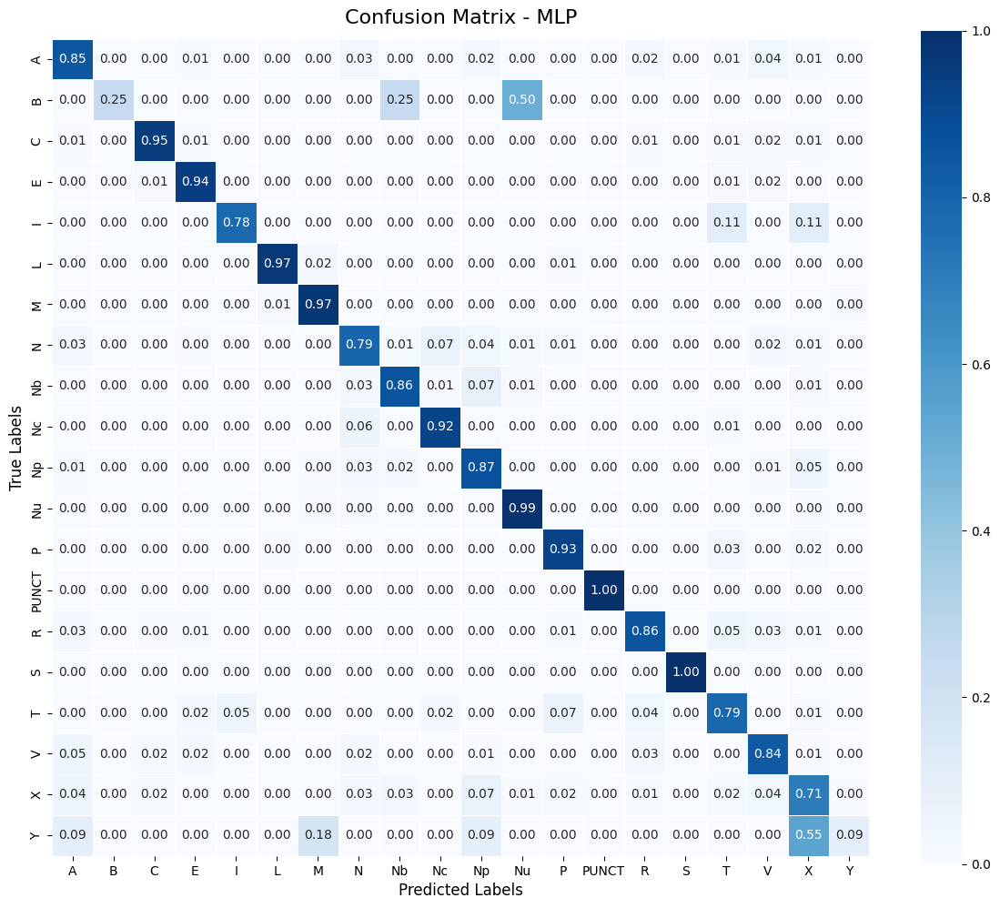

              precision    recall  f1-score   support

           A       0.72      0.85      0.78      2685
           B       1.00      0.25      0.40         4
           C       0.87      0.95      0.91      1578
           E       0.89      0.94      0.92      2708
           I       0.39      0.78      0.52        18
           L       0.93      0.97      0.95       787
           M       0.96      0.97      0.97      1617
           N       0.95      0.79      0.87     10308
          Nb       0.32      0.86      0.47        80
          Nc       0.59      0.92      0.72      1090
          Np       0.73      0.87      0.80      1703
          Nu       0.62      0.99      0.76       206
           P       0.90      0.93      0.92      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.88      0.86      0.87      3164
           S       0.42      1.00      0.59        32
           T       0.40      0.79      0.53       281
           V       0.93    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1], weighted=True)

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251
Decomposed data (By PCA)
Train shape: (152252, 256), Test shape: (65251, 256)


### Naive Bayes

Fitting
Predicting


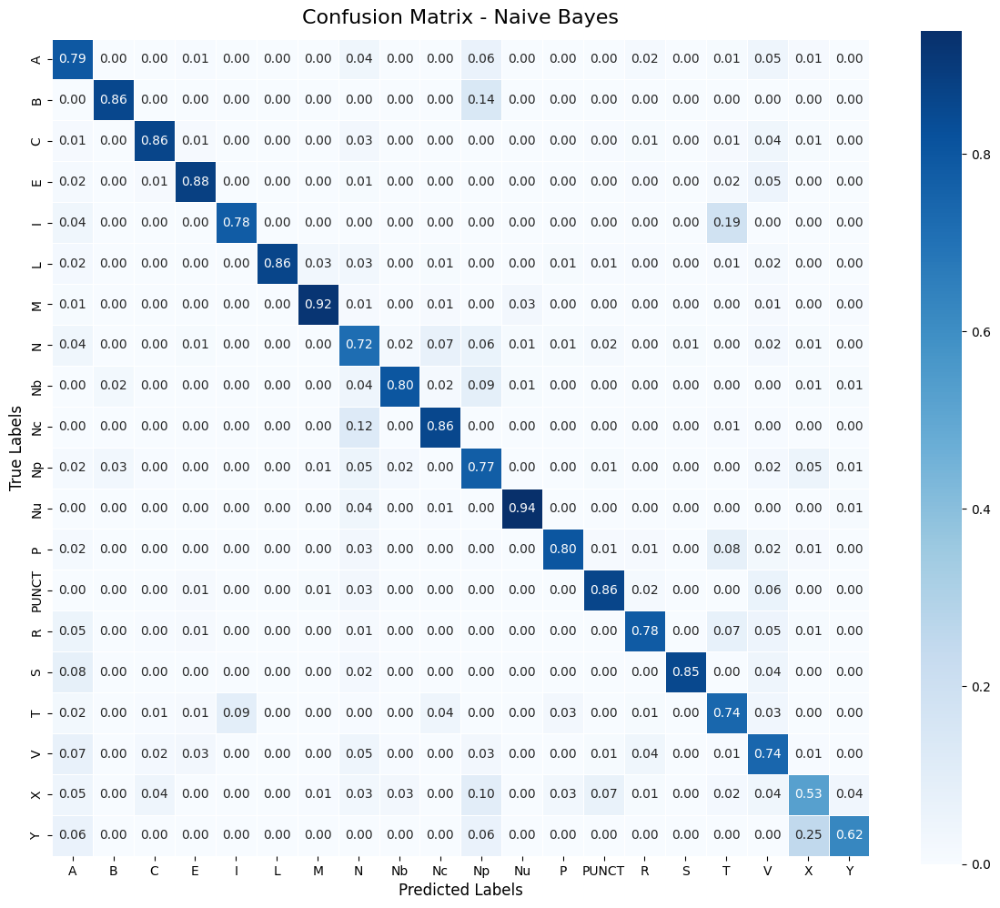

              precision    recall  f1-score   support

           A       0.61      0.79      0.69      4027
           B       0.07      0.86      0.13         7
           C       0.84      0.86      0.85      2367
           E       0.83      0.88      0.85      4061
           I       0.29      0.78      0.42        27
           L       1.00      0.86      0.93      1180
           M       0.92      0.92      0.92      2425
           N       0.87      0.72      0.79     15462
          Nb       0.19      0.80      0.31       121
          Nc       0.53      0.86      0.66      1634
          Np       0.54      0.77      0.64      2555
          Nu       0.60      0.94      0.73       310
           P       0.91      0.80      0.85      2779
       PUNCT       0.94      0.86      0.90      9632
           R       0.81      0.78      0.79      4746
           S       0.21      0.85      0.34        48
           T       0.26      0.74      0.38       422
           V       0.84    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


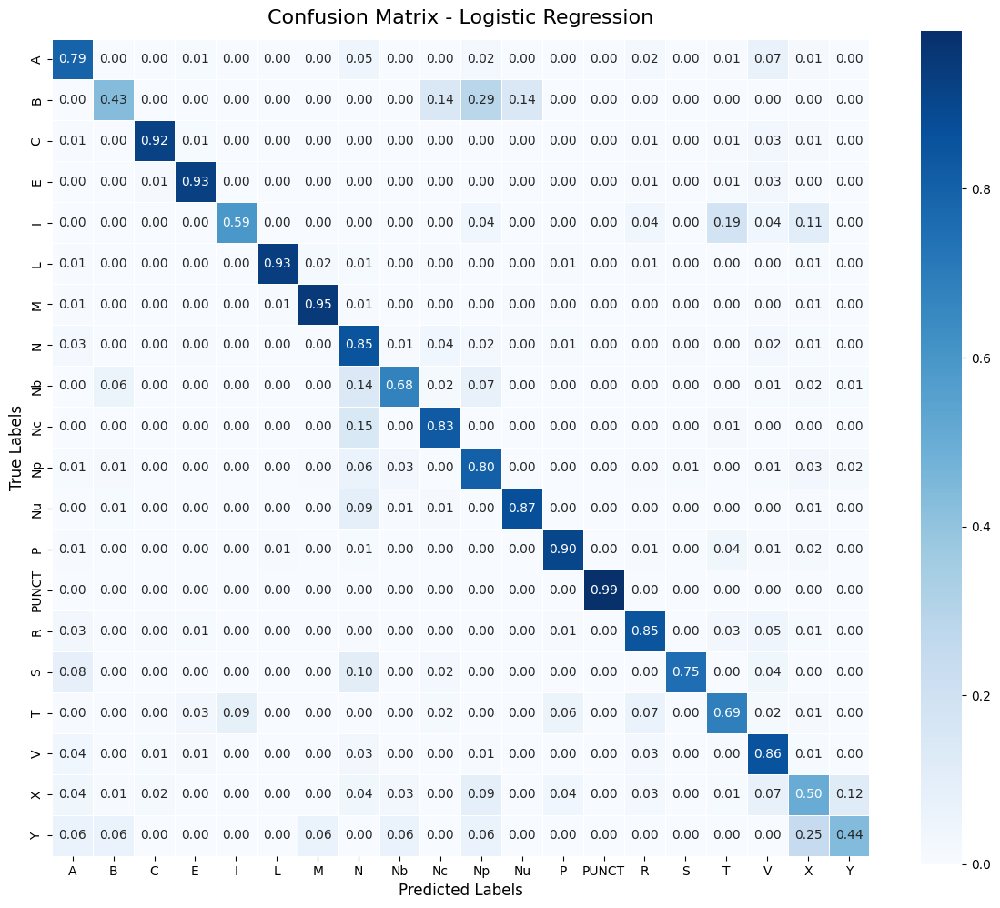

              precision    recall  f1-score   support

           A       0.73      0.79      0.76      4027
           B       0.05      0.43      0.08         7
           C       0.90      0.92      0.91      2367
           E       0.91      0.93      0.92      4061
           I       0.27      0.59      0.37        27
           L       0.93      0.93      0.93      1180
           M       0.97      0.95      0.96      2425
           N       0.92      0.85      0.88     15462
          Nb       0.31      0.68      0.42       121
          Nc       0.69      0.83      0.75      1634
          Np       0.78      0.80      0.79      2555
          Nu       0.74      0.87      0.80       310
           P       0.89      0.90      0.90      2779
       PUNCT       1.00      0.99      0.99      9632
           R       0.87      0.85      0.86      4746
           S       0.22      0.75      0.34        48
           T       0.38      0.69      0.49       422
           V       0.90    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### MLP

Train samples: 152252, Test samples: 65251
Train batches: 4758, Test batches: 1020


Epoch 1/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.8254 | Test Loss=2.5930 | Test Acc=0.5186
New best model saved (test_acc=0.5186)


Epoch 2/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=2.2030 | Test Loss=1.8805 | Test Acc=0.5975
New best model saved (test_acc=0.5975)


Epoch 3/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.5407 | Test Loss=1.3315 | Test Acc=0.6760
New best model saved (test_acc=0.6760)


Epoch 4/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=1.1191 | Test Loss=1.0259 | Test Acc=0.7374
New best model saved (test_acc=0.7374)


Epoch 5/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=0.8901 | Test Loss=0.8545 | Test Acc=0.7789
New best model saved (test_acc=0.7789)


Epoch 6/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.7655 | Test Loss=0.7482 | Test Acc=0.7992
New best model saved (test_acc=0.7992)


Epoch 7/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.6795 | Test Loss=0.6745 | Test Acc=0.8184
New best model saved (test_acc=0.8184)


Epoch 8/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.6208 | Test Loss=0.6203 | Test Acc=0.8296
New best model saved (test_acc=0.8296)


Epoch 9/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.5780 | Test Loss=0.5790 | Test Acc=0.8340
New best model saved (test_acc=0.8340)


Epoch 10/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5440 | Test Loss=0.5485 | Test Acc=0.8376
New best model saved (test_acc=0.8376)


Epoch 11/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.5193 | Test Loss=0.5235 | Test Acc=0.8469
New best model saved (test_acc=0.8469)


Epoch 12/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.4988 | Test Loss=0.5039 | Test Acc=0.8502
New best model saved (test_acc=0.8502)


Epoch 13/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.4833 | Test Loss=0.4874 | Test Acc=0.8516
New best model saved (test_acc=0.8516)


Epoch 14/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4624 | Test Loss=0.4742 | Test Acc=0.8552
New best model saved (test_acc=0.8552)


Epoch 15/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4519 | Test Loss=0.4628 | Test Acc=0.8584
New best model saved (test_acc=0.8584)


Epoch 16/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4430 | Test Loss=0.4522 | Test Acc=0.8590
New best model saved (test_acc=0.8590)


Epoch 17/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4357 | Test Loss=0.4431 | Test Acc=0.8619
New best model saved (test_acc=0.8619)


Epoch 18/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4266 | Test Loss=0.4365 | Test Acc=0.8622
New best model saved (test_acc=0.8622)


Epoch 19/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4181 | Test Loss=0.4302 | Test Acc=0.8647
New best model saved (test_acc=0.8647)


Epoch 20/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.4099 | Test Loss=0.4250 | Test Acc=0.8648
New best model saved (test_acc=0.8648)


Epoch 21/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.4024 | Test Loss=0.4195 | Test Acc=0.8660
New best model saved (test_acc=0.8660)


Epoch 22/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.3978 | Test Loss=0.4144 | Test Acc=0.8666
New best model saved (test_acc=0.8666)


Epoch 23/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.3942 | Test Loss=0.4100 | Test Acc=0.8686
New best model saved (test_acc=0.8686)


Epoch 24/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.3886 | Test Loss=0.4060 | Test Acc=0.8700
New best model saved (test_acc=0.8700)


Epoch 25/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.3806 | Test Loss=0.4023 | Test Acc=0.8697


Epoch 26/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.3747 | Test Loss=0.3979 | Test Acc=0.8727
New best model saved (test_acc=0.8727)


Epoch 27/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.3718 | Test Loss=0.3957 | Test Acc=0.8721


Epoch 28/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3672 | Test Loss=0.3934 | Test Acc=0.8721


Epoch 29/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3583 | Test Loss=0.3907 | Test Acc=0.8728
New best model saved (test_acc=0.8728)


Epoch 30/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3588 | Test Loss=0.3881 | Test Acc=0.8741
New best model saved (test_acc=0.8741)


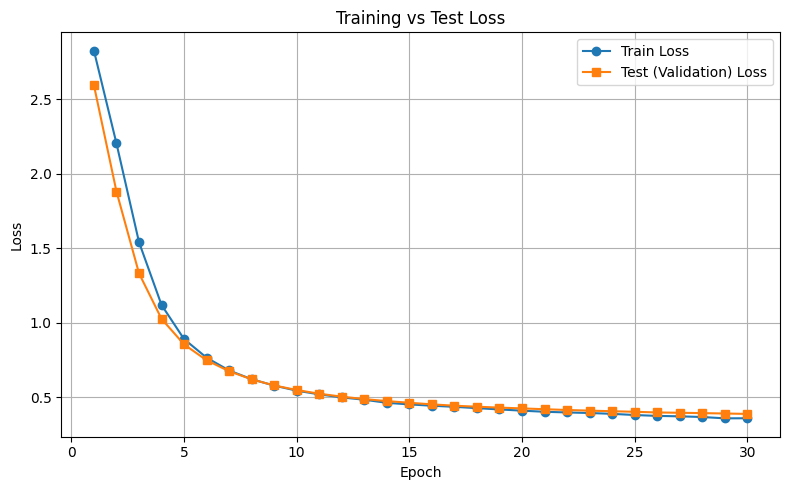

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1020 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8741


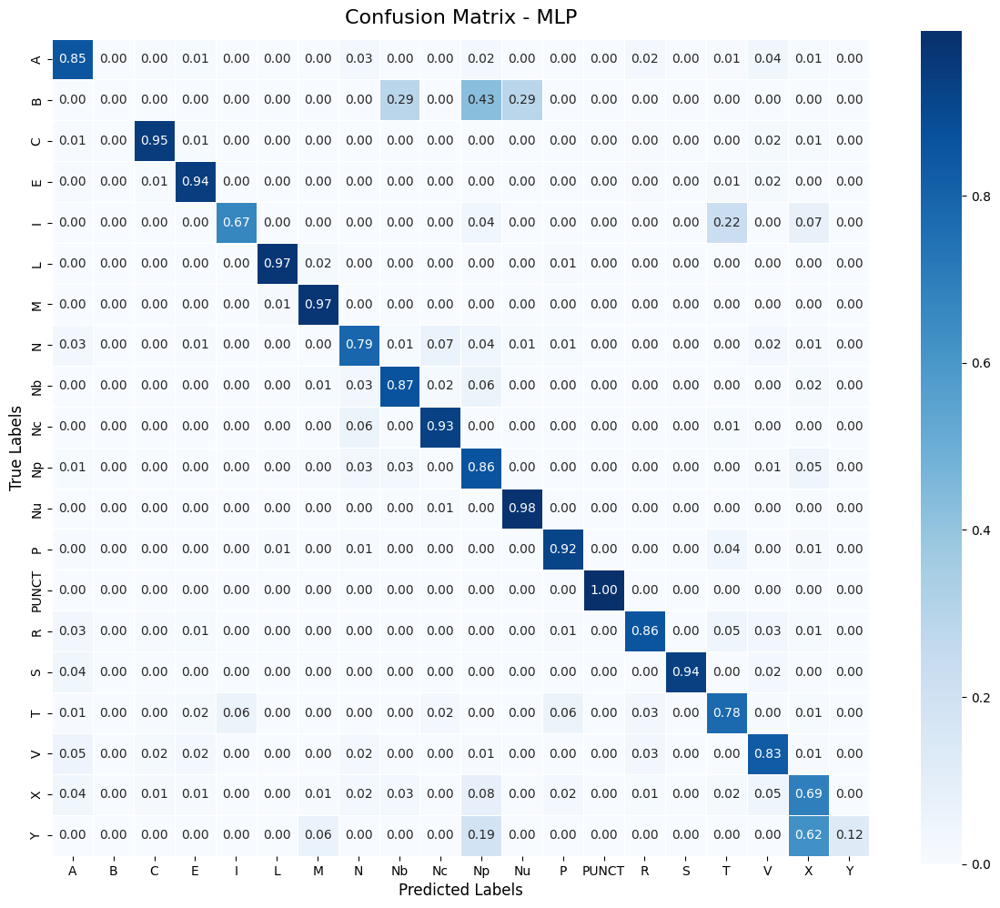

              precision    recall  f1-score   support

           A       0.70      0.85      0.77      4027
           B       0.00      0.00      0.00         7
           C       0.87      0.95      0.91      2367
           E       0.89      0.94      0.92      4061
           I       0.37      0.67      0.47        27
           L       0.92      0.97      0.94      1180
           M       0.96      0.97      0.97      2425
           N       0.95      0.79      0.86     15462
          Nb       0.30      0.87      0.45       121
          Nc       0.58      0.93      0.72      1634
          Np       0.72      0.86      0.79      2555
          Nu       0.64      0.98      0.78       310
           P       0.91      0.92      0.91      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.87      0.86      0.86      4746
           S       0.38      0.94      0.54        48
           T       0.39      0.78      0.52       422
           V       0.93    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1], weighted=True)

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002
Decomposed data (By PCA)
Train shape: (130501, 256), Test shape: (87002, 256)


### Naive Bayes

Fitting
Predicting


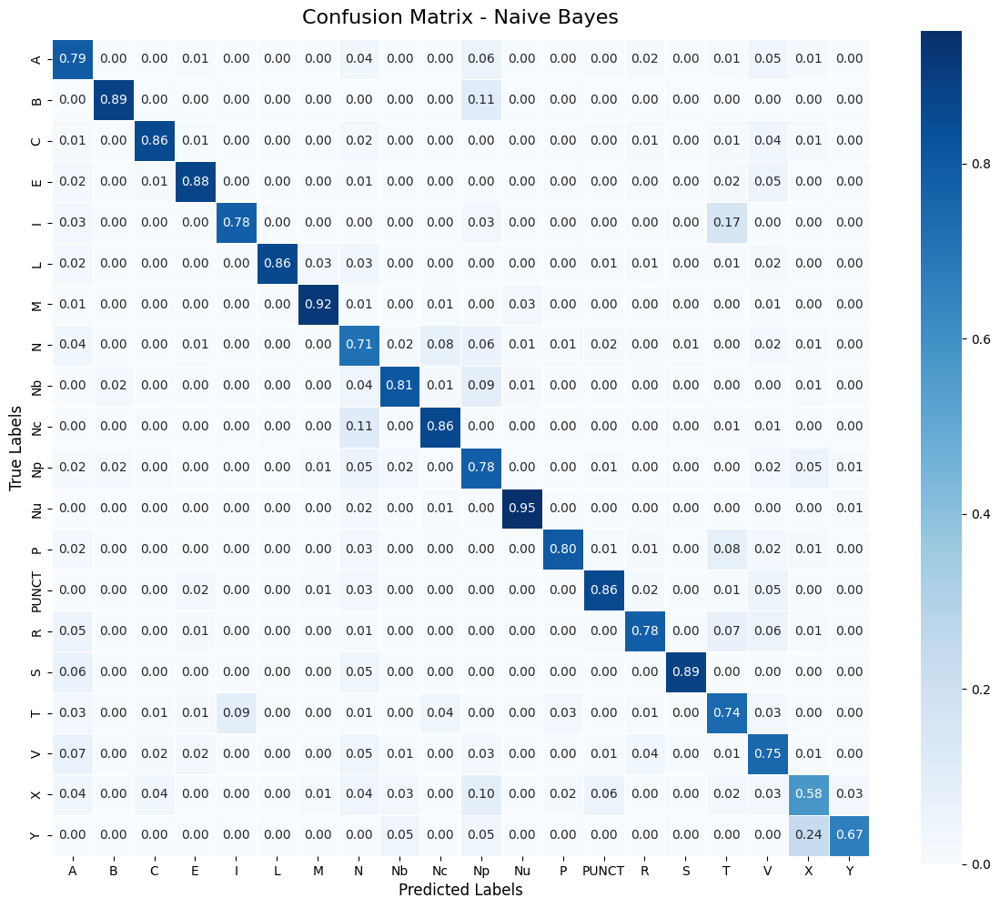

              precision    recall  f1-score   support

           A       0.62      0.79      0.69      5370
           B       0.11      0.89      0.19         9
           C       0.84      0.86      0.85      3156
           E       0.82      0.88      0.85      5415
           I       0.29      0.78      0.42        36
           L       0.99      0.86      0.92      1574
           M       0.93      0.92      0.92      3233
           N       0.87      0.71      0.78     20616
          Nb       0.18      0.81      0.30       161
          Nc       0.53      0.86      0.65      2179
          Np       0.55      0.78      0.65      3406
          Nu       0.59      0.95      0.73       413
           P       0.91      0.80      0.85      3705
       PUNCT       0.94      0.86      0.90     12843
           R       0.81      0.78      0.80      6328
           S       0.22      0.89      0.35        64
           T       0.25      0.74      0.38       563
           V       0.84    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


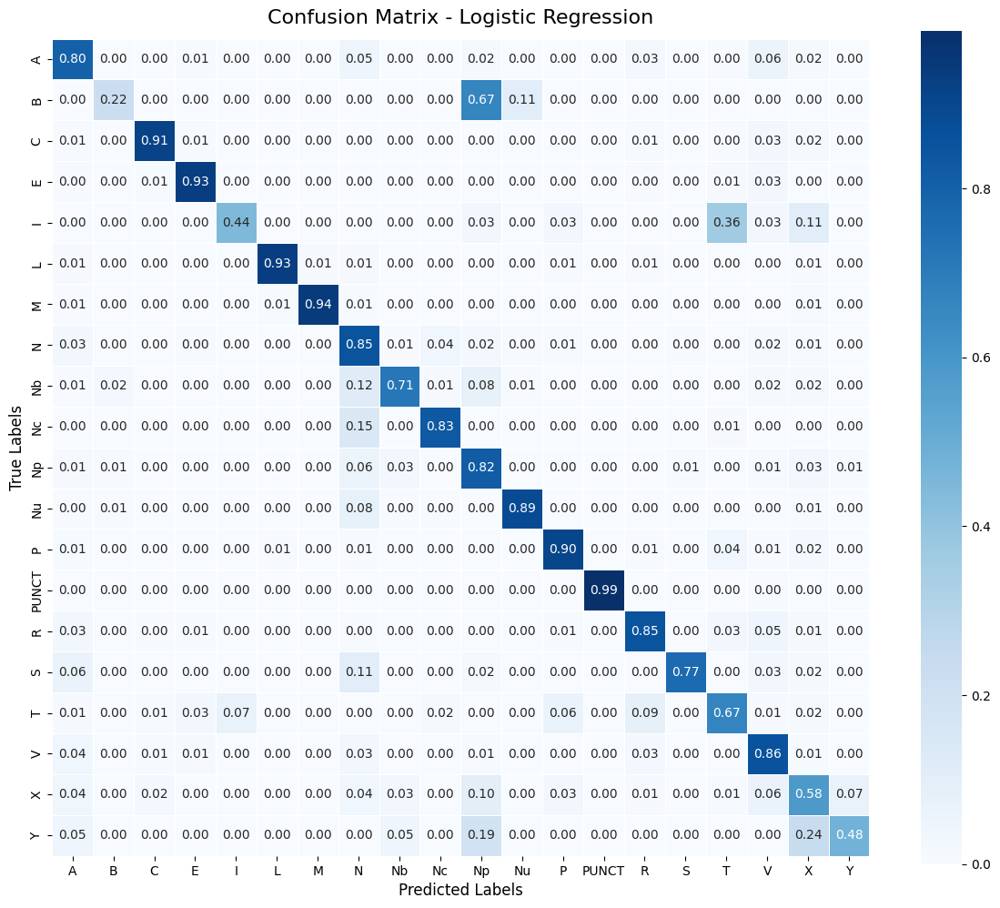

              precision    recall  f1-score   support

           A       0.73      0.80      0.76      5370
           B       0.05      0.22      0.09         9
           C       0.89      0.91      0.90      3156
           E       0.91      0.93      0.92      5415
           I       0.25      0.44      0.32        36
           L       0.93      0.93      0.93      1574
           M       0.97      0.94      0.96      3233
           N       0.92      0.85      0.88     20616
          Nb       0.30      0.71      0.43       161
          Nc       0.70      0.83      0.76      2179
          Np       0.78      0.82      0.80      3406
          Nu       0.76      0.89      0.82       413
           P       0.90      0.90      0.90      3705
       PUNCT       1.00      0.99      0.99     12843
           R       0.87      0.85      0.86      6328
           S       0.23      0.77      0.35        64
           T       0.40      0.67      0.50       563
           V       0.91    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### MLP

Train samples: 130501, Test samples: 87002
Train batches: 4079, Test batches: 1360


Epoch 1/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.8656 | Test Loss=2.6866 | Test Acc=0.4715
New best model saved (test_acc=0.4715)


Epoch 2/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=2.3626 | Test Loss=2.0684 | Test Acc=0.5875
New best model saved (test_acc=0.5875)


Epoch 3/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.7372 | Test Loss=1.5026 | Test Acc=0.6519
New best model saved (test_acc=0.6519)


Epoch 4/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=1.2739 | Test Loss=1.1446 | Test Acc=0.7094
New best model saved (test_acc=0.7094)


Epoch 5/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=1.0058 | Test Loss=0.9430 | Test Acc=0.7537
New best model saved (test_acc=0.7537)


Epoch 6/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.8484 | Test Loss=0.8182 | Test Acc=0.7822
New best model saved (test_acc=0.7822)


Epoch 7/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.7529 | Test Loss=0.7286 | Test Acc=0.8025
New best model saved (test_acc=0.8025)


Epoch 8/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.6825 | Test Loss=0.6635 | Test Acc=0.8153
New best model saved (test_acc=0.8153)


Epoch 9/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.6320 | Test Loss=0.6144 | Test Acc=0.8263
New best model saved (test_acc=0.8263)


Epoch 10/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.5898 | Test Loss=0.5779 | Test Acc=0.8340
New best model saved (test_acc=0.8340)


Epoch 11/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.5578 | Test Loss=0.5479 | Test Acc=0.8385
New best model saved (test_acc=0.8385)


Epoch 12/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.5326 | Test Loss=0.5253 | Test Acc=0.8434
New best model saved (test_acc=0.8434)


Epoch 13/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.5151 | Test Loss=0.5064 | Test Acc=0.8461
New best model saved (test_acc=0.8461)


Epoch 14/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.4961 | Test Loss=0.4908 | Test Acc=0.8533
New best model saved (test_acc=0.8533)


Epoch 15/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.4815 | Test Loss=0.4769 | Test Acc=0.8543
New best model saved (test_acc=0.8543)


Epoch 16/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.4680 | Test Loss=0.4659 | Test Acc=0.8578
New best model saved (test_acc=0.8578)


Epoch 17/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.4580 | Test Loss=0.4564 | Test Acc=0.8580
New best model saved (test_acc=0.8580)


Epoch 18/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.4476 | Test Loss=0.4481 | Test Acc=0.8594
New best model saved (test_acc=0.8594)


Epoch 19/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.4383 | Test Loss=0.4406 | Test Acc=0.8612
New best model saved (test_acc=0.8612)


Epoch 20/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.4289 | Test Loss=0.4339 | Test Acc=0.8627
New best model saved (test_acc=0.8627)


Epoch 21/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.4231 | Test Loss=0.4280 | Test Acc=0.8629
New best model saved (test_acc=0.8629)


Epoch 22/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.4128 | Test Loss=0.4234 | Test Acc=0.8654
New best model saved (test_acc=0.8654)


Epoch 23/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.4136 | Test Loss=0.4174 | Test Acc=0.8665
New best model saved (test_acc=0.8665)


Epoch 24/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.4019 | Test Loss=0.4134 | Test Acc=0.8677
New best model saved (test_acc=0.8677)


Epoch 25/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.3966 | Test Loss=0.4099 | Test Acc=0.8692
New best model saved (test_acc=0.8692)


Epoch 26/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.3916 | Test Loss=0.4063 | Test Acc=0.8693
New best model saved (test_acc=0.8693)


Epoch 27/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.3842 | Test Loss=0.4032 | Test Acc=0.8718
New best model saved (test_acc=0.8718)


Epoch 28/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.3847 | Test Loss=0.3994 | Test Acc=0.8736
New best model saved (test_acc=0.8736)


Epoch 29/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.3792 | Test Loss=0.3964 | Test Acc=0.8727


Epoch 30/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.3749 | Test Loss=0.3933 | Test Acc=0.8728


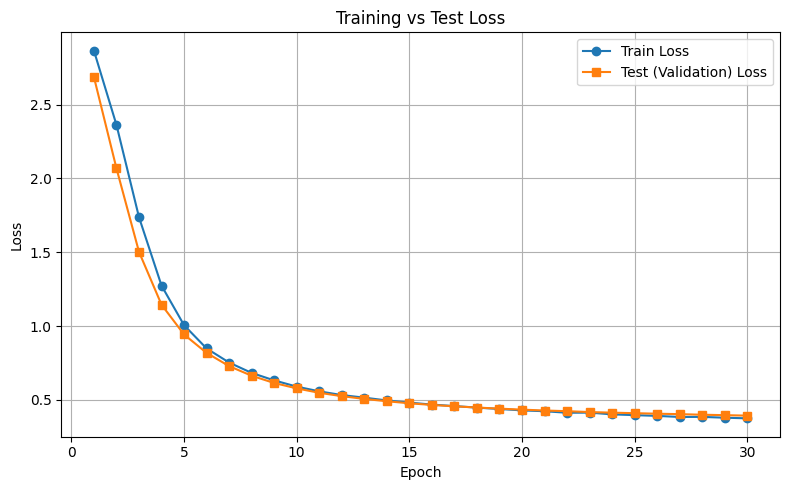

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1360 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8736


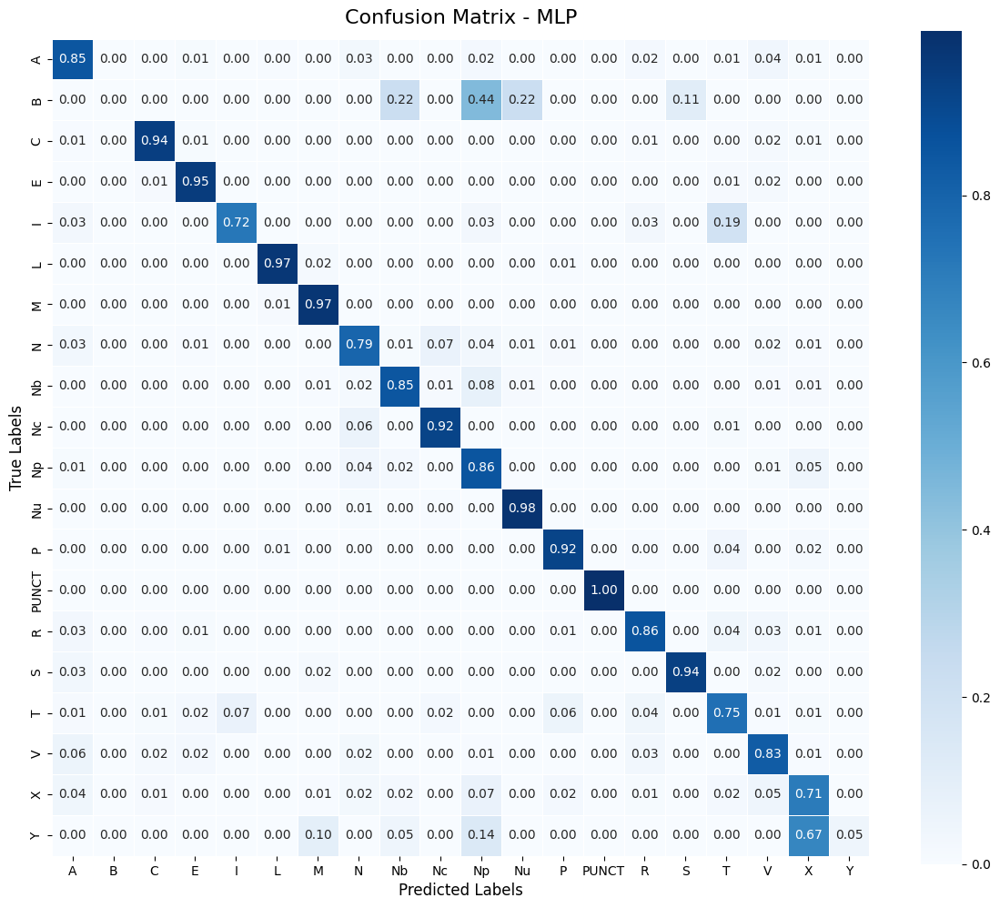

              precision    recall  f1-score   support

           A       0.70      0.85      0.77      5370
           B       0.00      0.00      0.00         9
           C       0.87      0.94      0.91      3156
           E       0.89      0.95      0.92      5415
           I       0.34      0.72      0.46        36
           L       0.90      0.97      0.93      1574
           M       0.96      0.97      0.97      3233
           N       0.95      0.79      0.86     20616
          Nb       0.30      0.85      0.44       161
          Nc       0.58      0.92      0.71      2179
          Np       0.73      0.86      0.79      3406
          Nu       0.65      0.98      0.78       413
           P       0.90      0.92      0.91      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.87      0.86      0.86      6328
           S       0.39      0.94      0.55        64
           T       0.39      0.75      0.51       563
           V       0.93    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1], weighted=True)

# Run classification (weighted) - 64D

In [ ]:
N_COMPONENTS_PCA_MODEL = 64

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501
Decomposed data (By PCA)
Train shape: (174002, 64), Test shape: (43501, 64)


### Naive Bayes

Fitting
Predicting


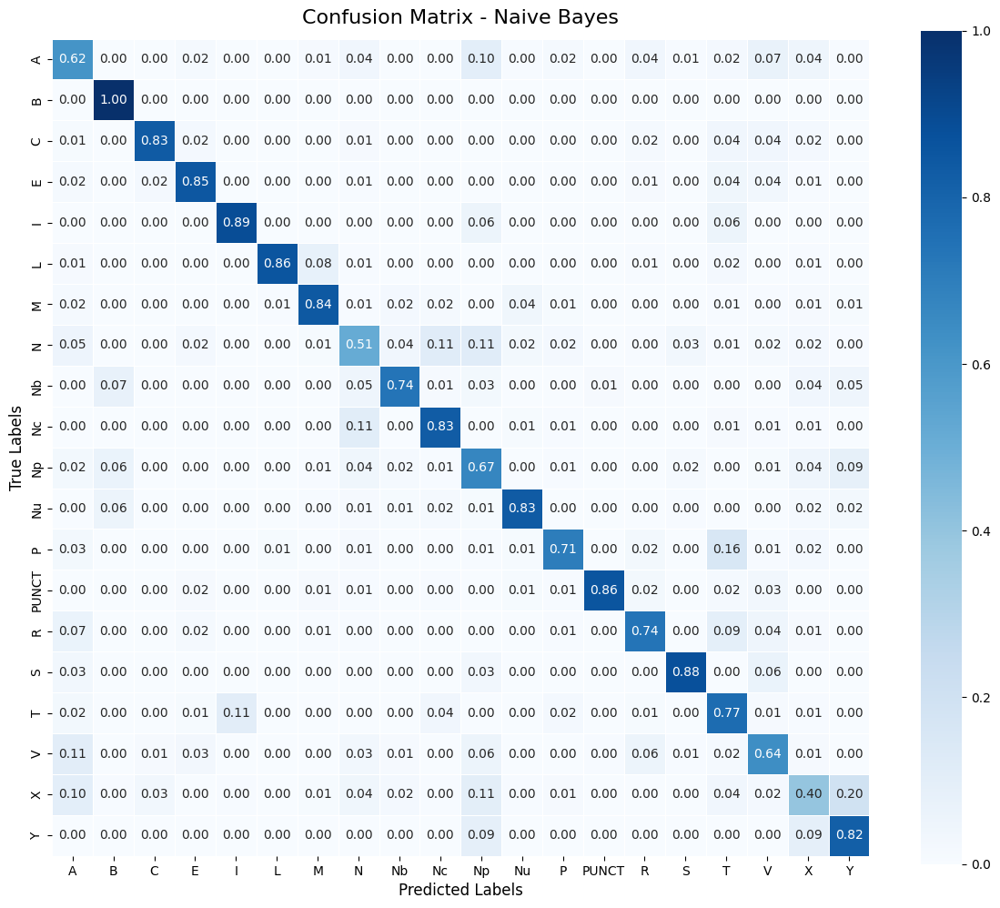

              precision    recall  f1-score   support

           A       0.46      0.62      0.53      2685
           B       0.02      1.00      0.05         4
           C       0.85      0.83      0.84      1578
           E       0.77      0.85      0.81      2708
           I       0.21      0.89      0.34        18
           L       0.93      0.86      0.89       787
           M       0.80      0.84      0.82      1617
           N       0.88      0.51      0.65     10308
          Nb       0.09      0.74      0.16        80
          Nc       0.41      0.83      0.55      1090
          Np       0.36      0.67      0.47      1703
          Nu       0.28      0.83      0.42       206
           P       0.77      0.71      0.74      1853
       PUNCT       0.99      0.86      0.92      6421
           R       0.72      0.74      0.73      3164
           S       0.06      0.88      0.11        32
           T       0.15      0.77      0.25       281
           V       0.85    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


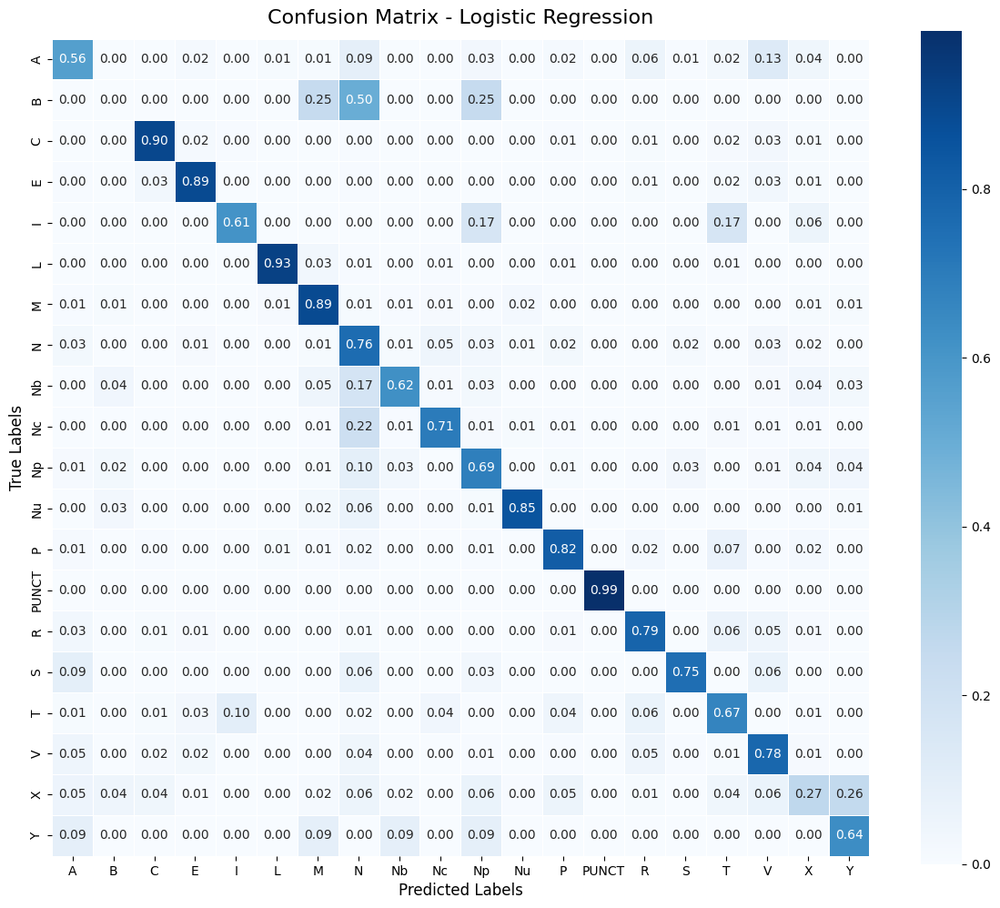

              precision    recall  f1-score   support

           A       0.63      0.56      0.59      2685
           B       0.00      0.00      0.00         4
           C       0.80      0.90      0.85      1578
           E       0.83      0.89      0.86      2708
           I       0.17      0.61      0.27        18
           L       0.91      0.93      0.92       787
           M       0.86      0.89      0.88      1617
           N       0.87      0.76      0.81     10308
          Nb       0.19      0.62      0.29        80
          Nc       0.59      0.71      0.64      1090
          Np       0.68      0.69      0.68      1703
          Nu       0.54      0.85      0.66       206
           P       0.77      0.82      0.79      1853
       PUNCT       1.00      0.99      0.99      6421
           R       0.78      0.79      0.79      3164
           S       0.08      0.75      0.15        32
           T       0.23      0.67      0.35       281
           V       0.87    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### MLP

Train samples: 174002, Test samples: 43501
Train batches: 5438, Test batches: 680


Epoch 1/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.7093 | Test Loss=2.3888 | Test Acc=0.5759
New best model saved (test_acc=0.5759)


Epoch 2/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=2.0026 | Test Loss=1.7069 | Test Acc=0.6614
New best model saved (test_acc=0.6614)


Epoch 3/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.4605 | Test Loss=1.3013 | Test Acc=0.7043
New best model saved (test_acc=0.7043)


Epoch 4/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=1.1680 | Test Loss=1.0823 | Test Acc=0.7289
New best model saved (test_acc=0.7289)


Epoch 5/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=1.0114 | Test Loss=0.9565 | Test Acc=0.7489
New best model saved (test_acc=0.7489)


Epoch 6/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.9120 | Test Loss=0.8727 | Test Acc=0.7594
New best model saved (test_acc=0.7594)


Epoch 7/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.8488 | Test Loss=0.8131 | Test Acc=0.7670
New best model saved (test_acc=0.7670)


Epoch 8/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.8065 | Test Loss=0.7684 | Test Acc=0.7737
New best model saved (test_acc=0.7737)


Epoch 9/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.7711 | Test Loss=0.7346 | Test Acc=0.7776
New best model saved (test_acc=0.7776)


Epoch 10/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.7440 | Test Loss=0.7069 | Test Acc=0.7815
New best model saved (test_acc=0.7815)


Epoch 11/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.7234 | Test Loss=0.6844 | Test Acc=0.7851
New best model saved (test_acc=0.7851)


Epoch 12/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.7002 | Test Loss=0.6656 | Test Acc=0.7881
New best model saved (test_acc=0.7881)


Epoch 13/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.6851 | Test Loss=0.6503 | Test Acc=0.7892
New best model saved (test_acc=0.7892)


Epoch 14/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.6751 | Test Loss=0.6372 | Test Acc=0.7942
New best model saved (test_acc=0.7942)


Epoch 15/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.6592 | Test Loss=0.6255 | Test Acc=0.7935


Epoch 16/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.6495 | Test Loss=0.6141 | Test Acc=0.7968
New best model saved (test_acc=0.7968)


Epoch 17/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.6409 | Test Loss=0.6043 | Test Acc=0.7995
New best model saved (test_acc=0.7995)


Epoch 18/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.6319 | Test Loss=0.5971 | Test Acc=0.8027
New best model saved (test_acc=0.8027)


Epoch 19/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.6221 | Test Loss=0.5889 | Test Acc=0.8015


Epoch 20/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.6153 | Test Loss=0.5820 | Test Acc=0.8029
New best model saved (test_acc=0.8029)


Epoch 21/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.6044 | Test Loss=0.5753 | Test Acc=0.8061
New best model saved (test_acc=0.8061)


Epoch 22/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.5998 | Test Loss=0.5699 | Test Acc=0.8072
New best model saved (test_acc=0.8072)


Epoch 23/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.5970 | Test Loss=0.5641 | Test Acc=0.8073
New best model saved (test_acc=0.8073)


Epoch 24/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.5882 | Test Loss=0.5566 | Test Acc=0.8076
New best model saved (test_acc=0.8076)


Epoch 25/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.5817 | Test Loss=0.5521 | Test Acc=0.8081
New best model saved (test_acc=0.8081)


Epoch 26/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.5767 | Test Loss=0.5477 | Test Acc=0.8103
New best model saved (test_acc=0.8103)


Epoch 27/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.5719 | Test Loss=0.5432 | Test Acc=0.8133
New best model saved (test_acc=0.8133)


Epoch 28/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.5676 | Test Loss=0.5389 | Test Acc=0.8145
New best model saved (test_acc=0.8145)


Epoch 29/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.5624 | Test Loss=0.5339 | Test Acc=0.8124


Epoch 30/30 - train:   0%|          | 0/5438 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.5624 | Test Loss=0.5300 | Test Acc=0.8155
New best model saved (test_acc=0.8155)


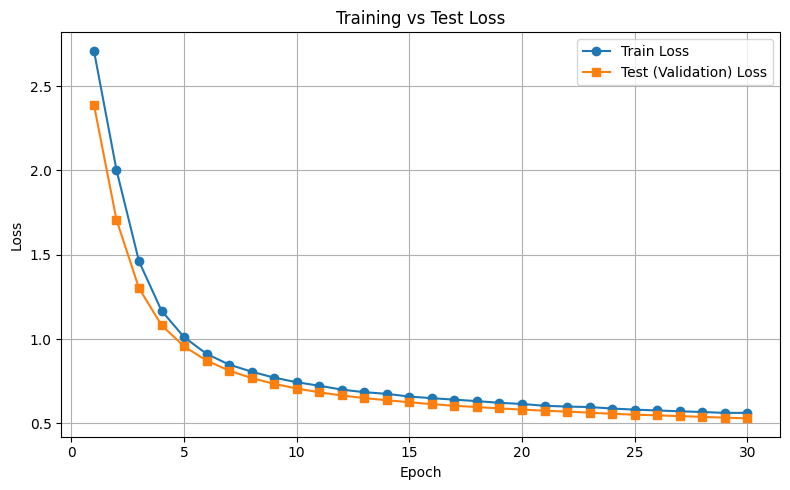

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/680 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8155


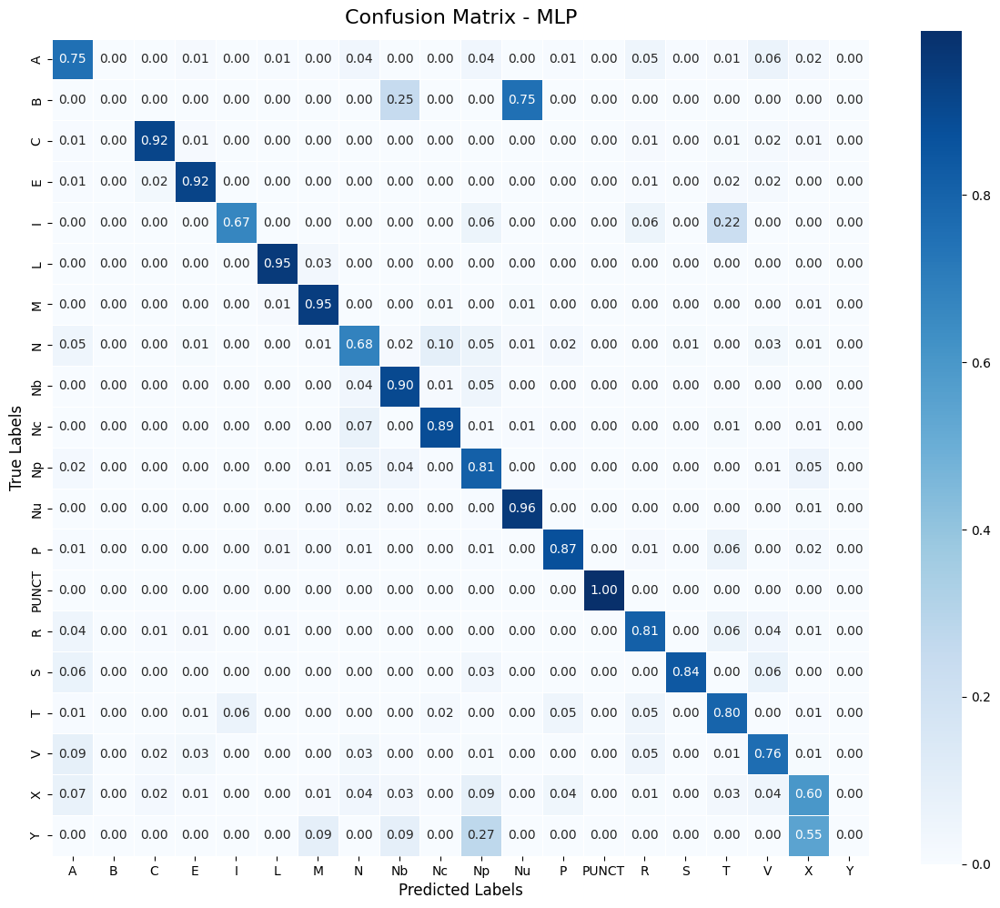

              precision    recall  f1-score   support

           A       0.58      0.75      0.65      2685
           B       0.00      0.00      0.00         4
           C       0.83      0.92      0.87      1578
           E       0.85      0.92      0.89      2708
           I       0.28      0.67      0.39        18
           L       0.88      0.95      0.92       787
           M       0.91      0.95      0.93      1617
           N       0.93      0.68      0.79     10308
          Nb       0.20      0.90      0.33        80
          Nc       0.48      0.89      0.62      1090
          Np       0.63      0.81      0.71      1703
          Nu       0.53      0.96      0.68       206
           P       0.84      0.87      0.86      1853
       PUNCT       1.00      1.00      1.00      6421
           R       0.81      0.81      0.81      3164
           S       0.16      0.84      0.26        32
           T       0.32      0.80      0.45       281
           V       0.91    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1], weighted=True)

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251
Decomposed data (By PCA)
Train shape: (152252, 64), Test shape: (65251, 64)


### Naive Bayes

Fitting
Predicting


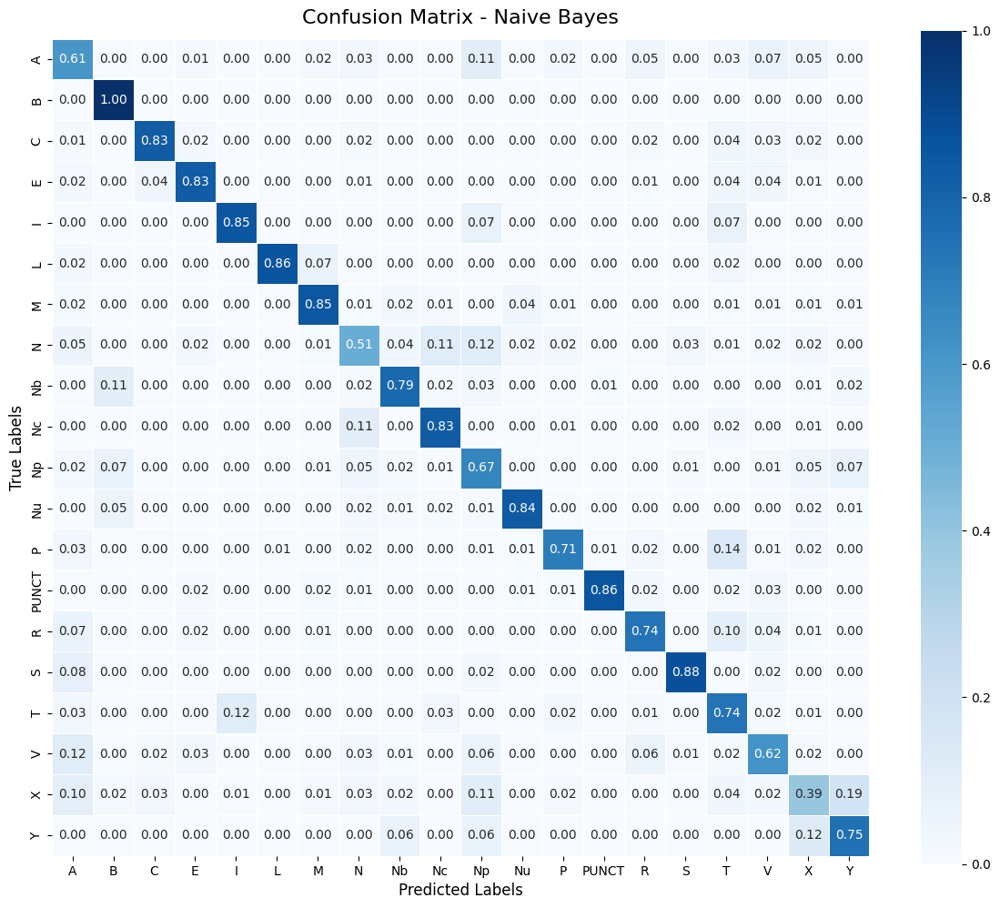

              precision    recall  f1-score   support

           A       0.45      0.61      0.51      4027
           B       0.03      1.00      0.05         7
           C       0.78      0.83      0.81      2367
           E       0.76      0.83      0.79      4061
           I       0.19      0.85      0.31        27
           L       0.94      0.86      0.90      1180
           M       0.78      0.85      0.81      2425
           N       0.87      0.51      0.64     15462
          Nb       0.10      0.79      0.18       121
          Nc       0.41      0.83      0.55      1634
          Np       0.36      0.67      0.47      2555
          Nu       0.31      0.84      0.45       310
           P       0.75      0.71      0.73      2779
       PUNCT       0.98      0.86      0.92      9632
           R       0.71      0.74      0.73      4746
           S       0.06      0.88      0.11        48
           T       0.15      0.74      0.25       422
           V       0.85    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


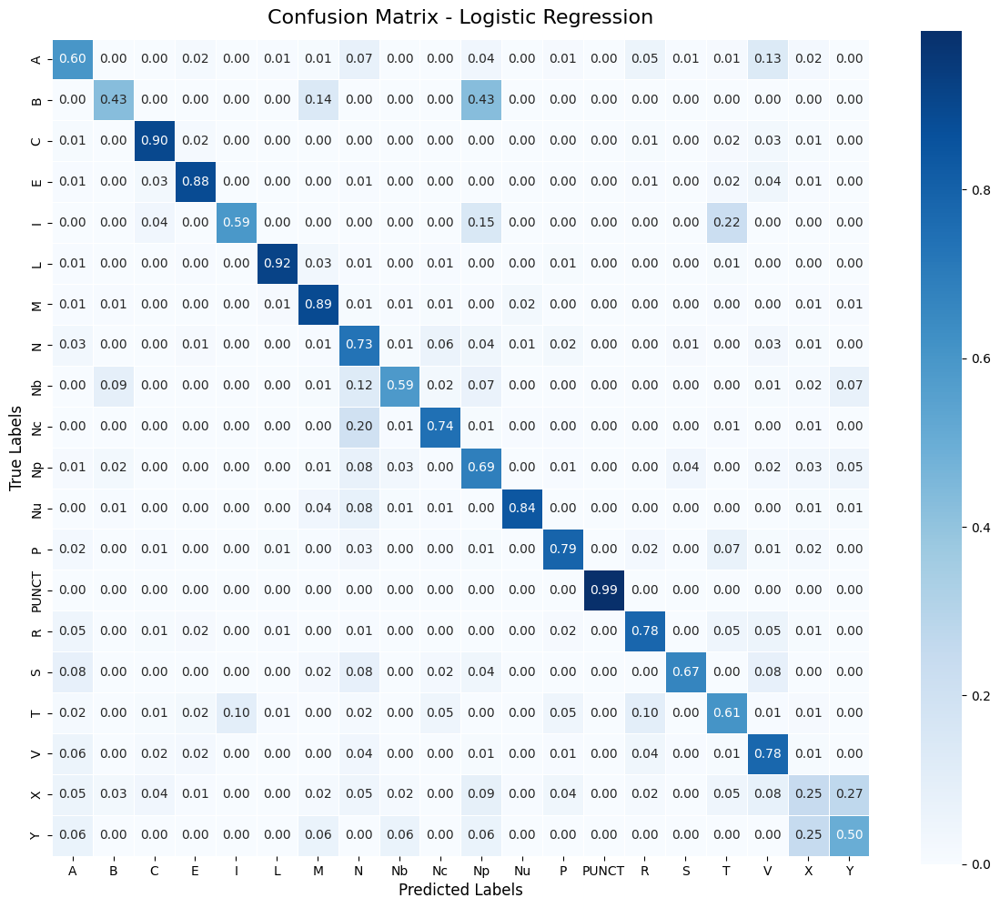

              precision    recall  f1-score   support

           A       0.59      0.60      0.60      4027
           B       0.02      0.43      0.04         7
           C       0.81      0.90      0.85      2367
           E       0.83      0.88      0.86      4061
           I       0.21      0.59      0.30        27
           L       0.88      0.92      0.90      1180
           M       0.87      0.89      0.88      2425
           N       0.88      0.73      0.80     15462
          Nb       0.17      0.59      0.27       121
          Nc       0.53      0.74      0.62      1634
          Np       0.63      0.69      0.66      2555
          Nu       0.55      0.84      0.66       310
           P       0.76      0.79      0.78      2779
       PUNCT       1.00      0.99      0.99      9632
           R       0.79      0.78      0.79      4746
           S       0.07      0.67      0.13        48
           T       0.23      0.61      0.33       422
           V       0.86    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### MLP

Train samples: 152252, Test samples: 65251
Train batches: 4758, Test batches: 1020


Epoch 1/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.7207 | Test Loss=2.4236 | Test Acc=0.5523
New best model saved (test_acc=0.5523)


Epoch 2/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=2.0780 | Test Loss=1.8326 | Test Acc=0.6297
New best model saved (test_acc=0.6297)


Epoch 3/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.5807 | Test Loss=1.4314 | Test Acc=0.6727
New best model saved (test_acc=0.6727)


Epoch 4/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=1.2707 | Test Loss=1.1925 | Test Acc=0.7036
New best model saved (test_acc=0.7036)


Epoch 5/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=1.0914 | Test Loss=1.0477 | Test Acc=0.7223
New best model saved (test_acc=0.7223)


Epoch 6/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=0.9842 | Test Loss=0.9531 | Test Acc=0.7376
New best model saved (test_acc=0.7376)


Epoch 7/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.9072 | Test Loss=0.8853 | Test Acc=0.7467
New best model saved (test_acc=0.7467)


Epoch 8/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.8552 | Test Loss=0.8354 | Test Acc=0.7560
New best model saved (test_acc=0.7560)


Epoch 9/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.8146 | Test Loss=0.7964 | Test Acc=0.7609
New best model saved (test_acc=0.7609)


Epoch 10/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.7828 | Test Loss=0.7651 | Test Acc=0.7653
New best model saved (test_acc=0.7653)


Epoch 11/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.7607 | Test Loss=0.7393 | Test Acc=0.7718
New best model saved (test_acc=0.7718)


Epoch 12/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.7409 | Test Loss=0.7179 | Test Acc=0.7744
New best model saved (test_acc=0.7744)


Epoch 13/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.7201 | Test Loss=0.7003 | Test Acc=0.7781
New best model saved (test_acc=0.7781)


Epoch 14/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.7015 | Test Loss=0.6851 | Test Acc=0.7847
New best model saved (test_acc=0.7847)


Epoch 15/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.6959 | Test Loss=0.6707 | Test Acc=0.7845


Epoch 16/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.6770 | Test Loss=0.6588 | Test Acc=0.7858
New best model saved (test_acc=0.7858)


Epoch 17/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.6681 | Test Loss=0.6488 | Test Acc=0.7910
New best model saved (test_acc=0.7910)


Epoch 18/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.6576 | Test Loss=0.6381 | Test Acc=0.7909


Epoch 19/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.6499 | Test Loss=0.6301 | Test Acc=0.7947
New best model saved (test_acc=0.7947)


Epoch 20/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.6402 | Test Loss=0.6214 | Test Acc=0.7947


Epoch 21/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.6308 | Test Loss=0.6134 | Test Acc=0.7958
New best model saved (test_acc=0.7958)


Epoch 22/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.6231 | Test Loss=0.6075 | Test Acc=0.7975
New best model saved (test_acc=0.7975)


Epoch 23/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.6196 | Test Loss=0.6002 | Test Acc=0.7956


Epoch 24/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.6151 | Test Loss=0.5944 | Test Acc=0.8018
New best model saved (test_acc=0.8018)


Epoch 25/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.6011 | Test Loss=0.5892 | Test Acc=0.8029
New best model saved (test_acc=0.8029)


Epoch 26/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.6009 | Test Loss=0.5823 | Test Acc=0.8007


Epoch 27/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.5975 | Test Loss=0.5778 | Test Acc=0.8063
New best model saved (test_acc=0.8063)


Epoch 28/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.5926 | Test Loss=0.5732 | Test Acc=0.8066
New best model saved (test_acc=0.8066)


Epoch 29/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.5858 | Test Loss=0.5688 | Test Acc=0.8069
New best model saved (test_acc=0.8069)


Epoch 30/30 - train:   0%|          | 0/4758 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.5779 | Test Loss=0.5647 | Test Acc=0.8061


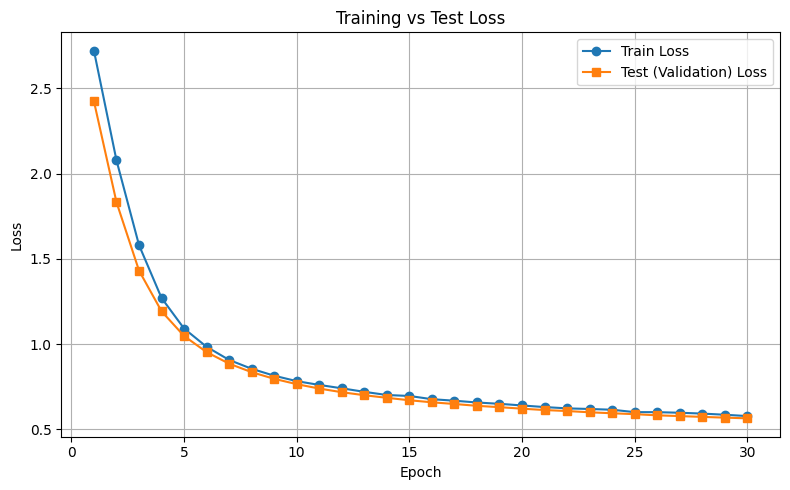

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1020 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8069


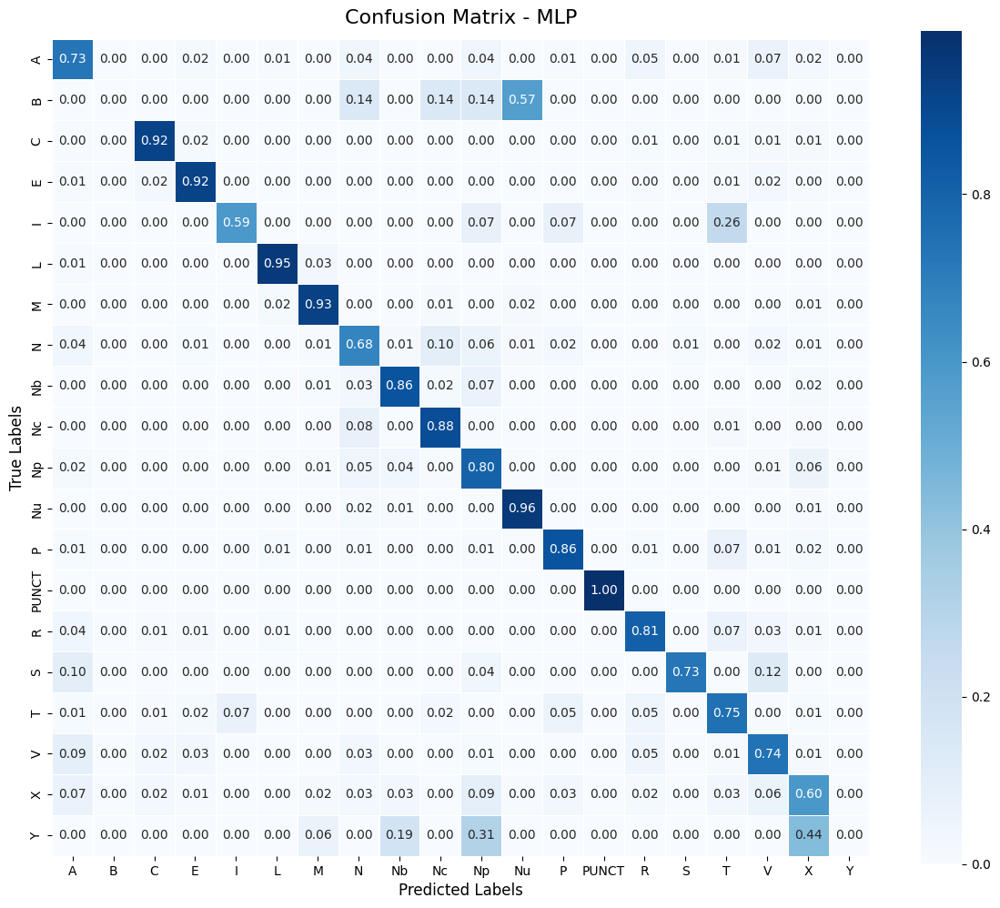

              precision    recall  f1-score   support

           A       0.58      0.73      0.65      4027
           B       0.00      0.00      0.00         7
           C       0.82      0.92      0.87      2367
           E       0.84      0.92      0.88      4061
           I       0.31      0.59      0.41        27
           L       0.85      0.95      0.90      1180
           M       0.91      0.93      0.92      2425
           N       0.92      0.68      0.78     15462
          Nb       0.20      0.86      0.33       121
          Nc       0.46      0.88      0.61      1634
          Np       0.61      0.80      0.70      2555
          Nu       0.51      0.96      0.67       310
           P       0.82      0.86      0.84      2779
       PUNCT       1.00      1.00      1.00      9632
           R       0.80      0.81      0.81      4746
           S       0.16      0.73      0.27        48
           T       0.29      0.75      0.41       422
           V       0.90    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1], weighted=True)

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train, X_test, y_train, y_test = train_test_split_by_ratio()
X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002
Decomposed data (By PCA)
Train shape: (130501, 64), Test shape: (87002, 64)


### Naive Bayes

Fitting
Predicting


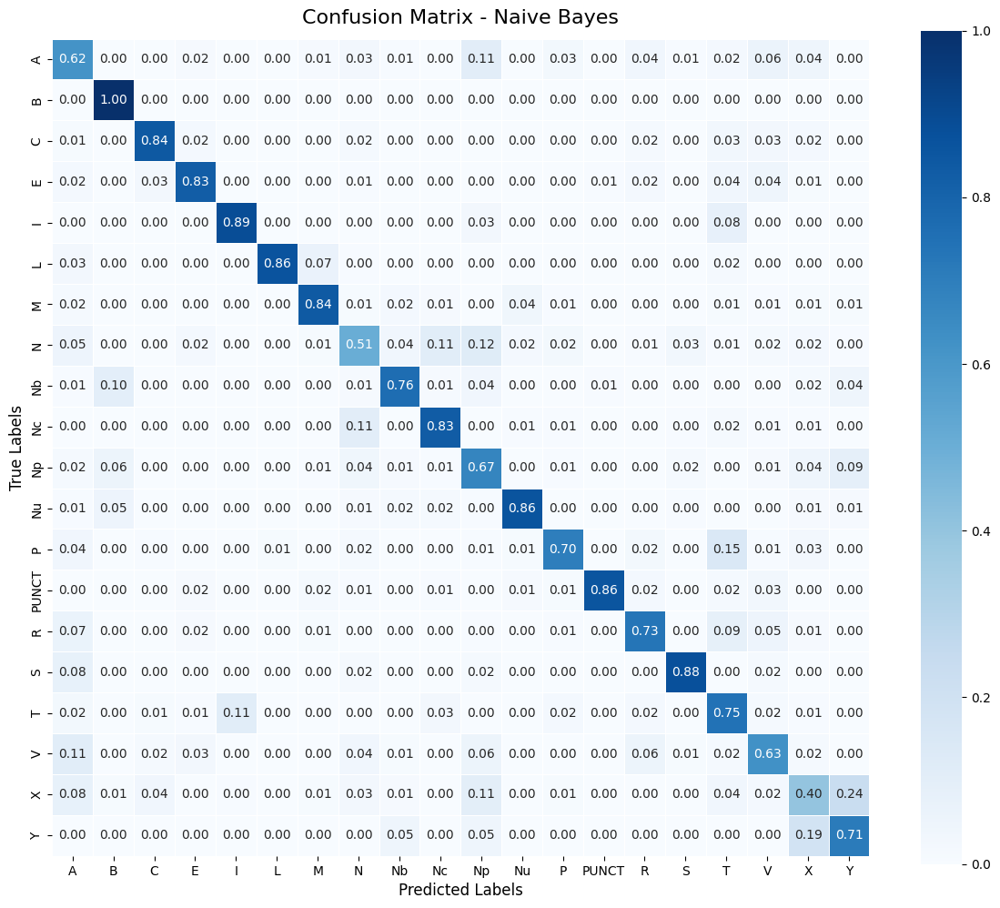

              precision    recall  f1-score   support

           A       0.46      0.62      0.53      5370
           B       0.03      1.00      0.06         9
           C       0.81      0.84      0.82      3156
           E       0.76      0.83      0.79      5415
           I       0.23      0.89      0.36        36
           L       0.94      0.86      0.90      1574
           M       0.79      0.84      0.81      3233
           N       0.87      0.51      0.64     20616
          Nb       0.10      0.76      0.18       161
          Nc       0.41      0.83      0.55      2179
          Np       0.35      0.67      0.46      3406
          Nu       0.30      0.86      0.45       413
           P       0.74      0.70      0.72      3705
       PUNCT       0.99      0.86      0.92     12843
           R       0.72      0.73      0.73      6328
           S       0.06      0.88      0.11        64
           T       0.15      0.75      0.25       563
           V       0.85    

In [ ]:
run_naive_bayes(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### Softmax Regression

Fitting
Predicting


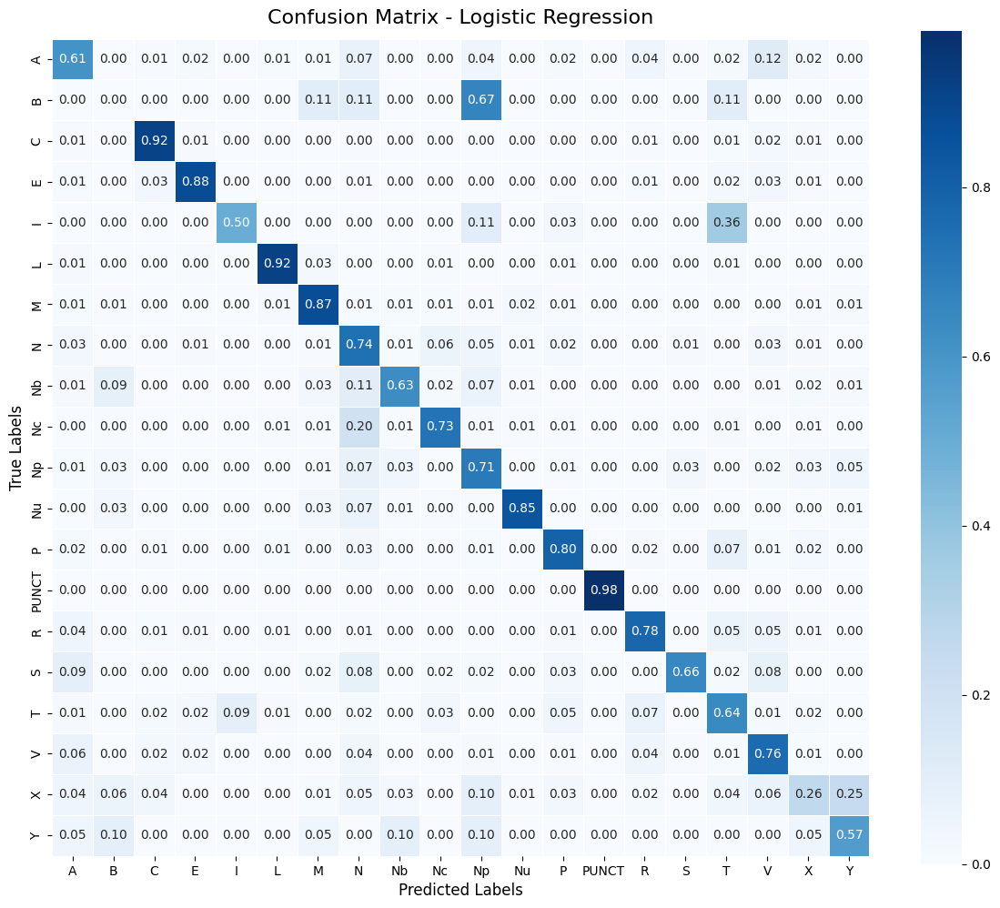

              precision    recall  f1-score   support

           A       0.60      0.61      0.60      5370
           B       0.00      0.00      0.00         9
           C       0.78      0.92      0.84      3156
           E       0.84      0.88      0.86      5415
           I       0.22      0.50      0.30        36
           L       0.88      0.92      0.90      1574
           M       0.89      0.87      0.88      3233
           N       0.88      0.74      0.80     20616
          Nb       0.18      0.63      0.28       161
          Nc       0.56      0.73      0.63      2179
          Np       0.60      0.71      0.65      3406
          Nu       0.55      0.85      0.66       413
           P       0.77      0.80      0.78      3705
       PUNCT       1.00      0.98      0.99     12843
           R       0.80      0.78      0.79      6328
           S       0.08      0.66      0.14        64
           T       0.23      0.64      0.34       563
           V       0.86    

In [ ]:
run_softmax_regression(X_train_pca, y_train, X_test_pca, y_test, weighted=True)

### MLP

Train samples: 130501, Test samples: 87002
Train batches: 4079, Test batches: 1360


Epoch 1/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 1: Train Loss=2.7821 | Test Loss=2.5306 | Test Acc=0.5232
New best model saved (test_acc=0.5232)


Epoch 2/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 2: Train Loss=2.2255 | Test Loss=1.9903 | Test Acc=0.6133
New best model saved (test_acc=0.6133)


Epoch 3/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 3: Train Loss=1.7438 | Test Loss=1.5883 | Test Acc=0.6724
New best model saved (test_acc=0.6724)


Epoch 4/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 4: Train Loss=1.4090 | Test Loss=1.3198 | Test Acc=0.7050
New best model saved (test_acc=0.7050)


Epoch 5/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 5: Train Loss=1.1995 | Test Loss=1.1455 | Test Acc=0.7291
New best model saved (test_acc=0.7291)


Epoch 6/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 6: Train Loss=1.0709 | Test Loss=1.0271 | Test Acc=0.7383
New best model saved (test_acc=0.7383)


Epoch 7/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 7: Train Loss=0.9776 | Test Loss=0.9435 | Test Acc=0.7494
New best model saved (test_acc=0.7494)


Epoch 8/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 8: Train Loss=0.9076 | Test Loss=0.8833 | Test Acc=0.7591
New best model saved (test_acc=0.7591)


Epoch 9/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 9: Train Loss=0.8627 | Test Loss=0.8340 | Test Acc=0.7629
New best model saved (test_acc=0.7629)


Epoch 10/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 10: Train Loss=0.8278 | Test Loss=0.7970 | Test Acc=0.7675
New best model saved (test_acc=0.7675)


Epoch 11/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 11: Train Loss=0.7970 | Test Loss=0.7686 | Test Acc=0.7755
New best model saved (test_acc=0.7755)


Epoch 12/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 12: Train Loss=0.7716 | Test Loss=0.7428 | Test Acc=0.7760
New best model saved (test_acc=0.7760)


Epoch 13/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 13: Train Loss=0.7502 | Test Loss=0.7206 | Test Acc=0.7785
New best model saved (test_acc=0.7785)


Epoch 14/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 14: Train Loss=0.7364 | Test Loss=0.7029 | Test Acc=0.7846
New best model saved (test_acc=0.7846)


Epoch 15/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 15: Train Loss=0.7134 | Test Loss=0.6872 | Test Acc=0.7858
New best model saved (test_acc=0.7858)


Epoch 16/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 16: Train Loss=0.7059 | Test Loss=0.6750 | Test Acc=0.7889
New best model saved (test_acc=0.7889)


Epoch 17/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 17: Train Loss=0.6917 | Test Loss=0.6620 | Test Acc=0.7906
New best model saved (test_acc=0.7906)


Epoch 18/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 18: Train Loss=0.6818 | Test Loss=0.6513 | Test Acc=0.7923
New best model saved (test_acc=0.7923)


Epoch 19/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 19: Train Loss=0.6682 | Test Loss=0.6416 | Test Acc=0.7973
New best model saved (test_acc=0.7973)


Epoch 20/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 20: Train Loss=0.6597 | Test Loss=0.6328 | Test Acc=0.7964


Epoch 21/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 21: Train Loss=0.6531 | Test Loss=0.6240 | Test Acc=0.7966


Epoch 22/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 22: Train Loss=0.6453 | Test Loss=0.6173 | Test Acc=0.7948


Epoch 23/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 23: Train Loss=0.6438 | Test Loss=0.6106 | Test Acc=0.8004
New best model saved (test_acc=0.8004)


Epoch 24/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 24: Train Loss=0.6382 | Test Loss=0.6047 | Test Acc=0.8002


Epoch 25/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 25: Train Loss=0.6277 | Test Loss=0.5986 | Test Acc=0.8016
New best model saved (test_acc=0.8016)


Epoch 26/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 26: Train Loss=0.6241 | Test Loss=0.5935 | Test Acc=0.8015


Epoch 27/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 27: Train Loss=0.6159 | Test Loss=0.5876 | Test Acc=0.8050
New best model saved (test_acc=0.8050)


Epoch 28/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 28: Train Loss=0.6086 | Test Loss=0.5823 | Test Acc=0.8045


Epoch 29/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 29: Train Loss=0.6034 | Test Loss=0.5784 | Test Acc=0.8066
New best model saved (test_acc=0.8066)


Epoch 30/30 - train:   0%|          | 0/4079 [00:00<?, ?it/s]


✅ Epoch 30: Train Loss=0.6000 | Test Loss=0.5735 | Test Acc=0.8071
New best model saved (test_acc=0.8071)


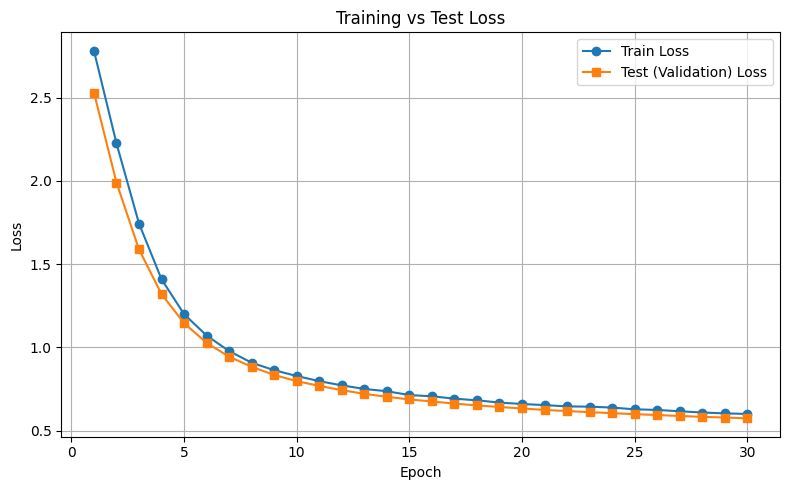

Loading best model for final test evaluation...
Generating predictions for Test set


Predicting Test Set:   0%|          | 0/1360 [00:00<?, ?it/s]

Best Test Accuracy (from validation): 0.8071


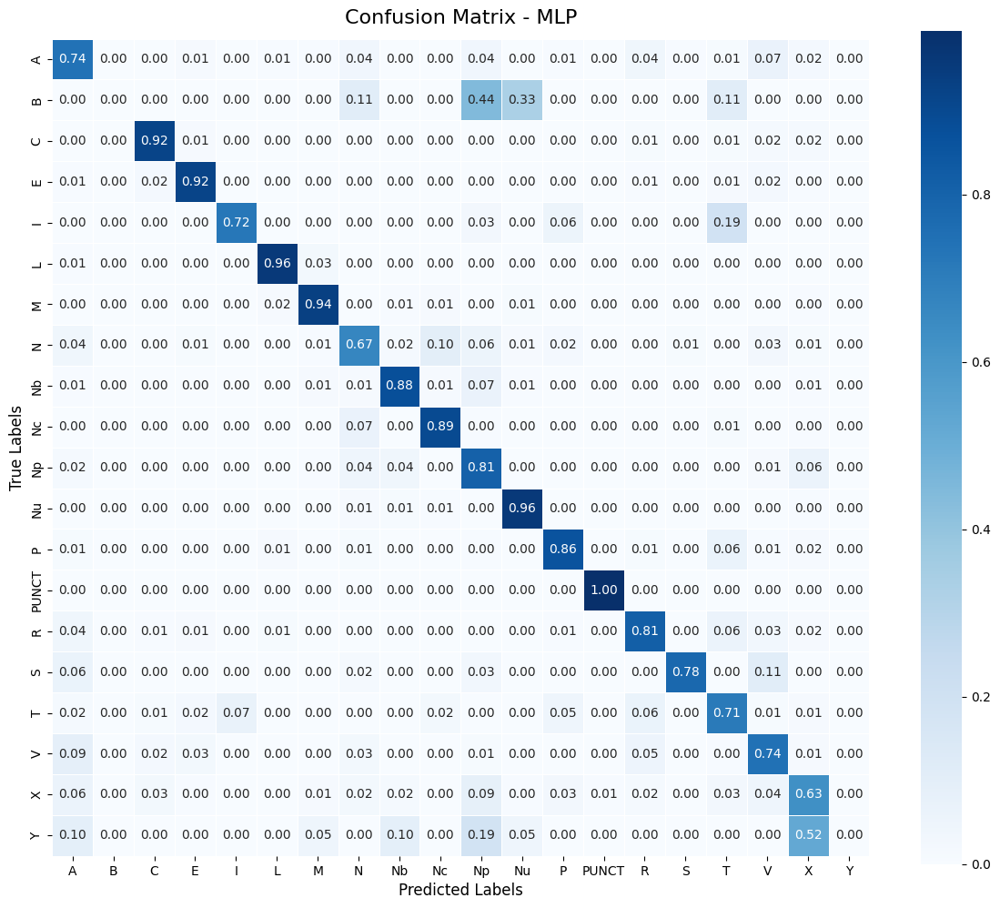

              precision    recall  f1-score   support

           A       0.58      0.74      0.65      5370
           B       0.00      0.00      0.00         9
           C       0.82      0.92      0.87      3156
           E       0.85      0.92      0.88      5415
           I       0.30      0.72      0.42        36
           L       0.85      0.96      0.90      1574
           M       0.91      0.94      0.92      3233
           N       0.93      0.67      0.78     20616
          Nb       0.18      0.88      0.30       161
          Nc       0.46      0.89      0.61      2179
          Np       0.62      0.81      0.70      3406
          Nu       0.53      0.96      0.68       413
           P       0.83      0.86      0.85      3705
       PUNCT       1.00      1.00      1.00     12843
           R       0.80      0.81      0.80      6328
           S       0.15      0.78      0.25        64
           T       0.30      0.71      0.42       563
           V       0.90    

In [ ]:
train_mlp(X_train_pca, y_train, X_test_pca, y_test, VALID_TAGS, input_dim=X_train_pca.shape[1], weighted=True)

# Find best dimension for Naive Bayes

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6
X_train, X_test, y_train, y_test = train_test_split_by_ratio()

sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002


In [ ]:
def find_best_nb_dim(start: int, end: int, step: int, keep_raw=False):
    global N_COMPONENTS_PCA_MODEL

    acc_scores = []
    macro_f1_scores = []
    weighted_f1_scores = []
    dims = []

    if keep_raw:
        nb_model = GaussianNB()
        nb_model.fit(X_train, y_train, sample_weight=sample_weights)
        y_pred = nb_model.predict(X_test)

        acc_scores.append(accuracy_score(y_test, y_pred))
        macro_f1_scores.append(f1_score(y_test, y_pred, average='macro', zero_division=0))
        weighted_f1_scores.append(f1_score(y_test, y_pred, average='weighted', zero_division=0))
        dims.append(768)

    search_range = range(start, end, step)
    pbar = tqdm(search_range, desc="Grid Search PCA Dimensions")

    for d in pbar:
        N_COMPONENTS_PCA_MODEL = d

        X_train_pca, X_test_pca = decomposition_pca(X_train, X_test)

        nb_model = GaussianNB()
        nb_model.fit(X_train_pca, y_train, sample_weight=sample_weights)

        y_pred = nb_model.predict(X_test_pca)

        acc = accuracy_score(y_test, y_pred)
        f1_m = f1_score(y_test, y_pred, average='macro', zero_division=0)
        f1_w = f1_score(y_test, y_pred, average='weighted', zero_division=0)

        acc_scores.append(acc)
        macro_f1_scores.append(f1_m)
        weighted_f1_scores.append(f1_w)
        dims.append(d)

        print(f"Dim: {d}, Accuracy: {acc:.2f}, F1 (Macro): {f1_m:.2f}, F1 (Weighted): {f1_w:.2f}")

    plt.figure(figsize=(12, 6))
    plt.plot(dims, acc_scores, label='Accuracy', marker='.', linestyle='-')
    plt.plot(dims, macro_f1_scores, label='Macro F1', marker='.', linestyle='--')
    plt.plot(dims, weighted_f1_scores, label='Weighted F1', marker='.', linestyle='-.')

    best_idx = np.argmax(macro_f1_scores)
    best_dim = dims[best_idx]
    best_val = macro_f1_scores[best_idx]

    plt.scatter(best_dim, best_val, color='red', s=100, zorder=5)
    plt.annotate(f"Best Macro F1: {best_val:.4f} @ {best_dim} dims",
                (best_dim, best_val), xytext=(best_dim, best_val + 0.05),
                arrowprops=dict(facecolor='black', shrink=0.05), ha='center')

    plt.gca().invert_xaxis()
    plt.title("Naive Bayes Performance vs. PCA Dimensions")
    plt.xlabel("Number of PCA Components")
    plt.ylabel("Score")
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

Grid Search PCA Dimensions:   0%|          | 0/25 [00:00<?, ?it/s]

Decomposed data (By PCA)
Train shape: (130501, 760), Test shape: (87002, 760)
Dim: 760, Accuracy: 0.74, F1 (Macro): 0.63, F1 (Weighted): 0.76
Decomposed data (By PCA)
Train shape: (130501, 730), Test shape: (87002, 730)
Dim: 730, Accuracy: 0.75, F1 (Macro): 0.64, F1 (Weighted): 0.76
Decomposed data (By PCA)
Train shape: (130501, 700), Test shape: (87002, 700)
Dim: 700, Accuracy: 0.76, F1 (Macro): 0.64, F1 (Weighted): 0.77
Decomposed data (By PCA)
Train shape: (130501, 670), Test shape: (87002, 670)
Dim: 670, Accuracy: 0.76, F1 (Macro): 0.64, F1 (Weighted): 0.77
Decomposed data (By PCA)
Train shape: (130501, 640), Test shape: (87002, 640)
Dim: 640, Accuracy: 0.77, F1 (Macro): 0.64, F1 (Weighted): 0.78
Decomposed data (By PCA)
Train shape: (130501, 610), Test shape: (87002, 610)
Dim: 610, Accuracy: 0.77, F1 (Macro): 0.65, F1 (Weighted): 0.78
Decomposed data (By PCA)
Train shape: (130501, 580), Test shape: (87002, 580)
Dim: 580, Accuracy: 0.78, F1 (Macro): 0.65, F1 (Weighted): 0.79
Decomp

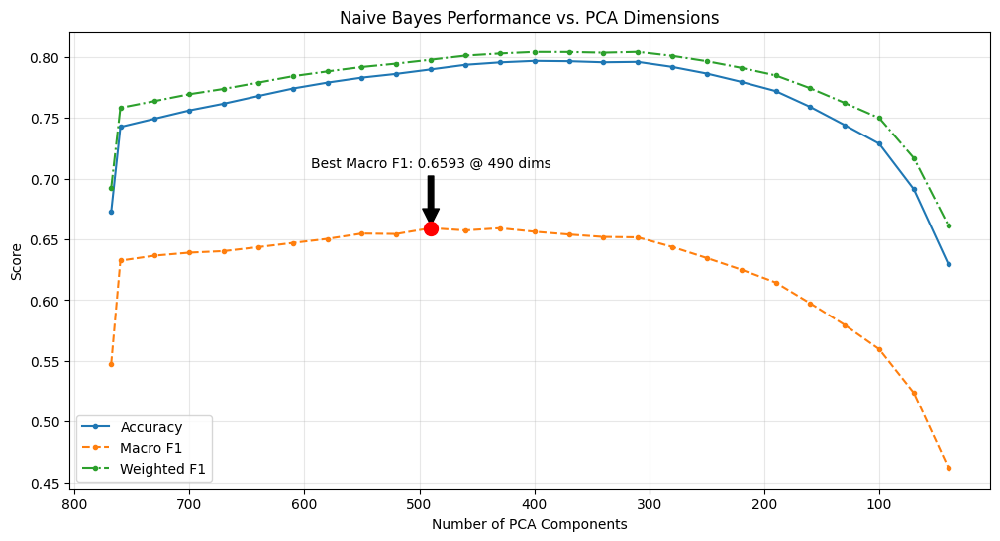

In [ ]:
find_best_nb_dim(760, 10, -30, keep_raw=True)

Grid Search PCA Dimensions:   0%|          | 0/20 [00:00<?, ?it/s]

Decomposed data (By PCA)
Train shape: (130501, 500), Test shape: (87002, 500)
Dim: 500, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (130501, 490), Test shape: (87002, 490)
Dim: 490, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (130501, 480), Test shape: (87002, 480)
Dim: 480, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (130501, 470), Test shape: (87002, 470)
Dim: 470, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (130501, 460), Test shape: (87002, 460)
Dim: 460, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (130501, 450), Test shape: (87002, 450)
Dim: 450, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (130501, 440), Test shape: (87002, 440)
Dim: 440, Accuracy: 0.79, F1 (Macro): 0.66, F1 (Weighted): 0.80
Decomp

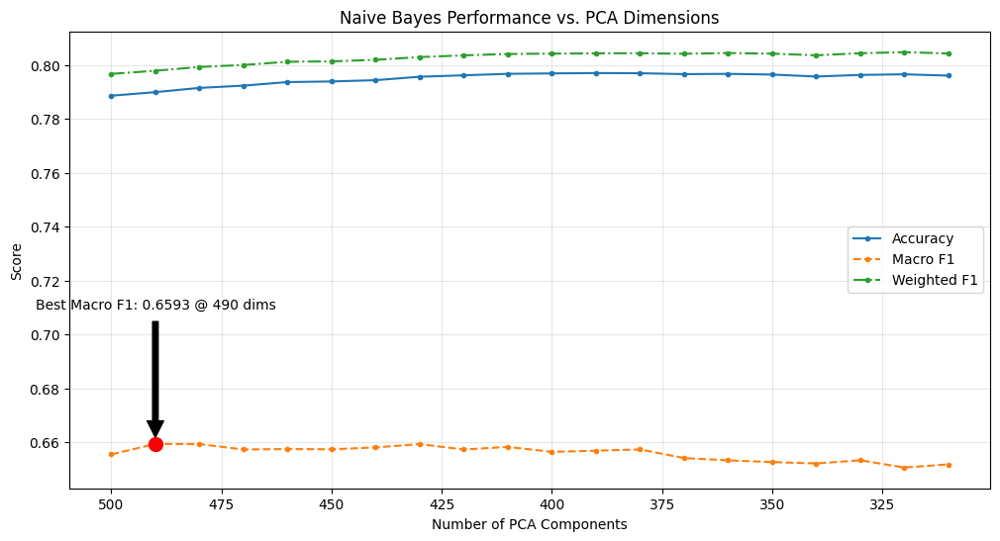

In [ ]:
find_best_nb_dim(500, 300, -10)

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7
X_train, X_test, y_train, y_test = train_test_split_by_ratio()

sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251


Grid Search PCA Dimensions:   0%|          | 0/20 [00:00<?, ?it/s]

Decomposed data (By PCA)
Train shape: (152252, 500), Test shape: (65251, 500)
Dim: 500, Accuracy: 0.79, F1 (Macro): 0.64, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (152252, 490), Test shape: (65251, 490)
Dim: 490, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (152252, 480), Test shape: (65251, 480)
Dim: 480, Accuracy: 0.79, F1 (Macro): 0.64, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (152252, 470), Test shape: (65251, 470)
Dim: 470, Accuracy: 0.79, F1 (Macro): 0.64, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (152252, 460), Test shape: (65251, 460)
Dim: 460, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (152252, 450), Test shape: (65251, 450)
Dim: 450, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (152252, 440), Test shape: (65251, 440)
Dim: 440, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomp

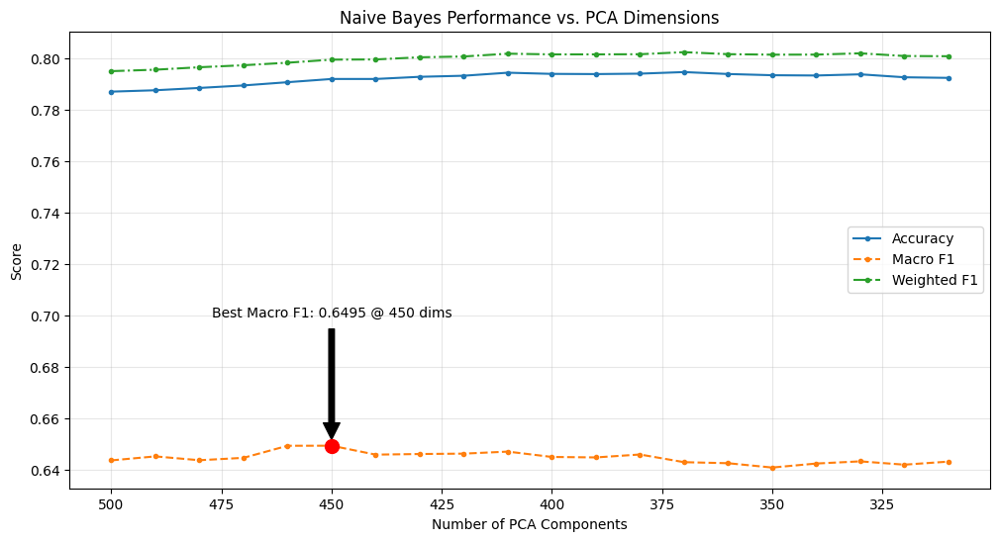

In [ ]:
find_best_nb_dim(500, 300, -10)

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8
X_train, X_test, y_train, y_test = train_test_split_by_ratio()

sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501


Grid Search PCA Dimensions:   0%|          | 0/20 [00:00<?, ?it/s]

Decomposed data (By PCA)
Train shape: (174002, 500), Test shape: (43501, 500)
Dim: 500, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (174002, 490), Test shape: (43501, 490)
Dim: 490, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (174002, 480), Test shape: (43501, 480)
Dim: 480, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (174002, 470), Test shape: (43501, 470)
Dim: 470, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (174002, 460), Test shape: (43501, 460)
Dim: 460, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (174002, 450), Test shape: (43501, 450)
Dim: 450, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomposed data (By PCA)
Train shape: (174002, 440), Test shape: (43501, 440)
Dim: 440, Accuracy: 0.79, F1 (Macro): 0.65, F1 (Weighted): 0.80
Decomp

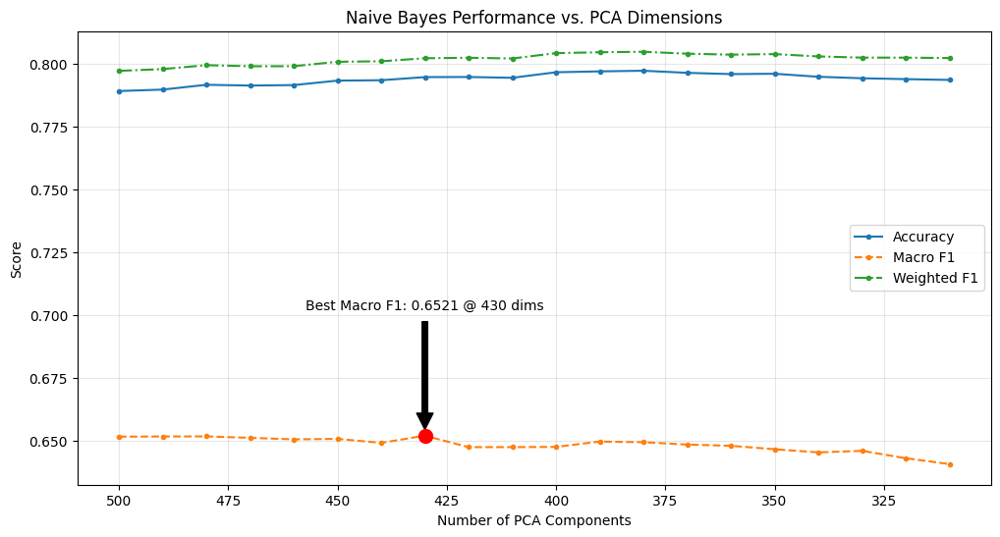

In [ ]:
find_best_nb_dim(500, 300, -10)

# Regression

In [ ]:
REGRESSION_TARGET_TAG = "N"
REG_EPOCHS = 30
REG_BATCH_SIZE = 32
REG_LR = 1e-4
KNN_NEIGHBORS = 20
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
class RegressionEvaluator:
    """
    Pure functional class for calculating regression metrics using Numpy.
    Ensures high performance and standard metric reporting.
    """
    @staticmethod
    def calculate_metrics(y_true: np.ndarray, y_pred: np.ndarray) -> Dict[str, float]:
        y_pred = np.clip(y_pred, 0.0, 1.0)

        mse = mean_squared_error(y_true, y_pred)
        rmse = np.sqrt(mse)
        r2 = r2_score(y_true, y_pred)
        return {"MSE": mse, "RMSE": rmse, "R2": r2}

In [ ]:
class SoftmaxTeacher:
    """
    Teacher Model: Standard Softmax Classifier.
    Responsibility: Learn the classification task and generate 'soft targets' (probabilities).
    """
    def __init__(self, random_state: int = 42):
        self.model = SGDClassifier(
            loss="log_loss",
            max_iter=1000,
            learning_rate="optimal",
            class_weight="balanced",
            random_state=random_state,
            n_jobs=-1
        )
        self.classes_: Optional[np.ndarray] = None

    def fit(self, X: np.ndarray, y: List[str]) -> 'SoftmaxTeacher':
        print(f"[Teacher] Training Softmax Classifier on {X.shape[0]} samples...")
        self.model.fit(X, y)
        self.classes_ = self.model.classes_
        return self

    def get_target_probs(self, X: np.ndarray, target_tag: str) -> np.ndarray:
        """Extracts the probability column for the specific target_tag."""
        if self.classes_ is None:
            raise RuntimeError("Teacher must be fitted before generating targets.")

        if target_tag not in self.classes_:
            raise ValueError(f"Target tag '{target_tag}' not found. Available: {self.classes_}")

        target_idx = np.where(self.classes_ == target_tag)[0][0]
        # predict_proba returns (N_samples, N_classes)
        probs = self.model.predict_proba(X)[:, target_idx]
        return probs.astype(np.float32)

## KNN

In [ ]:
def train_eval_knn_student(
    X_train: np.ndarray,
    y_train: np.ndarray,
    X_test: np.ndarray,
    y_test: np.ndarray,
    k: int = KNN_NEIGHBORS
) -> None:
    """
    Trains and evaluates a K-Nearest Neighbors Regressor.
    """
    knn = KNeighborsRegressor(n_neighbors=k, weights='distance', n_jobs=-1)

    knn.fit(X_train, y_train)

    y_pred = knn.predict(X_test)

    metrics = RegressionEvaluator.calculate_metrics(y_test, y_pred)
    return metrics

## MLP

In [ ]:
class MLPRegressor(nn.Module):
    """
    Parametric Student: Deep Neural Network for Regression.
    Output: Sigmoid activation to bound predictions in [0, 1].
    """
    def __init__(self, input_dim: int, hidden1: int = 256, hidden2: int = 128):
        super(MLPRegressor, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, hidden1),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden1, hidden2),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden2, 1),
            nn.Sigmoid()
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.net(x)

def train_eval_mlp_student(
    X_train: np.ndarray,
    y_train: np.ndarray,
    X_test: np.ndarray,
    y_test: np.ndarray,
    input_dim: int
) -> Dict[str, float]:
    """
    Trains and evaluates the MLP Student using PyTorch with tqdm progress tracking.
    """
    X_train_t = torch.tensor(X_train, dtype=torch.float32)
    y_train_t = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
    X_test_t = torch.tensor(X_test, dtype=torch.float32).to(DEVICE)

    dataset = TensorDataset(X_train_t, y_train_t)
    loader = DataLoader(dataset, batch_size=REG_BATCH_SIZE, shuffle=True, num_workers=0)

    model = MLPRegressor(input_dim).to(DEVICE)
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=REG_LR)

    best_mse = float('inf')
    best_state = None

    pbar = tqdm(range(1, REG_EPOCHS + 1), desc="Training", unit="epoch")

    for epoch in pbar:
        model.train()
        train_loss_accum = 0.0
        total_samples = 0

        for X_b, y_b in loader:
            X_b, y_b = X_b.to(DEVICE), y_b.to(DEVICE)

            optimizer.zero_grad()
            outputs = model(X_b)
            loss = criterion(outputs, y_b)
            loss.backward()
            optimizer.step()

            batch_size = X_b.size(0)
            train_loss_accum += loss.item() * batch_size
            total_samples += batch_size

        avg_train_loss = train_loss_accum / total_samples

        model.eval()
        with torch.no_grad():
            val_preds = model(X_test_t).cpu().numpy().flatten()

        val_mse = mean_squared_error(y_test, val_preds)

        if val_mse < best_mse:
            best_mse = val_mse
            best_state = model.state_dict()

        pbar.set_postfix({
            "Train Loss": f"{avg_train_loss:.5f}",
            "Val MSE": f"{val_mse:.5f}",
            "Best MSE": f"{best_mse:.5f}"
        })

        # tqdm.write(f"Epoch {epoch}: Train Loss={avg_train_loss:.5f} | Val MSE={val_mse:.5f}")

    print(f"\nBest Validation MSE: {best_mse:.6f}")

    if best_state is not None:
        model.load_state_dict(best_state)

    model.eval()
    with torch.no_grad():
        final_preds = model(X_test_t).cpu().numpy().flatten()

    metrics = RegressionEvaluator.calculate_metrics(y_test, final_preds)
    return metrics

# Run regression - 768D

## TRAIN/TEST = 4/1

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train41, X_test41, y_train41, y_test41 = train_test_split_by_ratio()

teacher = SoftmaxTeacher().fit(X_train41, y_train41)
y_train_probs41 = teacher.get_target_probs(X_train41, REGRESSION_TARGET_TAG)
y_test_probs41 = teacher.get_target_probs(X_test41, REGRESSION_TARGET_TAG)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501
[Teacher] Training Softmax Classifier on 174002 samples...


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train41, y_train_probs41, X_test41, y_test_probs41, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.01510662086888359, 'RMSE': np.float64(0.12290899425543922), 'R2': 0.8909086185181864}
K: 2, Metrics: {'MSE': 0.011860750613884865, 'RMSE': np.float64(0.10890707329592907), 'R2': 0.9143484382701933}
K: 3, Metrics: {'MSE': 0.011116594984082599, 'RMSE': np.float64(0.10543526442363864), 'R2': 0.9197223048944503}
K: 4, Metrics: {'MSE': 0.010871720452055708, 'RMSE': np.float64(0.10426754265856518), 'R2': 0.9214906488027529}
K: 5, Metrics: {'MSE': 0.010800179007638898, 'RMSE': np.float64(0.10392390970146811), 'R2': 0.9220072802236625}
K: 6, Metrics: {'MSE': 0.010841659721001724, 'RMSE': np.float64(0.10412329096317367), 'R2': 0.9217077302207282}
K: 7, Metrics: {'MSE': 0.010907308660789197, 'RMSE': np.float64(0.10443806136073762), 'R2': 0.9212336511002954}
K: 8, Metrics: {'MSE': 0.011091905167055504, 'RMSE': np.float64(0.10531811414498223), 'R2': 0.9199006006411561}
K: 9, Metrics: {'MSE': 0.011214383720308809, 'RMSE': np.float64(0.10589798732888557), 'R2': 0.91901613053

### MLP

In [ ]:
train_eval_mlp_student(X_train41, y_train_probs41, X_test41, y_test_probs41, input_dim=X_train41.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.001596


{'MSE': 0.0016283756121993065,
 'RMSE': np.float64(0.04035313633658859),
 'R2': 0.9882407784461975}

## TRAIN/TEST = 7/3

In [ ]:
TEST_RATIO = 0.3
TRAIN_RATIO = 0.7

X_train73, X_test73, y_train73, y_test73 = train_test_split_by_ratio()

teacher = SoftmaxTeacher().fit(X_train73, y_train73)
y_train_probs73 = teacher.get_target_probs(X_train73, REGRESSION_TARGET_TAG)
y_test_probs73 = teacher.get_target_probs(X_test73, REGRESSION_TARGET_TAG)

Total unique labels: 20
Splitting Train/Test
Train samples: 152252, Test samples: 65251
[Teacher] Training Softmax Classifier on 152252 samples...


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train73, y_train_probs73, X_test73, y_test_probs73, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.015614032405632665, 'RMSE': np.float64(0.12495612192138753), 'R2': 0.886484063600013}
K: 2, Metrics: {'MSE': 0.01252011715936253, 'RMSE': np.float64(0.11189332937830802), 'R2': 0.908977208048455}
K: 3, Metrics: {'MSE': 0.01179802893000627, 'RMSE': np.float64(0.1086187319480681), 'R2': 0.9142268783059098}
K: 4, Metrics: {'MSE': 0.011462577378600392, 'RMSE': np.float64(0.10706342689546414), 'R2': 0.9166656523512954}
K: 5, Metrics: {'MSE': 0.011371140344037946, 'RMSE': np.float64(0.10663554915710777), 'R2': 0.917330410840989}
K: 6, Metrics: {'MSE': 0.011437177947293322, 'RMSE': np.float64(0.10694474249486657), 'R2': 0.9168503093414916}
K: 7, Metrics: {'MSE': 0.011538967443945987, 'RMSE': np.float64(0.10741958594197795), 'R2': 0.9161102871788603}
K: 8, Metrics: {'MSE': 0.01165215033674553, 'RMSE': np.float64(0.10794512650761742), 'R2': 0.9152874336246455}
K: 9, Metrics: {'MSE': 0.01177405145676699, 'RMSE': np.float64(0.10850830132652059), 'R2': 0.9144011974860263}


### MLP

In [ ]:
train_eval_mlp_student(X_train73, y_train_probs73, X_test73, y_test_probs73, input_dim=X_train73.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.001917


{'MSE': 0.002160261617973447,
 'RMSE': np.float64(0.04647861463053139),
 'R2': 0.9842946529388428}

## TRAIN/TEST = 6/4

In [ ]:
TEST_RATIO = 0.4
TRAIN_RATIO = 0.6

X_train64, X_test64, y_train64, y_test64 = train_test_split_by_ratio()

teacher = SoftmaxTeacher().fit(X_train64, y_train64)
y_train_probs64 = teacher.get_target_probs(X_train64, REGRESSION_TARGET_TAG)
y_test_probs64 = teacher.get_target_probs(X_test64, REGRESSION_TARGET_TAG)

Total unique labels: 20
Splitting Train/Test
Train samples: 130501, Test samples: 87002
[Teacher] Training Softmax Classifier on 130501 samples...


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train64, y_train_probs64, X_test64, y_test_probs64, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.016032445164208556, 'RMSE': np.float64(0.12661929222756127), 'R2': 0.8835126407954657}
K: 2, Metrics: {'MSE': 0.012816389245520525, 'RMSE': np.float64(0.11320949273590322), 'R2': 0.9068796230109059}
K: 3, Metrics: {'MSE': 0.012023287327987497, 'RMSE': np.float64(0.10965075160703412), 'R2': 0.9126420845074042}
K: 4, Metrics: {'MSE': 0.011675261659766277, 'RMSE': np.float64(0.10805212473508458), 'R2': 0.9151707437737393}
K: 5, Metrics: {'MSE': 0.011563350670110828, 'RMSE': np.float64(0.10753302130095121), 'R2': 0.9159838583995751}
K: 6, Metrics: {'MSE': 0.011610841716055397, 'RMSE': np.float64(0.10775361579109723), 'R2': 0.9156388014559035}
K: 7, Metrics: {'MSE': 0.011695666404832094, 'RMSE': np.float64(0.1081465043578945), 'R2': 0.9150224884799514}
K: 8, Metrics: {'MSE': 0.01183090420593994, 'RMSE': np.float64(0.10876996003465267), 'R2': 0.9140398876256007}
K: 9, Metrics: {'MSE': 0.012003006080560527, 'RMSE': np.float64(0.10955823145962391), 'R2': 0.912789442501

### MLP

In [ ]:
train_eval_mlp_student(X_train64, y_train_probs64, X_test64, y_test_probs64, input_dim=X_train64.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.002011


{'MSE': 0.002026461297646165,
 'RMSE': np.float64(0.045016233712363865),
 'R2': 0.98520827293396}

# Run regression - 256D

In [ ]:
N_COMPONENTS_PCA_MODEL = 256

## TRAIN/TEST = 4/1

In [ ]:
X_train_pca, X_test_pca = decomposition_pca(X_train41, X_test41)

Decomposed data (By PCA)
Train shape: (174002, 256), Test shape: (43501, 256)


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train_pca, y_train_probs41, X_test_pca, y_test_probs41, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.0148238268832235, 'RMSE': np.float64(0.12175313911034696), 'R2': 0.8935262488903832}
K: 2, Metrics: {'MSE': 0.011634458087779392, 'RMSE': np.float64(0.10786314517841296), 'R2': 0.9164342376302685}
K: 3, Metrics: {'MSE': 0.01098333756248565, 'RMSE': np.float64(0.10480141965873196), 'R2': 0.9211109817192695}
K: 4, Metrics: {'MSE': 0.010838048876086552, 'RMSE': np.float64(0.10410595024342534), 'R2': 0.9221545335332891}
K: 5, Metrics: {'MSE': 0.010750342118921147, 'RMSE': np.float64(0.10368385659745276), 'R2': 0.922784496869115}
K: 6, Metrics: {'MSE': 0.010808360355181701, 'RMSE': np.float64(0.10396326445038989), 'R2': 0.922367774568181}
K: 7, Metrics: {'MSE': 0.010864831682531276, 'RMSE': np.float64(0.10423450332078758), 'R2': 0.9219621631089799}
K: 8, Metrics: {'MSE': 0.010999942833023607, 'RMSE': np.float64(0.10488061228379442), 'R2': 0.9209917125550858}
K: 9, Metrics: {'MSE': 0.011139571221195745, 'RMSE': np.float64(0.105544167158568), 'R2': 0.9199888164495665}

### MLP

In [ ]:
train_eval_mlp_student(X_train_pca, y_train_probs41, X_test_pca, y_test_probs41, input_dim=X_test_pca.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.003889


{'MSE': 0.00394678208976984,
 'RMSE': np.float64(0.0628234199146293),
 'R2': 0.9716517925262451}

## TRAIN/TEST = 7/3

In [ ]:
X_train_pca, X_test_pca = decomposition_pca(X_train73, X_test73)

Decomposed data (By PCA)
Train shape: (152252, 256), Test shape: (65251, 256)


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train_pca, y_train_probs73, X_test_pca, y_test_probs73, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.015358507223406507, 'RMSE': np.float64(0.12392944453763402), 'R2': 0.8875678868890773}
K: 2, Metrics: {'MSE': 0.012280329429977423, 'RMSE': np.float64(0.11081664780157097), 'R2': 0.9101017196901525}
K: 3, Metrics: {'MSE': 0.011569704894523134, 'RMSE': np.float64(0.10756256269968252), 'R2': 0.9153038540504392}
K: 4, Metrics: {'MSE': 0.011355059339813157, 'RMSE': np.float64(0.10656012077608189), 'R2': 0.9168751690835258}
K: 5, Metrics: {'MSE': 0.011261513769384432, 'RMSE': np.float64(0.10612027972722476), 'R2': 0.917559970412358}
K: 6, Metrics: {'MSE': 0.011258277464576104, 'RMSE': np.float64(0.10610503034529561), 'R2': 0.9175836618156292}
K: 7, Metrics: {'MSE': 0.011327769863531342, 'RMSE': np.float64(0.10643199642744348), 'R2': 0.9170749419806847}
K: 8, Metrics: {'MSE': 0.01143430719694298, 'RMSE': np.float64(0.10693132000000272), 'R2': 0.9162950343147613}
K: 9, Metrics: {'MSE': 0.011570931110058046, 'RMSE': np.float64(0.10756826255944663), 'R2': 0.915294877526

### MLP

In [ ]:
train_eval_mlp_student(X_train_pca, y_train_probs73, X_test_pca, y_test_probs73, input_dim=X_test_pca.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.004230


{'MSE': 0.004230057820677757,
 'RMSE': np.float64(0.06503889467601488),
 'R2': 0.9690338373184204}

## TRAIN/TEST = 6/4

In [ ]:
X_train_pca, X_test_pca = decomposition_pca(X_train64, X_test64)

Decomposed data (By PCA)
Train shape: (130501, 256), Test shape: (87002, 256)


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train_pca, y_train_probs64, X_test_pca, y_test_probs64, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.015647967373277085, 'RMSE': np.float64(0.12509183575788263), 'R2': 0.886306151210108}
K: 2, Metrics: {'MSE': 0.01258936826969798, 'RMSE': np.float64(0.11220235411834271), 'R2': 0.9085290952958098}
K: 3, Metrics: {'MSE': 0.011834940570554547, 'RMSE': np.float64(0.10878851304505704), 'R2': 0.9140105605048823}
K: 4, Metrics: {'MSE': 0.011542708818524842, 'RMSE': np.float64(0.10743699929970514), 'R2': 0.9161338364444532}
K: 5, Metrics: {'MSE': 0.011423720525467876, 'RMSE': np.float64(0.10688180633516574), 'R2': 0.9169983728200651}
K: 6, Metrics: {'MSE': 0.01140813744642763, 'RMSE': np.float64(0.10680888280675736), 'R2': 0.9171115952079842}
K: 7, Metrics: {'MSE': 0.011521172413894205, 'RMSE': np.float64(0.10733672444179673), 'R2': 0.9162903140669548}
K: 8, Metrics: {'MSE': 0.011698785496411002, 'RMSE': np.float64(0.10816092407339631), 'R2': 0.9149998260140939}
K: 9, Metrics: {'MSE': 0.0118368883240495, 'RMSE': np.float64(0.10879746469495279), 'R2': 0.913996408661000

### MLP

In [ ]:
train_eval_mlp_student(X_train_pca, y_train_probs64, X_test_pca, y_test_probs64, input_dim=X_test_pca.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.004332


{'MSE': 0.004331564996391535,
 'RMSE': np.float64(0.06581462600662208),
 'R2': 0.9685280323028564}

# Run regression - 64D

In [ ]:
N_COMPONENTS_PCA_MODEL = 64

## TRAIN/TEST = 4/1

In [ ]:
X_train_pca, X_test_pca = decomposition_pca(X_train41, X_test41)

Decomposed data (By PCA)
Train shape: (174002, 64), Test shape: (43501, 64)


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train_pca, y_train_probs41, X_test_pca, y_test_probs41, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.015265608828347042, 'RMSE': np.float64(0.12355407248790726), 'R2': 0.8903531019533368}
K: 2, Metrics: {'MSE': 0.012120608677226388, 'RMSE': np.float64(0.11009363595243091), 'R2': 0.9129424080730068}
K: 3, Metrics: {'MSE': 0.011491277947574608, 'RMSE': np.float64(0.1071973784547673), 'R2': 0.9174626445815975}
K: 4, Metrics: {'MSE': 0.011210660061983829, 'RMSE': np.float64(0.10588040452314029), 'R2': 0.9194782131080429}
K: 5, Metrics: {'MSE': 0.011258075662674385, 'RMSE': np.float64(0.10610407938752583), 'R2': 0.9191376453918647}
K: 6, Metrics: {'MSE': 0.011237894137522667, 'RMSE': np.float64(0.10600893423444398), 'R2': 0.9192826013943156}
K: 7, Metrics: {'MSE': 0.01135125153233525, 'RMSE': np.float64(0.10654225233368803), 'R2': 0.9184683995598778}
K: 8, Metrics: {'MSE': 0.011474244806192207, 'RMSE': np.float64(0.10711790142731609), 'R2': 0.9175849869747226}
K: 9, Metrics: {'MSE': 0.011576949062221887, 'RMSE': np.float64(0.1075962316357868), 'R2': 0.9168473024698

### MLP

In [ ]:
train_eval_mlp_student(X_train_pca, y_train_probs41, X_test_pca, y_test_probs41, input_dim=X_test_pca.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.008758


{'MSE': 0.008901767432689667,
 'RMSE': np.float64(0.0943491782300708),
 'R2': 0.9360620975494385}

## TRAIN/TEST = 7/3

In [ ]:
X_train_pca, X_test_pca = decomposition_pca(X_train73, X_test73)

Decomposed data (By PCA)
Train shape: (152252, 64), Test shape: (65251, 64)


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train_pca, y_train_probs73, X_test_pca, y_test_probs73, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.016061060856692372, 'RMSE': np.float64(0.1267322407940946), 'R2': 0.8824248356527107}
K: 2, Metrics: {'MSE': 0.012742101939170913, 'RMSE': np.float64(0.11288091928741063), 'R2': 0.9067213091964794}
K: 3, Metrics: {'MSE': 0.011969174693956895, 'RMSE': np.float64(0.1094037234007915), 'R2': 0.9123795311965953}
K: 4, Metrics: {'MSE': 0.011762987749520617, 'RMSE': np.float64(0.1084573084191223), 'R2': 0.9138889248845135}
K: 5, Metrics: {'MSE': 0.011657917411681084, 'RMSE': np.float64(0.10797183619667253), 'R2': 0.9146580933939747}
K: 6, Metrics: {'MSE': 0.0116520903444342, 'RMSE': np.float64(0.10794484862388849), 'R2': 0.9147007505008325}
K: 7, Metrics: {'MSE': 0.011760669021571345, 'RMSE': np.float64(0.10844661830399022), 'R2': 0.9139058991567701}
K: 8, Metrics: {'MSE': 0.011882501584999, 'RMSE': np.float64(0.10900688778696051), 'R2': 0.9130140225991958}
K: 9, Metrics: {'MSE': 0.01203007745428877, 'RMSE': np.float64(0.10968170975276037), 'R2': 0.9119336919012264}


### MLP

In [ ]:
train_eval_mlp_student(X_train_pca, y_train_probs73, X_test_pca, y_test_probs73, input_dim=X_test_pca.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.009096


{'MSE': 0.009096072986721992,
 'RMSE': np.float64(0.09537333477823869),
 'R2': 0.9334120750427246}

## TRAIN/TEST = 6/4

In [ ]:
X_train_pca, X_test_pca = decomposition_pca(X_train64, X_test64)

Decomposed data (By PCA)
Train shape: (130501, 64), Test shape: (87002, 64)


### KNN

In [ ]:
for k in range(1, 10):
    metrics = train_eval_knn_student(X_train_pca, y_train_probs64, X_test_pca, y_test_probs64, k=k)
    print(f"K: {k}, Metrics: {metrics}")

K: 1, Metrics: {'MSE': 0.016697461419384663, 'RMSE': np.float64(0.12921865739661847), 'R2': 0.8786808146703721}
K: 2, Metrics: {'MSE': 0.013366045745673332, 'RMSE': np.float64(0.1156116159634201), 'R2': 0.902885969297039}
K: 3, Metrics: {'MSE': 0.012457376812315226, 'RMSE': np.float64(0.1116126194133765), 'R2': 0.9094881091050321}
K: 4, Metrics: {'MSE': 0.01208687419200756, 'RMSE': np.float64(0.1099403210474099), 'R2': 0.912180079754297}
K: 5, Metrics: {'MSE': 0.011989512271187532, 'RMSE': np.float64(0.10949663132346826), 'R2': 0.9128874848274}
K: 6, Metrics: {'MSE': 0.012021037979574769, 'RMSE': np.float64(0.10964049425086868), 'R2': 0.9126584276574258}
K: 7, Metrics: {'MSE': 0.012114406613417839, 'RMSE': np.float64(0.11006546512606867), 'R2': 0.9119800367147145}
K: 8, Metrics: {'MSE': 0.012232714963406074, 'RMSE': np.float64(0.11060160470538424), 'R2': 0.9111204406193701}
K: 9, Metrics: {'MSE': 0.01234329846689984, 'RMSE': np.float64(0.11110039814014998), 'R2': 0.9103169711447119}


### MLP

In [ ]:

train_eval_mlp_student(X_train_pca, y_train_probs64, X_test_pca, y_test_probs64, input_dim=X_test_pca.shape[1])

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]


Best Validation MSE: 0.009548


{'MSE': 0.009553072042763233,
 'RMSE': np.float64(0.09773981810277341),
 'R2': 0.9305899739265442}

# Visualize scatter

In [ ]:
def _sort_regression_data(
    y_true: np.ndarray,
    y_pred: np.ndarray
) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
    sort_idxs = np.argsort(y_true)

    y_true_sorted = y_true[sort_idxs]
    y_pred_sorted = y_pred[sort_idxs]

    errors_sorted = np.abs(y_true_sorted - y_pred_sorted)

    return y_true_sorted, y_pred_sorted, errors_sorted

def plot_sorted_regression_scatter(
    y_true: np.ndarray,
    y_pred: np.ndarray,
    title: str = "",
    figsize: Tuple[int, int] = (14, 8)
) -> None:
    if not isinstance(y_true, np.ndarray):
        y_true = np.asarray(y_true)

    if not isinstance(y_pred, np.ndarray):
        y_pred = np.asarray(y_pred)
    if y_true.shape != y_pred.shape:
        raise ValueError(f"Shape mismatch: y_true {y_true.shape} vs y_pred {y_pred.shape}")

    y_true_sorted, y_pred_sorted, errors = _sort_regression_data(y_true, y_pred)

    fig, ax = plt.subplots(figsize=figsize)

    ax.plot(
        range(len(y_true_sorted)),
        y_true_sorted,
        color='black',
        linewidth=2.5,
        linestyle='-',
        label='Ground Truth',
        zorder=10
    )

    norm = Normalize(vmin=np.min(errors), vmax=np.max(errors))
    cmap = plt.get_cmap('coolwarm')

    scatter = ax.scatter(
        range(len(y_pred_sorted)),
        y_pred_sorted,
        c=errors,
        cmap=cmap,
        s=15,
        alpha=0.7,
        label='Prediction',
        zorder=5
    )

    cbar = plt.colorbar(ScalarMappable(norm=norm, cmap=cmap), ax=ax)
    cbar.set_label(f'Absolute Error', rotation=270, labelpad=15)

    mae = np.mean(errors)
    rmse = np.sqrt(np.mean(errors**2))

    ax.set_ylabel(f"Target Value", fontsize=12)

    ax.grid(True, linestyle='--', alpha=0.4)
    ax.legend(loc='upper left', frameon=True, fontsize=10)

    plt.tight_layout()
    plt.show()

In [ ]:
TEST_RATIO = 0.2
TRAIN_RATIO = 0.8

X_train41, X_test41, y_train41, y_test41 = train_test_split_by_ratio()

teacher = SoftmaxTeacher().fit(X_train41, y_train41)
y_train_probs41 = teacher.get_target_probs(X_train41, REGRESSION_TARGET_TAG)
y_test_probs41 = teacher.get_target_probs(X_test41, REGRESSION_TARGET_TAG)

Total unique labels: 20
Splitting Train/Test
Train samples: 174002, Test samples: 43501
[Teacher] Training Softmax Classifier on 174002 samples...


## KNN

In [ ]:
knn = KNeighborsRegressor(n_neighbors=5, weights='distance', n_jobs=-1)
knn.fit(X_train41, y_train_probs41)
y_pred = knn.predict(X_test41)

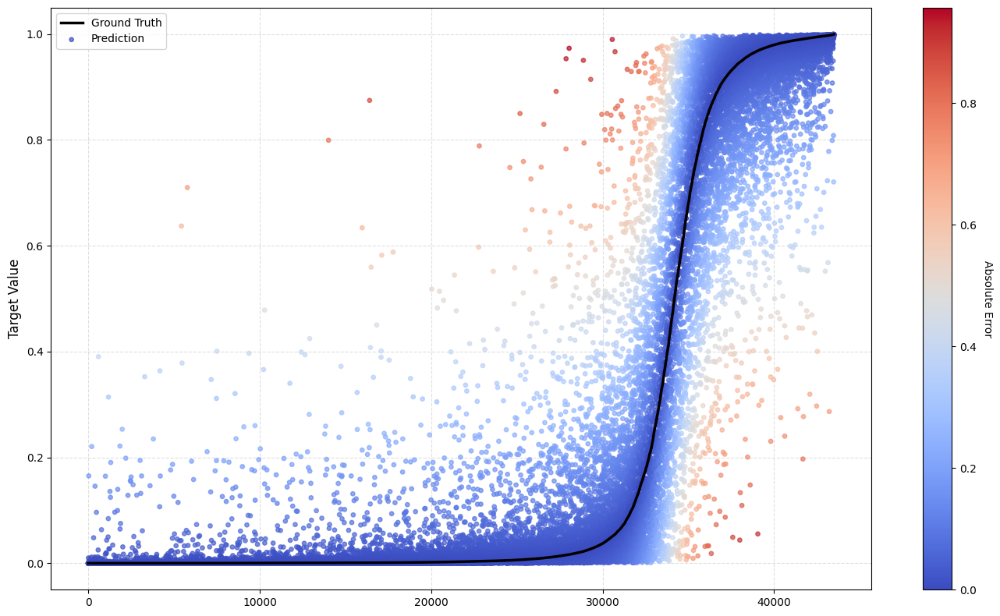

In [ ]:
plot_sorted_regression_scatter(y_test_probs41, y_pred)

## MLP

In [ ]:
X_train_t = torch.tensor(X_train41, dtype=torch.float32)
y_train_t = torch.tensor(y_train_probs41, dtype=torch.float32).unsqueeze(1)
X_test_t = torch.tensor(X_test41, dtype=torch.float32).to(DEVICE)

dataset = TensorDataset(X_train_t, y_train_t)
loader = DataLoader(dataset, batch_size=REG_BATCH_SIZE, shuffle=True, num_workers=0)

model = MLPRegressor(768).to(DEVICE)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=REG_LR)

best_mse = float('inf')
best_state = None

pbar = tqdm(range(1, REG_EPOCHS + 1), desc="Training", unit="epoch")

for epoch in pbar:
    model.train()
    train_loss_accum = 0.0
    total_samples = 0

    for X_b, y_b in loader:
        X_b, y_b = X_b.to(DEVICE), y_b.to(DEVICE)

        optimizer.zero_grad()
        outputs = model(X_b)
        loss = criterion(outputs, y_b)
        loss.backward()
        optimizer.step()

        batch_size = X_b.size(0)
        train_loss_accum += loss.item() * batch_size
        total_samples += batch_size

    avg_train_loss = train_loss_accum / total_samples

    model.eval()
    with torch.no_grad():
        val_preds = model(X_test_t).cpu().numpy().flatten()

    val_mse = mean_squared_error(y_test_probs41, val_preds)

    if val_mse < best_mse:
        best_mse = val_mse
        best_state = model.state_dict()

    pbar.set_postfix({
        "Train Loss": f"{avg_train_loss:.5f}",
        "Val MSE": f"{val_mse:.5f}",
        "Best MSE": f"{best_mse:.5f}"
    })

    # tqdm.write(f"Epoch {epoch}: Train Loss={avg_train_loss:.5f} | Val MSE={val_mse:.5f}")

if best_state is not None:
    model.load_state_dict(best_state)

model.eval()
with torch.no_grad():
    final_preds = model(X_test_t).cpu().numpy().flatten()

Training:   0%|          | 0/30 [00:00<?, ?epoch/s]

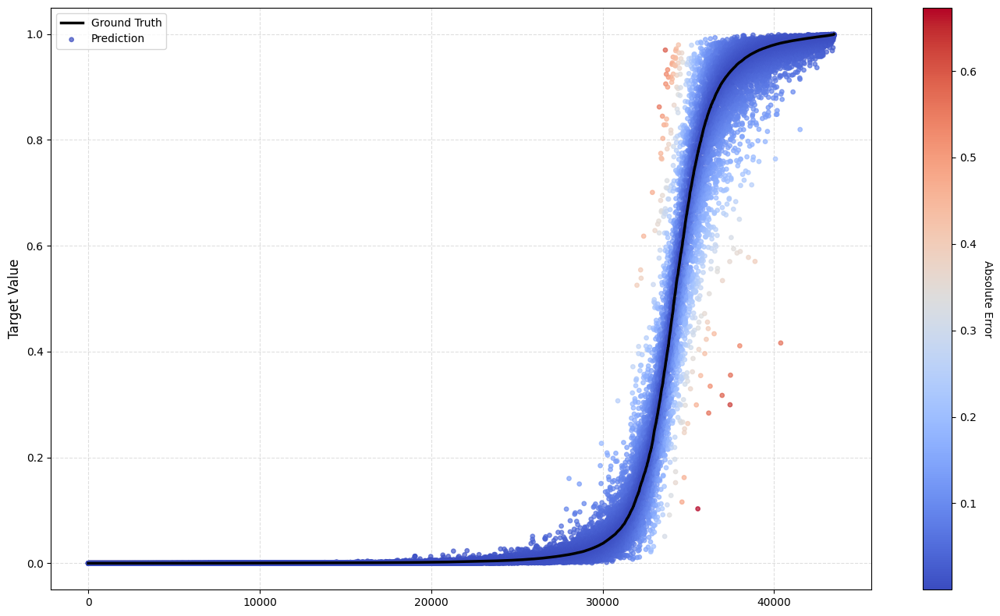

In [ ]:
plot_sorted_regression_scatter(y_test_probs41, final_preds)